In [ ]:
import tensorflow as tf
from matplotlib import pyplot as plt

import os
import time

import PIL
from PIL import Image
from IPython import display

Mounting drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
dataset = tf.keras.utils.image_dataset_from_directory(
    'drive/MyDrive/Morula',
    label_mode=None,
    image_size=(128, 128),
    batch_size=32,
    smart_resize=True,
)

Found 1478 files belonging to 1 classes.


In [ ]:
# Converting image in range [-1, 1]

dataset = dataset.map(lambda x: 2 * (x / 255.) - 1)

(32, 128, 128, 3)


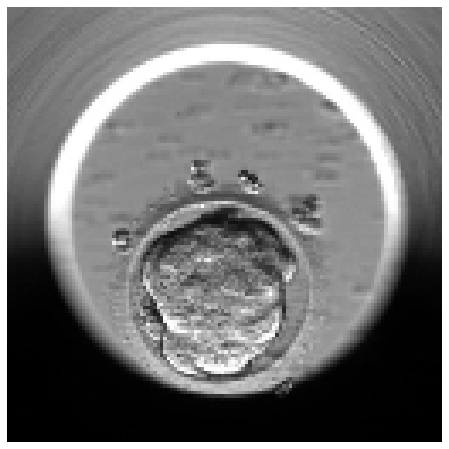

In [ ]:
for x in dataset:
  print(x.shape)
  plt.figure(figsize = (8, 8))
  plt.axis("off")
  plt.imshow(((x.numpy() + 1) / 2 * 255).astype("int32")[0])
  break

# DCGAN

In [ ]:
def make_generator_model():
    model = tf.keras.Sequential(
        [
            tf.keras.Input(shape=(latent_dim, )),
         
            tf.keras.layers.Dense(8 * 8 * 1024, use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
         
            tf.keras.layers.Reshape((8, 8, 1024)),
         
            tf.keras.layers.Conv2DTranspose(512, 4, strides=2, padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(256, 4, strides=2, padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),
            
            tf.keras.layers.Conv2DTranspose(128, 4, strides=2, padding='same', use_bias=False),
            tf.keras.layers.BatchNormalization(),
            tf.keras.layers.LeakyReLU(),

            tf.keras.layers.Conv2DTranspose(3, 4, strides=2, padding='same', use_bias=False, activation='tanh'),
        ]
    )

    return model

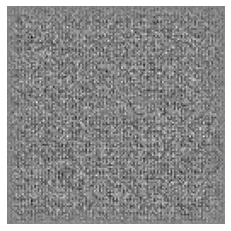

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 65536)             8388608   
                                                                 
 batch_normalization_20 (Bat  (None, 65536)            262144    
 chNormalization)                                                
                                                                 
 leaky_re_lu_22 (LeakyReLU)  (None, 65536)             0         
                                                                 
 reshape_5 (Reshape)         (None, 8, 8, 1024)        0         
                                                                 
 conv2d_transpose_20 (Conv2D  (None, 16, 16, 512)      8388608   
 Transpose)                                                      
                                                                 
 batch_normalization_21 (Bat  (None, 16, 16, 512)     

In [ ]:
latent_dim = 128
generator = make_generator_model()

noise = tf.random.normal([1, 128])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')
plt.axis('off')
plt.show()

generator.summary()

In [ ]:
def make_discriminator_model():
    model = tf.keras.Sequential(
        [
            tf.keras.Input(shape=(128, 128, 3)),
            tf.keras.layers.Conv2D(64, 4, strides=2, padding='same'),
            tf.keras.layers.LeakyReLU(),
            tf.keras.layers.Dropout(0.3),

            tf.keras.layers.Conv2D(128, 4, strides=2, padding='same'),
            tf.keras.layers.LeakyReLU(),
            tf.keras.layers.Dropout(0.3),

            tf.keras.layers.Flatten(),
            tf.keras.layers.Dense(1),
        ]
    )

    return model

In [ ]:
discriminator = make_discriminator_model()
decision = discriminator(generated_image)
print(decision)

discriminator.summary()

tf.Tensor([[-0.00034201]], shape=(1, 1), dtype=float32)
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 64, 64, 64)        3136      
                                                                 
 leaky_re_lu_26 (LeakyReLU)  (None, 64, 64, 64)        0         
                                                                 
 dropout_2 (Dropout)         (None, 64, 64, 64)        0         
                                                                 
 conv2d_3 (Conv2D)           (None, 32, 32, 128)       131200    
                                                                 
 leaky_re_lu_27 (LeakyReLU)  (None, 32, 32, 128)       0         
                                                                 
 dropout_3 (Dropout)         (None, 32, 32, 128)       0         
                                                                

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

In [ ]:
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(0.0002, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(0.0002, beta_1=0.5)

In [ ]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [ ]:
EPOCHS = 2000
BATCH_SIZE = 32
latent_dim = 128
num_examples_to_generate = 1

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, latent_dim])

In [ ]:
# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, latent_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return gen_loss, disc_loss

In [ ]:
def train(dataset, epochs):
  for epoch in range(epochs):
    start = time.time()

    for image_batch in dataset:
      gen_loss, disc_loss = train_step(image_batch)

    # Produce images for the GIF as you go
    display.clear_output(wait=True)
    print('Generator loss: ', gen_loss.numpy(),
          '\nDiscriminator loss: ', disc_loss.numpy())
    generate_and_save_images(generator,
                             epoch + 1,
                             seed)

    # Save the model every 15 epochs
    if (epoch + 1) % 15 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  # Generate after the final epoch
  display.clear_output(wait=True)
  generate_and_save_images(generator,
                           epochs,
                           seed)

In [ ]:
def generate_and_save_images(model, epoch, test_input):
  # Notice `training` is set to False.
  # This is so all layers run in inference mode (batchnorm).
  predictions = model(test_input, training=False)

  fig = plt.figure(figsize=(8, 8))

  for i in range(predictions.shape[0]):
      # plt.subplot(4, 4, i+1)
      plt.imshow(predictions[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
      plt.axis('off')

  plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

Generator loss:  1.9509132 
Discriminator loss:  1.2985593


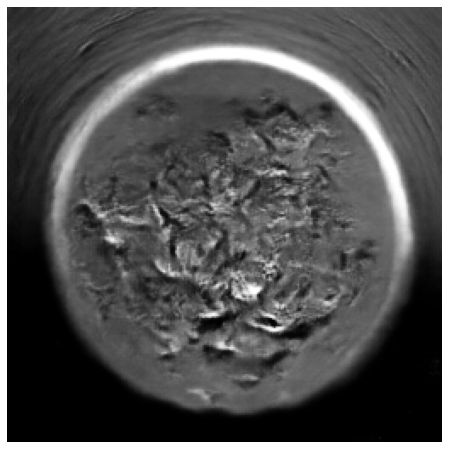

Time for epoch 496 is 15.907403707504272 sec


KeyboardInterrupt: ignored

In [ ]:
train(dataset, EPOCHS)

In [ ]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [ ]:
# Display a single image using the epoch number
def display_image(epoch_no):
  return PIL.Image.open('image_at_epoch_{:04d}.png'.format(epoch_no))

In [ ]:
display_image(EPOCHS)

# WGAN - GP
### Using Wassertein loss with Gradient Penalty to counter Mode Collapse of Binary Cross Entropy loss

In [ ]:
BATCH_SIZE = 32
latent_dim = 128
c_lambda = 10

# Will reuse this seed overtime to visualize generated image at each epoch
seed = tf.random.normal([4, latent_dim])

In [ ]:
def get_generator_model():
    inputs = tf.keras.Input(shape=(latent_dim, ), name='Input')

    x = tf.keras.layers.Dense(8 * 8 * 1024, use_bias=False)(inputs)
    x = tf.keras.layers.BatchNormalization()(x)
    x = tf.keras.layers.LeakyReLU()(x)

    x = tf.keras.layers.Reshape((8, 8, 1024))(x)
    residual = x

    for channel in [512, 256, 128]:
      x = tf.keras.layers.Conv2DTranspose(channel, 4, strides=2, padding='same', use_bias=False)(x)
      x = tf.keras.layers.BatchNormalization()(x)
      residual = tf.keras.layers.Conv2D(channel, 1)(residual)
      residual = tf.keras.layers.UpSampling2D(2)(residual)
      x = tf.add(x, residual)
      x = tf.keras.layers.LeakyReLU()(x)
      residual = x

    outputs = tf.keras.layers.Conv2DTranspose(3, 4, strides=2, padding='same', use_bias=False, activation='tanh')(x)
    
    model = tf.keras.Model(inputs, outputs)
    return model

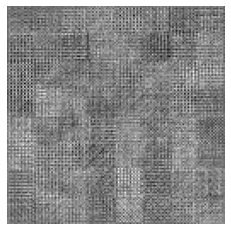

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Input (InputLayer)             [(None, 128)]        0           []                               
                                                                                                  
 dense (Dense)                  (None, 65536)        8388608     ['Input[0][0]']                  
                                                                                                  
 batch_normalization (BatchNorm  (None, 65536)       262144      ['dense[0][0]']                  
 alization)                                                                                       
                                                                                                  
 leaky_re_lu (LeakyReLU)        (None, 65536)        0           ['batch_normalization[0][0]']

In [ ]:
generator = get_generator_model()

noise = tf.random.normal([1, 128])
generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')
plt.axis('off')
plt.show()

generator.summary()

In [ ]:
def get_discriminator_model():
  inputs = tf.keras.Input(shape=(128, 128, 3))

  x = tf.keras.layers.Conv2D(64, 4, strides=2, padding='same', use_bias=False)(inputs)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.LeakyReLU()(x)
  x = tf.keras.layers.Dropout(0.3)(x)

  x = tf.keras.layers.Conv2D(128, 4, strides=2, padding='same', use_bias=False)(x)
  x = tf.keras.layers.BatchNormalization()(x)
  x = tf.keras.layers.LeakyReLU()(x)
  x = tf.keras.layers.Dropout(0.3)(x)

  x = tf.keras.layers.Flatten()(x)
  
  outputs = tf.keras.layers.Dense(1)(x)

  model = tf.keras.Model(inputs, outputs)
  return model

In [ ]:
discriminator = get_discriminator_model()
decision = discriminator(generated_image)
print(decision)

discriminator.summary()

tf.Tensor([[-0.00614935]], shape=(1, 1), dtype=float32)
Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 conv2d_3 (Conv2D)           (None, 64, 64, 64)        3072      
                                                                 
 batch_normalization_4 (Batc  (None, 64, 64, 64)       256       
 hNormalization)                                                 
                                                                 
 leaky_re_lu_4 (LeakyReLU)   (None, 64, 64, 64)        0         
                                                                 
 dropout (Dropout)           (None, 64, 64, 64)        0         
                                                                 
 conv2d_4 (Conv2D)           (None, 32, 32, 128)       131072    
   

In [ ]:
class WGAN(tf.keras.Model):
  def __init__(self, discriminator, generator, latent_dim, discriminator_extra_steps=3):
    super(WGAN, self).__init__()
    
    self.discriminator = discriminator
    self.generator = generator
    self.latent_dim = latent_dim
    self.d_steps = discriminator_extra_steps

  def compile(self, d_optimizer, g_optimizer, d_loss_fn, g_loss_fn):
    super(WGAN, self).compile()
  
    self.d_optimizer = d_optimizer
    self.g_optimizer = g_optimizer
    self.d_loss_fn = d_loss_fn
    self.g_loss_fn = g_loss_fn

  def gradient_penalty(self, batch_size, real_images, fake_images):
    epsilon = tf.random.normal(real_images[0].shape, 1, 1, 1)
    mixed_images = real_images * epsilon + fake_images * (1 - epsilon)

    with tf.GradientTape() as tape:
      tape.watch(mixed_images)
      mixed_scores = self.discriminator(mixed_images)

    grads = tape.gradient(mixed_scores, mixed_images)
    # norm = tf.sqrt(tf.reduce_sum(tf.square(grads), axis=[1, 2, 3]))
    norm = tf.norm(grads, axis=0)
    gp = tf.reduce_mean((norm - 1.0) ** 2)
    return gp
    
  def train_step(self, real_images):
    if isinstance(real_images, tuple):
      real_images = real_images[0]

    batch_size = tf.shape(real_images)[0]

    # Train the discriminator
    for i in range(self.d_steps):
      random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
      with tf.GradientTape() as tape:
        fake_images = self.generator(random_latent_vectors, training=True)
        fake_logits = self.discriminator(fake_images, training=True)
        real_logits = self.discriminator(real_images, training=True)
        
        gp = self.gradient_penalty(batch_size, real_images, fake_images)
        
        d_loss = self.d_loss_fn(real_img=real_logits, fake_img=fake_logits, gp=gp)

      d_gradient = tape.gradient(d_loss, self.discriminator.trainable_variables)
      self.d_optimizer.apply_gradients(zip(d_gradient, self.discriminator.trainable_variables))

    # Train the generator
    random_latent_vectors = tf.random.normal(shape=(batch_size, self.latent_dim))
    with tf.GradientTape() as tape:
      generated_images = self.generator(random_latent_vectors, training=True)
      gen_img_logits = self.discriminator(generated_images, training=True)
      g_loss = self.g_loss_fn(gen_img_logits)

    gen_gradient = tape.gradient(g_loss, self.generator.trainable_variables)
    self.g_optimizer.apply_gradients(zip(gen_gradient, self.generator.trainable_variables))
    
    return {"d_loss": d_loss, "g_loss": g_loss}

In [ ]:
class GANMonitor(tf.keras.callbacks.Callback):
  def __init__(self, num_img=4, latent_dim=128):
    self.num_img = num_img
    self.latent_dim = latent_dim

  def on_epoch_end(self, epoch, logs=None):
    generated_images = self.model.generator(seed)
    generated_images = (generated_images * 127.5) + 127.5

    fig = plt.figure(figsize=(8, 8))

    for i in range(self.num_img):
      plt.subplot(2, 2, i+1)
      plt.imshow(generated_images[i, :, :, 0], cmap='gray')
      plt.axis('off')
    plt.savefig('image_at_epoch_{:04d}.png'.format(epoch))
    plt.show()

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(
	learning_rate=0.0002, beta_1=0.5, beta_2=0.999)

discriminator_optimizer = tf.keras.optimizers.Adam(
    learning_rate=0.0002, beta_1=0.5, beta_2=0.999)

def discriminator_loss(real_img, fake_img, gp):
    real_loss = tf.reduce_mean(real_img)
    fake_loss = tf.reduce_mean(fake_img)
    return fake_loss - real_loss + c_lambda * gp

def generator_loss(fake_img):
    return -tf.reduce_mean(fake_img)

Epoch 1/250
47/47 [==============================] - ETA: 0s - d_loss: -446.6089 - g_loss: 57.0271

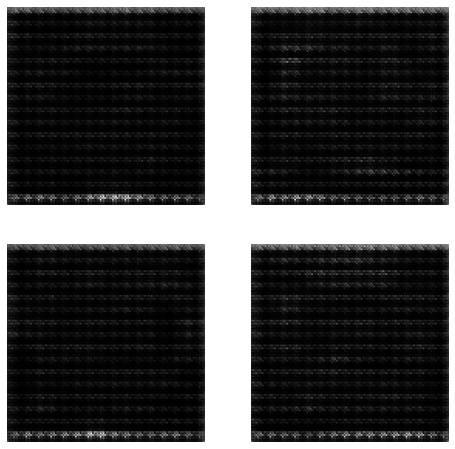

47/47 [==============================] - 34s 524ms/step - d_loss: -454.2742 - g_loss: 59.9645
Epoch 2/250
47/47 [==============================] - ETA: 0s - d_loss: -1340.0545 - g_loss: -119.3343

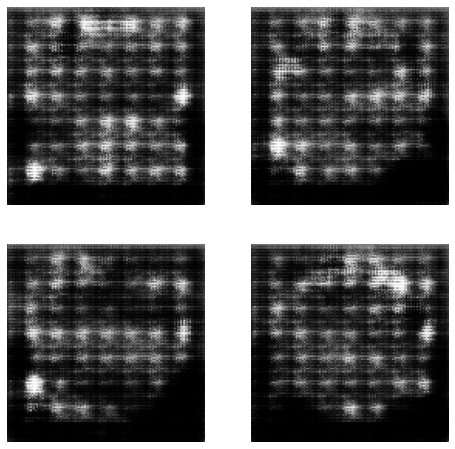

47/47 [==============================] - 25s 528ms/step - d_loss: -1342.2497 - g_loss: -126.5625
Epoch 3/250
47/47 [==============================] - ETA: 0s - d_loss: -1366.7633 - g_loss: -361.4269

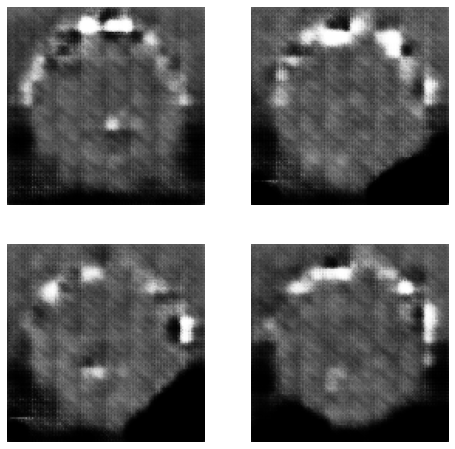

47/47 [==============================] - 26s 531ms/step - d_loss: -1360.4601 - g_loss: -378.3178
Epoch 4/250
47/47 [==============================] - ETA: 0s - d_loss: -748.4264 - g_loss: -739.3084

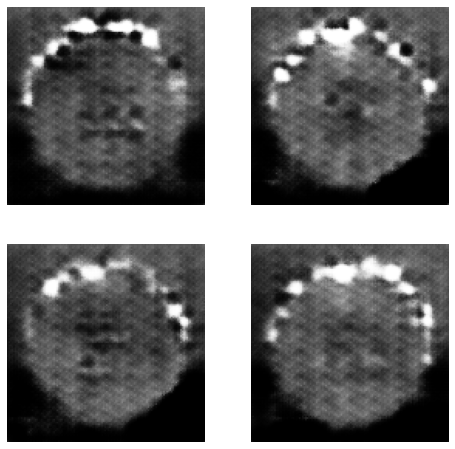

47/47 [==============================] - 25s 529ms/step - d_loss: -746.0116 - g_loss: -734.1247
Epoch 5/250
47/47 [==============================] - ETA: 0s - d_loss: -610.0637 - g_loss: -618.0456

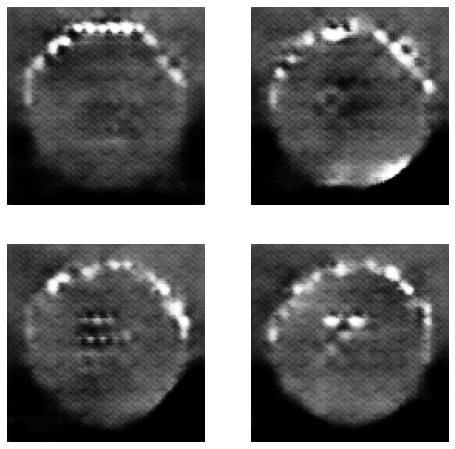

47/47 [==============================] - 26s 532ms/step - d_loss: -608.5802 - g_loss: -615.4986
Epoch 6/250
47/47 [==============================] - ETA: 0s - d_loss: -681.9085 - g_loss: -640.1442

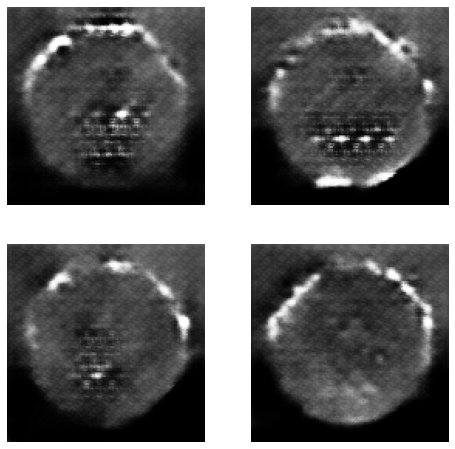

47/47 [==============================] - 26s 529ms/step - d_loss: -686.5404 - g_loss: -639.6699
Epoch 7/250
47/47 [==============================] - ETA: 0s - d_loss: -645.4748 - g_loss: -734.9872

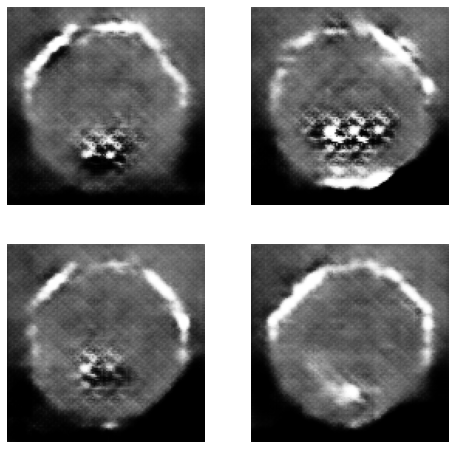

47/47 [==============================] - 26s 536ms/step - d_loss: -649.7854 - g_loss: -734.8176
Epoch 8/250
47/47 [==============================] - ETA: 0s - d_loss: -725.2284 - g_loss: -683.1688

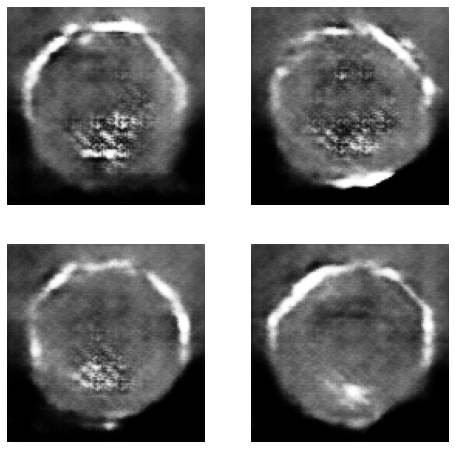

47/47 [==============================] - 25s 522ms/step - d_loss: -728.7387 - g_loss: -688.4089
Epoch 9/250
47/47 [==============================] - ETA: 0s - d_loss: -718.7654 - g_loss: -775.3226

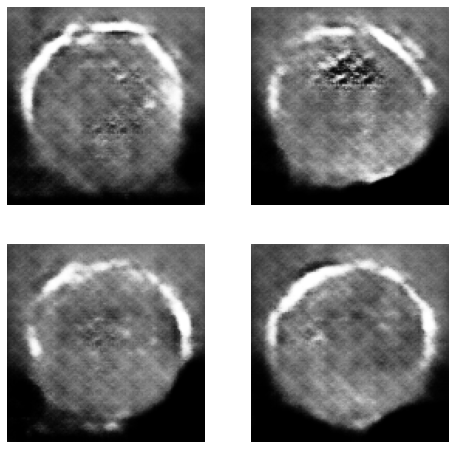

47/47 [==============================] - 26s 540ms/step - d_loss: -726.8593 - g_loss: -780.0454
Epoch 10/250
47/47 [==============================] - ETA: 0s - d_loss: -814.0465 - g_loss: -820.7199

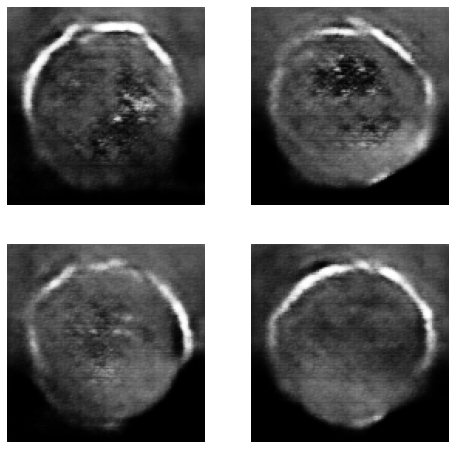

47/47 [==============================] - 26s 532ms/step - d_loss: -818.5697 - g_loss: -816.9684
Epoch 11/250
47/47 [==============================] - ETA: 0s - d_loss: -822.0527 - g_loss: -796.1237

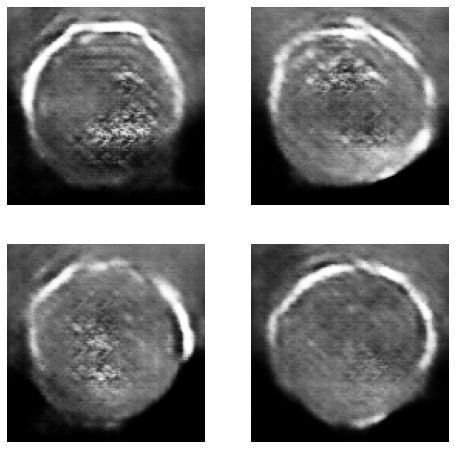

47/47 [==============================] - 25s 520ms/step - d_loss: -828.9350 - g_loss: -791.2960
Epoch 12/250
47/47 [==============================] - ETA: 0s - d_loss: -886.5119 - g_loss: -780.0550

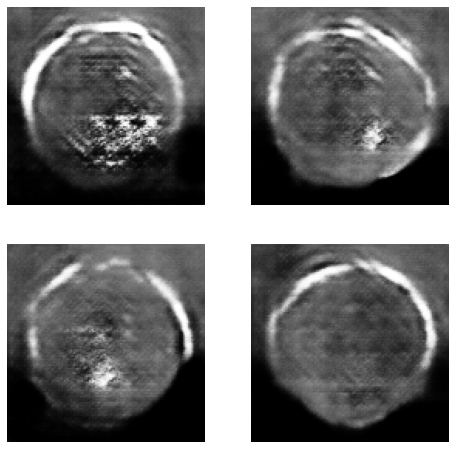

47/47 [==============================] - 26s 537ms/step - d_loss: -894.9209 - g_loss: -776.7461
Epoch 13/250
47/47 [==============================] - ETA: 0s - d_loss: -969.5338 - g_loss: -779.7447

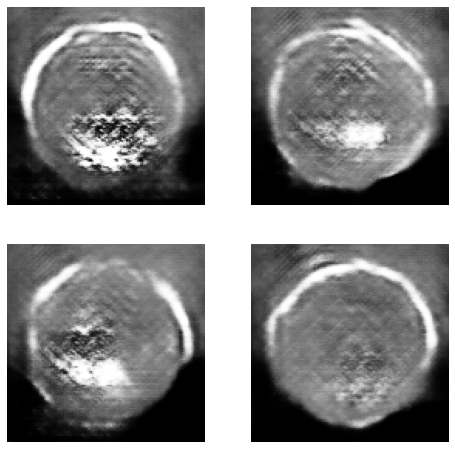

47/47 [==============================] - 26s 531ms/step - d_loss: -976.1604 - g_loss: -788.1597
Epoch 14/250
47/47 [==============================] - ETA: 0s - d_loss: -1014.9626 - g_loss: -776.9079

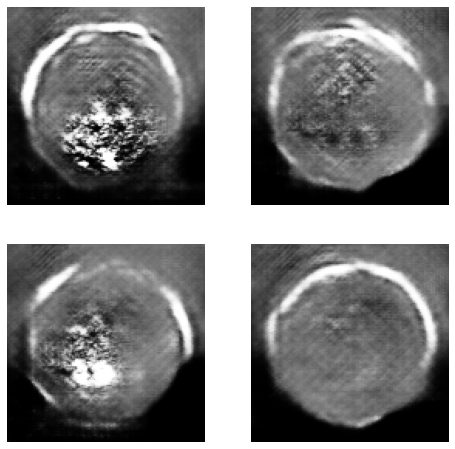

47/47 [==============================] - 25s 521ms/step - d_loss: -1018.8305 - g_loss: -776.6626
Epoch 15/250
47/47 [==============================] - ETA: 0s - d_loss: -1030.9426 - g_loss: -828.0900

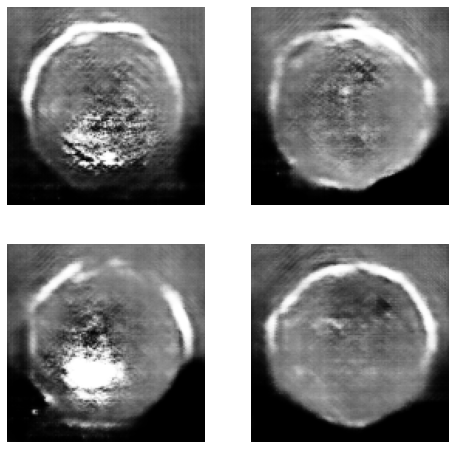

47/47 [==============================] - 26s 538ms/step - d_loss: -1034.0228 - g_loss: -811.1896
Epoch 16/250
47/47 [==============================] - ETA: 0s - d_loss: -1019.1507 - g_loss: -762.3523

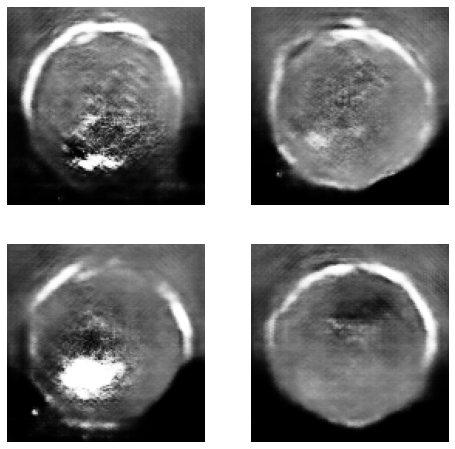

47/47 [==============================] - 25s 527ms/step - d_loss: -1031.9294 - g_loss: -753.6033
Epoch 17/250
47/47 [==============================] - ETA: 0s - d_loss: -971.1508 - g_loss: -823.6618

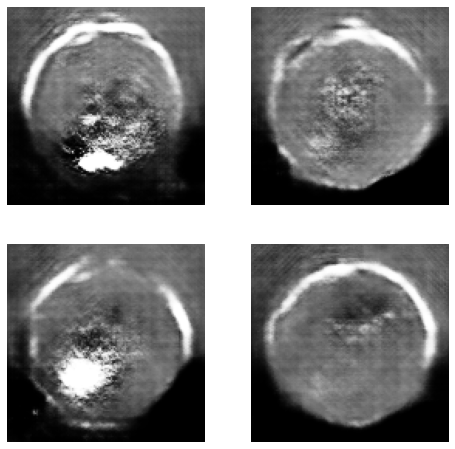

47/47 [==============================] - 26s 530ms/step - d_loss: -979.0630 - g_loss: -828.0442
Epoch 18/250
47/47 [==============================] - ETA: 0s - d_loss: -932.7933 - g_loss: -791.1444

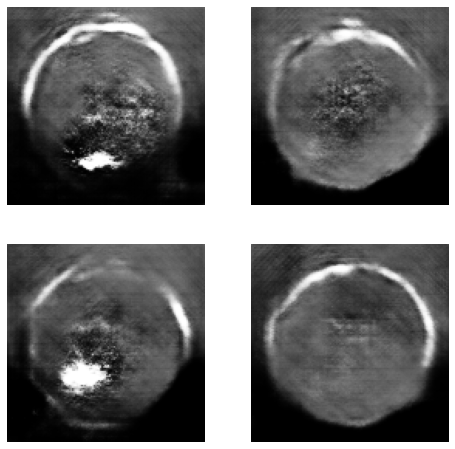

47/47 [==============================] - 26s 534ms/step - d_loss: -939.0395 - g_loss: -789.3389
Epoch 19/250
47/47 [==============================] - ETA: 0s - d_loss: -932.0974 - g_loss: -757.1244

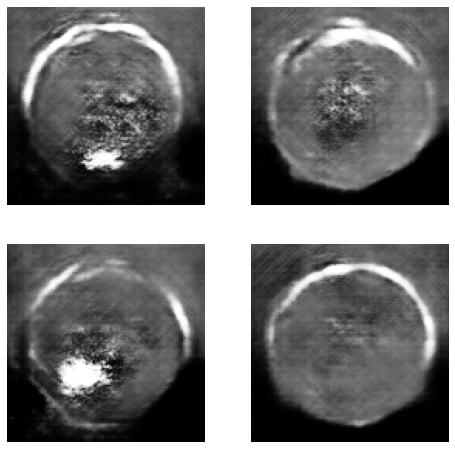

47/47 [==============================] - 25s 527ms/step - d_loss: -940.7881 - g_loss: -754.9470
Epoch 20/250
47/47 [==============================] - ETA: 0s - d_loss: -886.6420 - g_loss: -799.0014

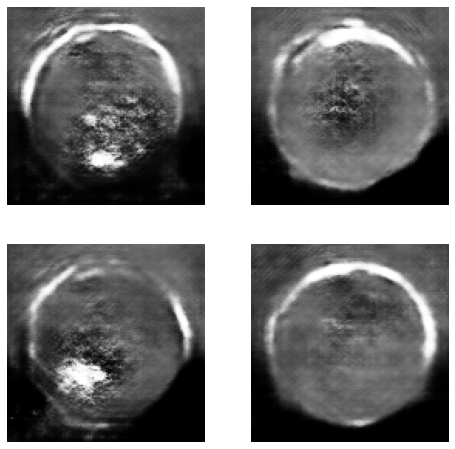

47/47 [==============================] - 26s 535ms/step - d_loss: -893.8308 - g_loss: -794.2753
Epoch 21/250
47/47 [==============================] - ETA: 0s - d_loss: -858.2786 - g_loss: -797.0665

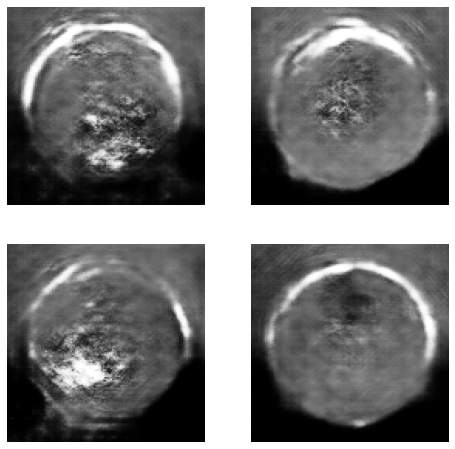

47/47 [==============================] - 25s 528ms/step - d_loss: -866.7319 - g_loss: -807.5715
Epoch 22/250
47/47 [==============================] - ETA: 0s - d_loss: -881.5031 - g_loss: -808.7203

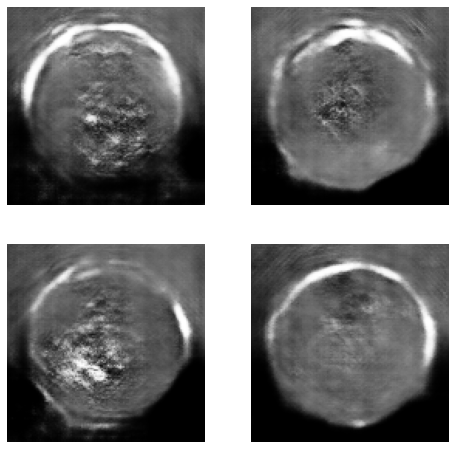

47/47 [==============================] - 26s 533ms/step - d_loss: -888.5205 - g_loss: -811.4562
Epoch 23/250
47/47 [==============================] - ETA: 0s - d_loss: -878.6688 - g_loss: -767.3909

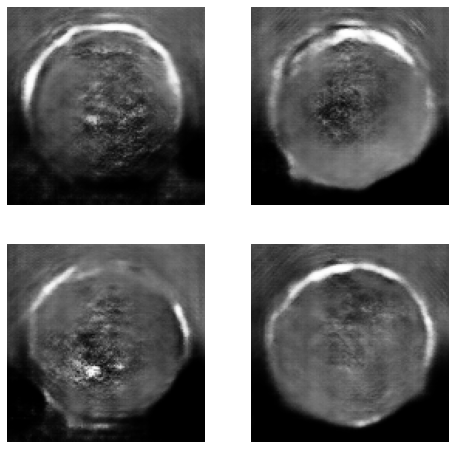

47/47 [==============================] - 26s 543ms/step - d_loss: -889.1154 - g_loss: -767.0891
Epoch 24/250
47/47 [==============================] - ETA: 0s - d_loss: -898.2647 - g_loss: -811.0745

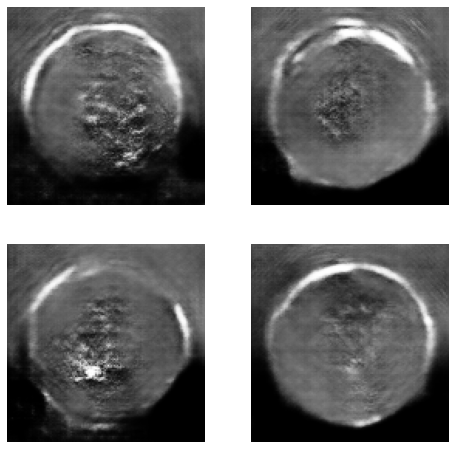

47/47 [==============================] - 25s 525ms/step - d_loss: -897.3082 - g_loss: -810.3447
Epoch 25/250
47/47 [==============================] - ETA: 0s - d_loss: -898.6537 - g_loss: -813.6151

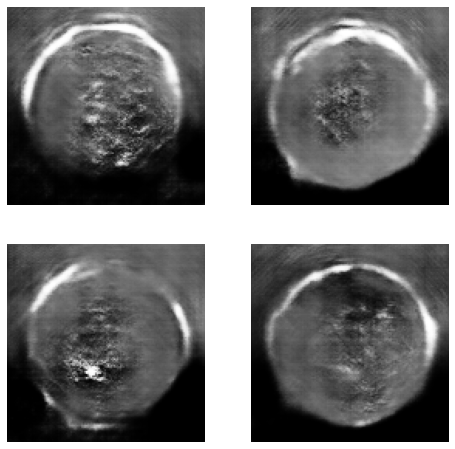

47/47 [==============================] - 26s 540ms/step - d_loss: -903.7726 - g_loss: -807.6739
Epoch 26/250
47/47 [==============================] - ETA: 0s - d_loss: -891.6302 - g_loss: -754.3630

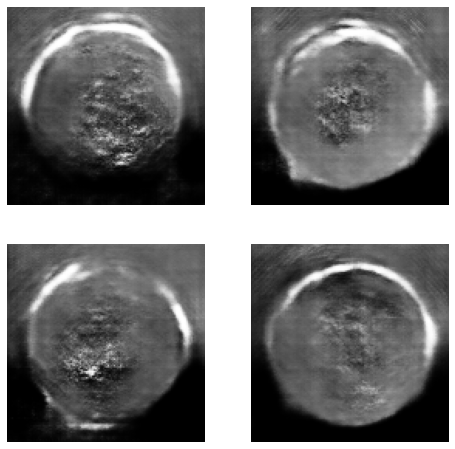

47/47 [==============================] - 25s 526ms/step - d_loss: -891.1714 - g_loss: -750.0204
Epoch 27/250
47/47 [==============================] - ETA: 0s - d_loss: -911.0958 - g_loss: -709.2368

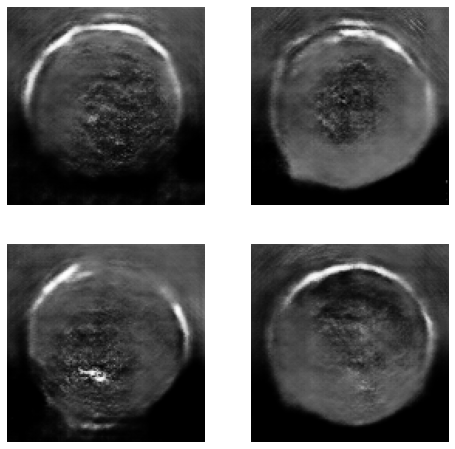

47/47 [==============================] - 26s 531ms/step - d_loss: -916.4189 - g_loss: -720.6587
Epoch 28/250
47/47 [==============================] - ETA: 0s - d_loss: -912.8704 - g_loss: -734.7001

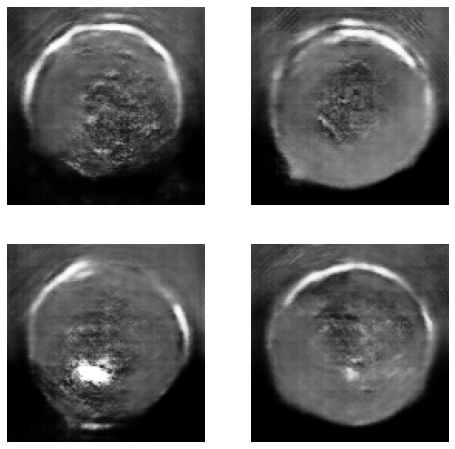

47/47 [==============================] - 26s 531ms/step - d_loss: -920.5944 - g_loss: -736.1567
Epoch 29/250
47/47 [==============================] - ETA: 0s - d_loss: -923.2856 - g_loss: -657.4889

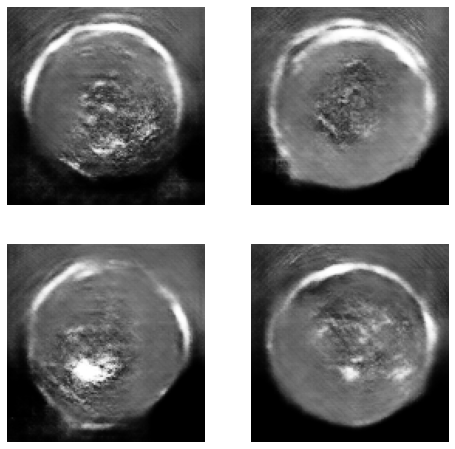

47/47 [==============================] - 26s 533ms/step - d_loss: -926.6677 - g_loss: -652.3704
Epoch 30/250
47/47 [==============================] - ETA: 0s - d_loss: -944.2485 - g_loss: -642.1316

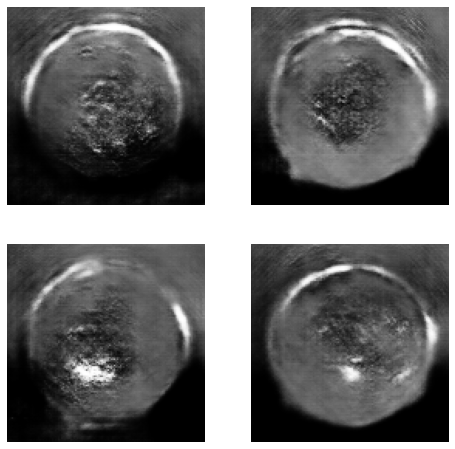

47/47 [==============================] - 25s 523ms/step - d_loss: -950.5791 - g_loss: -639.8692
Epoch 31/250
47/47 [==============================] - ETA: 0s - d_loss: -999.9958 - g_loss: -733.4590

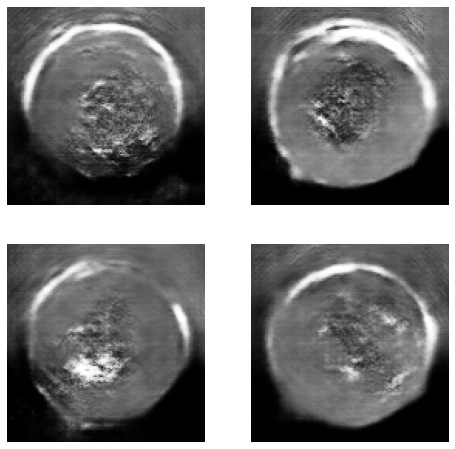

47/47 [==============================] - 26s 540ms/step - d_loss: -1005.0432 - g_loss: -727.3747
Epoch 32/250
47/47 [==============================] - ETA: 0s - d_loss: -945.1984 - g_loss: -722.0496

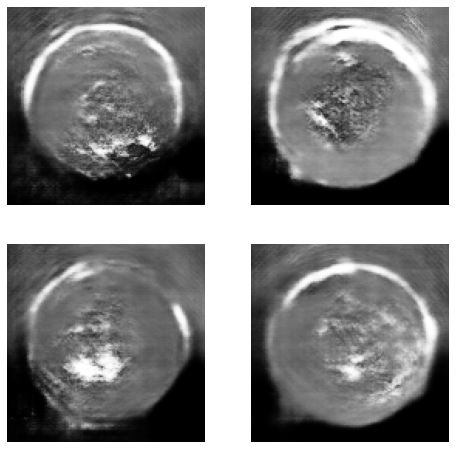

47/47 [==============================] - 25s 528ms/step - d_loss: -947.5939 - g_loss: -716.8627
Epoch 33/250
47/47 [==============================] - ETA: 0s - d_loss: -1000.3774 - g_loss: -682.1967

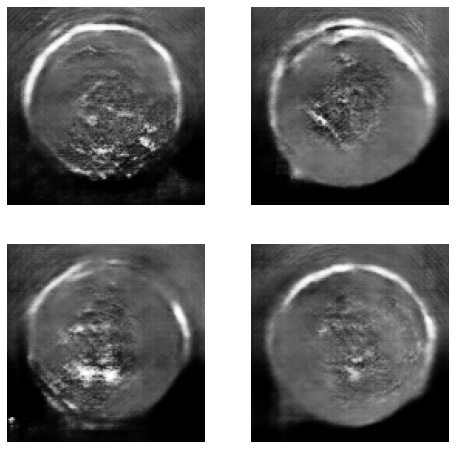

47/47 [==============================] - 26s 535ms/step - d_loss: -1013.5929 - g_loss: -675.7823
Epoch 34/250
47/47 [==============================] - ETA: 0s - d_loss: -994.6278 - g_loss: -749.9604

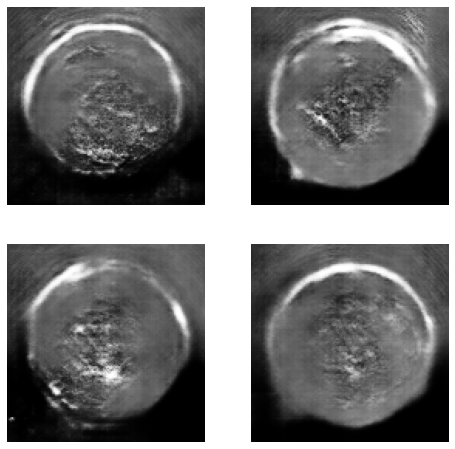

47/47 [==============================] - 26s 532ms/step - d_loss: -1000.7411 - g_loss: -754.6597
Epoch 35/250
47/47 [==============================] - ETA: 0s - d_loss: -1000.2944 - g_loss: -768.8763

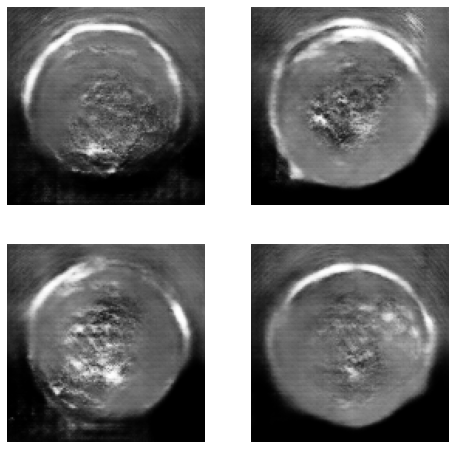

47/47 [==============================] - 26s 532ms/step - d_loss: -1000.9235 - g_loss: -740.4434
Epoch 36/250
47/47 [==============================] - ETA: 0s - d_loss: -993.4382 - g_loss: -731.2680

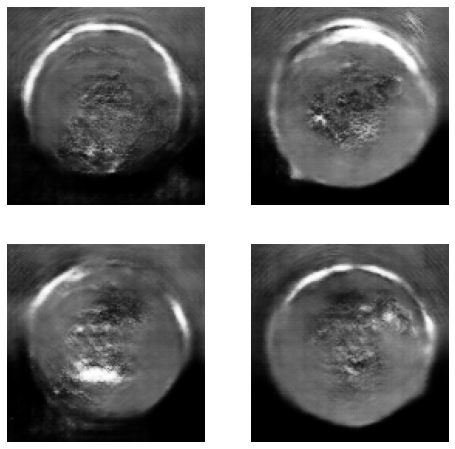

47/47 [==============================] - 26s 532ms/step - d_loss: -1004.4729 - g_loss: -716.1939
Epoch 37/250
47/47 [==============================] - ETA: 0s - d_loss: -1021.0970 - g_loss: -696.6529

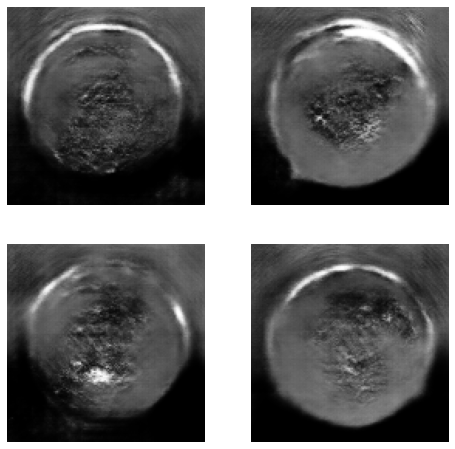

47/47 [==============================] - 26s 533ms/step - d_loss: -1021.7743 - g_loss: -699.2023
Epoch 38/250
47/47 [==============================] - ETA: 0s - d_loss: -1044.1939 - g_loss: -754.5352

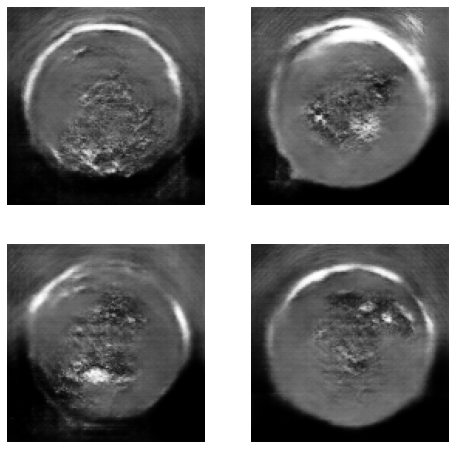

47/47 [==============================] - 26s 532ms/step - d_loss: -1047.8561 - g_loss: -786.3811
Epoch 39/250
47/47 [==============================] - ETA: 0s - d_loss: -1023.5330 - g_loss: -853.4290

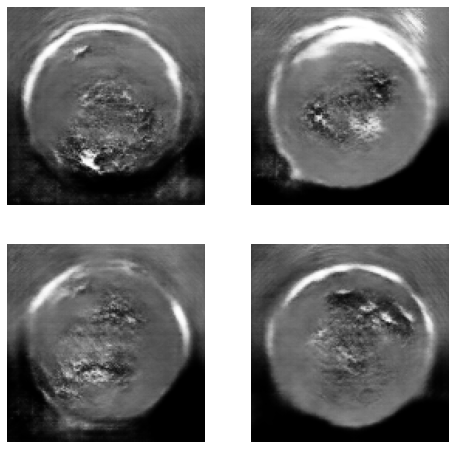

47/47 [==============================] - 25s 522ms/step - d_loss: -1027.0362 - g_loss: -820.4716
Epoch 40/250
47/47 [==============================] - ETA: 0s - d_loss: -1152.0863 - g_loss: -1005.9552

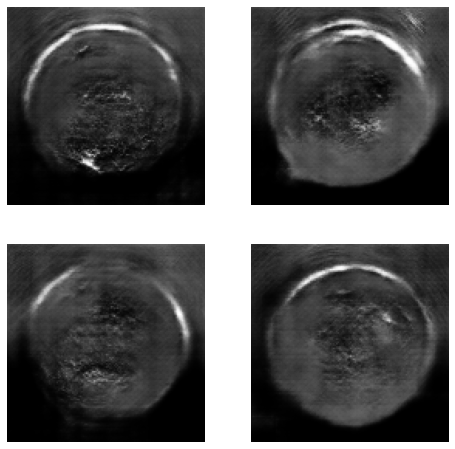

47/47 [==============================] - 26s 540ms/step - d_loss: -1161.2450 - g_loss: -1007.6191
Epoch 41/250
47/47 [==============================] - ETA: 0s - d_loss: -1154.3597 - g_loss: -952.9381

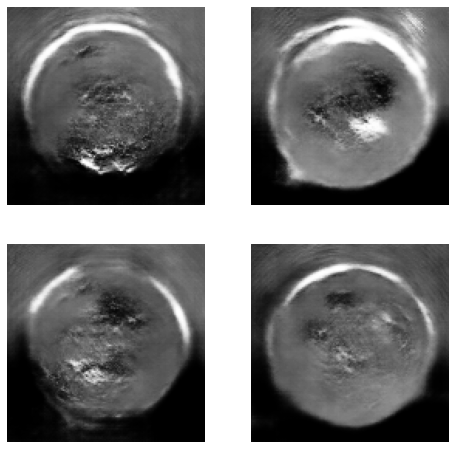

47/47 [==============================] - 25s 524ms/step - d_loss: -1152.1854 - g_loss: -962.0038
Epoch 42/250
47/47 [==============================] - ETA: 0s - d_loss: -1100.6564 - g_loss: -934.2042

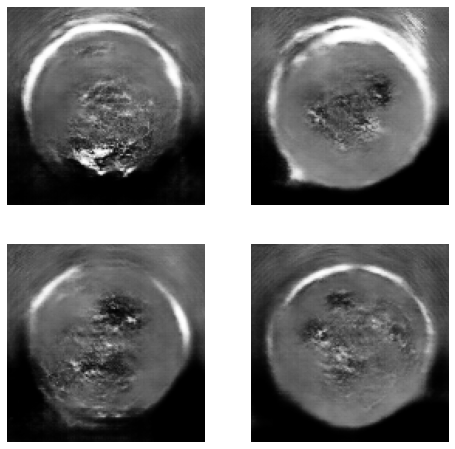

47/47 [==============================] - 26s 540ms/step - d_loss: -1113.8466 - g_loss: -922.5006
Epoch 43/250
47/47 [==============================] - ETA: 0s - d_loss: -1093.7976 - g_loss: -987.2645

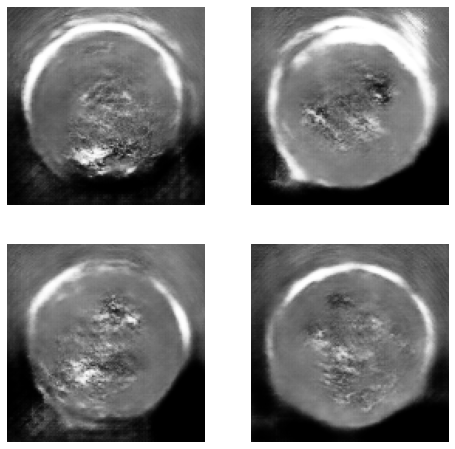

47/47 [==============================] - 26s 530ms/step - d_loss: -1103.9575 - g_loss: -983.8978
Epoch 44/250
47/47 [==============================] - ETA: 0s - d_loss: -1120.9069 - g_loss: -1150.6822

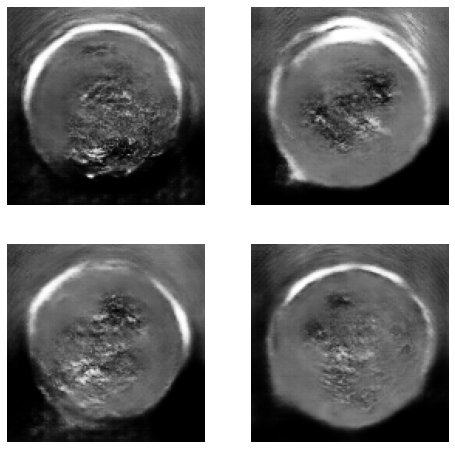

47/47 [==============================] - 25s 521ms/step - d_loss: -1139.9909 - g_loss: -1148.3083
Epoch 45/250
47/47 [==============================] - ETA: 0s - d_loss: -1028.2686 - g_loss: -877.2720

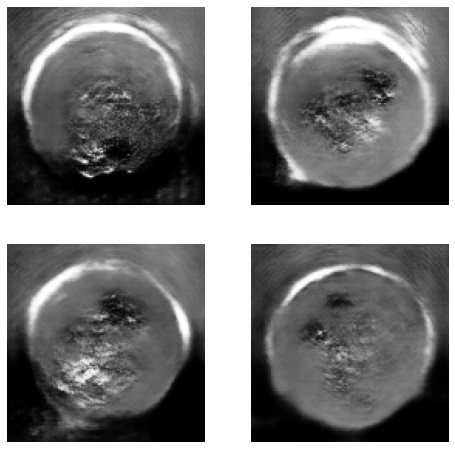

47/47 [==============================] - 26s 540ms/step - d_loss: -1059.4004 - g_loss: -858.3658
Epoch 46/250
47/47 [==============================] - ETA: 0s - d_loss: -1078.9652 - g_loss: -1180.0987

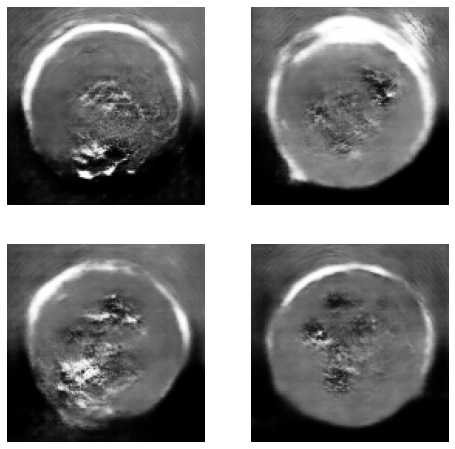

47/47 [==============================] - 25s 528ms/step - d_loss: -1084.3406 - g_loss: -1181.0137
Epoch 47/250
47/47 [==============================] - ETA: 0s - d_loss: -1098.3169 - g_loss: -1237.0886

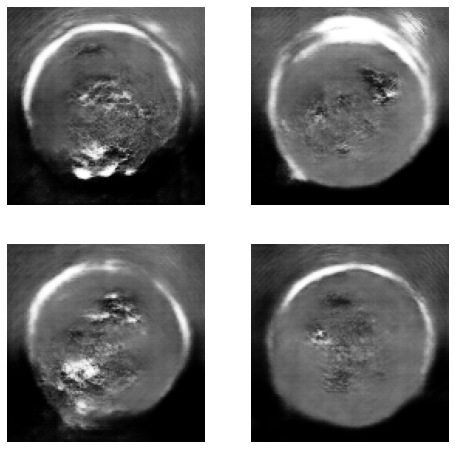

47/47 [==============================] - 26s 534ms/step - d_loss: -1109.9357 - g_loss: -1207.0366
Epoch 48/250
47/47 [==============================] - ETA: 0s - d_loss: -1044.1292 - g_loss: -1002.5714

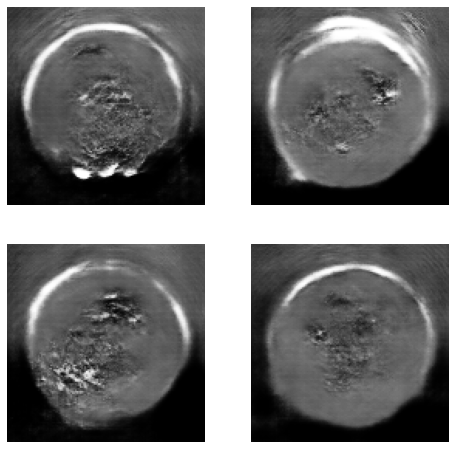

47/47 [==============================] - 27s 566ms/step - d_loss: -1048.3890 - g_loss: -954.4081
Epoch 49/250
47/47 [==============================] - ETA: 0s - d_loss: -1091.8405 - g_loss: -1199.2569

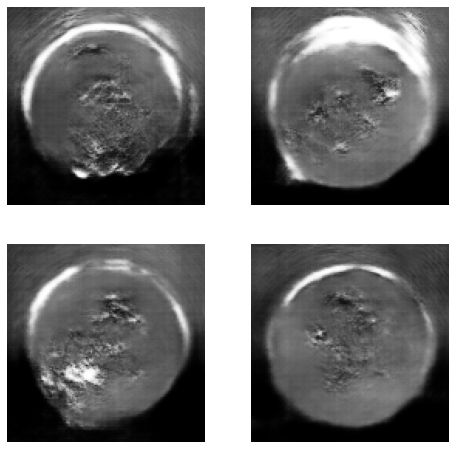

47/47 [==============================] - 26s 549ms/step - d_loss: -1102.3395 - g_loss: -1184.6065
Epoch 50/250
47/47 [==============================] - ETA: 0s - d_loss: -1027.0116 - g_loss: -1185.4459

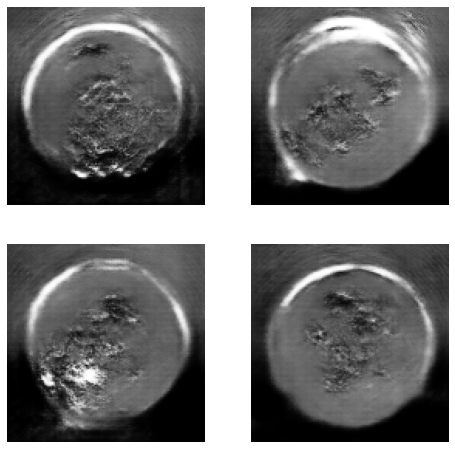

47/47 [==============================] - 26s 532ms/step - d_loss: -1040.6441 - g_loss: -1176.7468
Epoch 51/250
47/47 [==============================] - ETA: 0s - d_loss: -1152.0971 - g_loss: -1268.1989

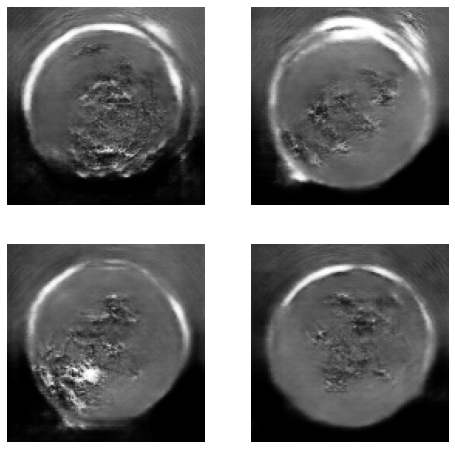

47/47 [==============================] - 26s 535ms/step - d_loss: -1155.5758 - g_loss: -1258.6512
Epoch 52/250
47/47 [==============================] - ETA: 0s - d_loss: -973.9079 - g_loss: -1052.7876

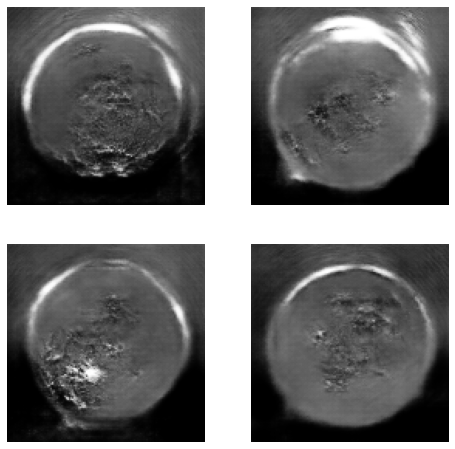

47/47 [==============================] - 26s 538ms/step - d_loss: -986.0658 - g_loss: -1084.0300
Epoch 53/250
47/47 [==============================] - ETA: 0s - d_loss: -1052.9049 - g_loss: -1099.6154

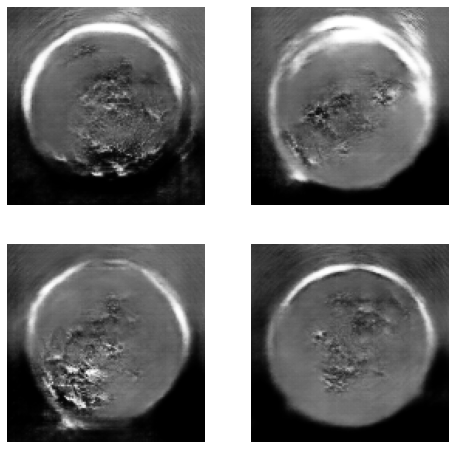

47/47 [==============================] - 25s 522ms/step - d_loss: -1058.2094 - g_loss: -1084.2488
Epoch 54/250
47/47 [==============================] - ETA: 0s - d_loss: -1106.1391 - g_loss: -1447.4215

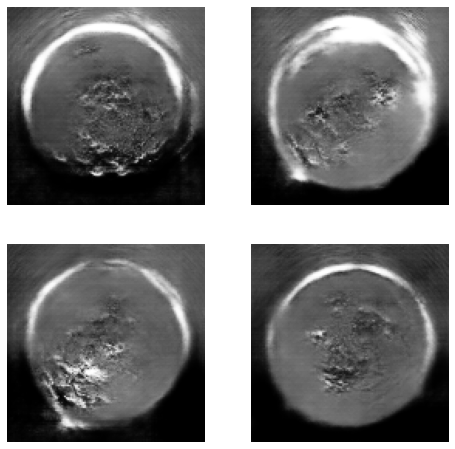

47/47 [==============================] - 26s 546ms/step - d_loss: -1110.3781 - g_loss: -1452.2741
Epoch 55/250
47/47 [==============================] - ETA: 0s - d_loss: -1116.7027 - g_loss: -1627.1068

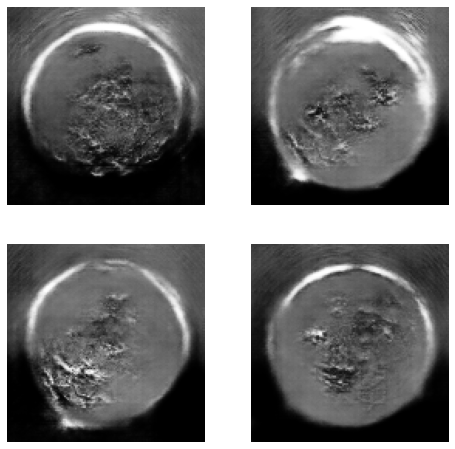

47/47 [==============================] - 26s 538ms/step - d_loss: -1119.6946 - g_loss: -1614.2738
Epoch 56/250
47/47 [==============================] - ETA: 0s - d_loss: -1053.8508 - g_loss: -1194.6793

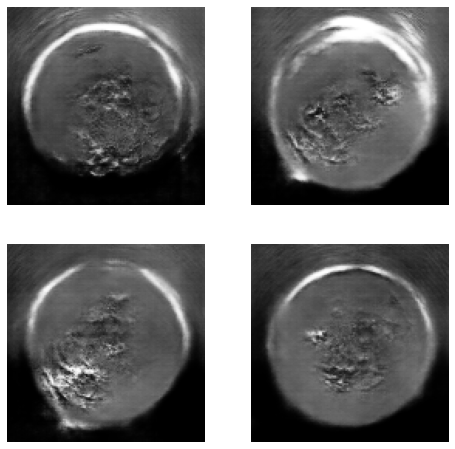

47/47 [==============================] - 26s 534ms/step - d_loss: -1065.5170 - g_loss: -1207.7734
Epoch 57/250
47/47 [==============================] - ETA: 0s - d_loss: -1150.9624 - g_loss: -1330.1956

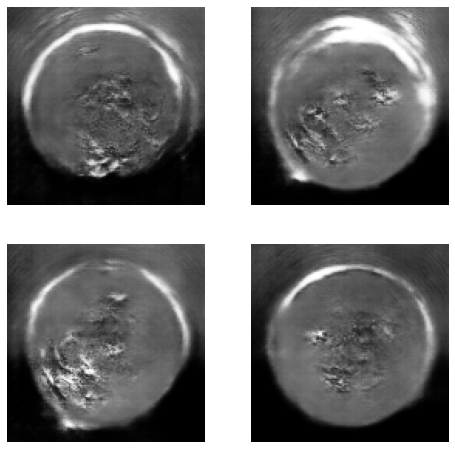

47/47 [==============================] - 26s 537ms/step - d_loss: -1166.9168 - g_loss: -1340.1038
Epoch 58/250
47/47 [==============================] - ETA: 0s - d_loss: -1025.0646 - g_loss: -1418.5566

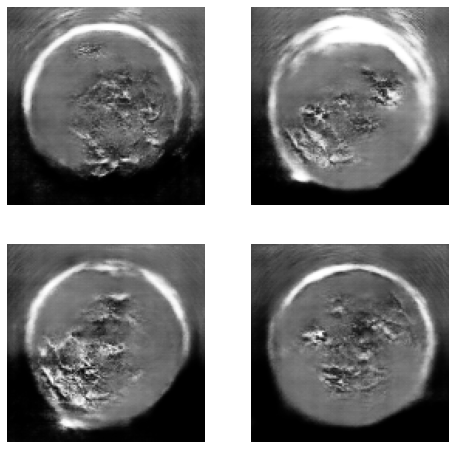

47/47 [==============================] - 26s 533ms/step - d_loss: -1025.8110 - g_loss: -1449.7020
Epoch 59/250
47/47 [==============================] - ETA: 0s - d_loss: -1236.3455 - g_loss: -1811.0273

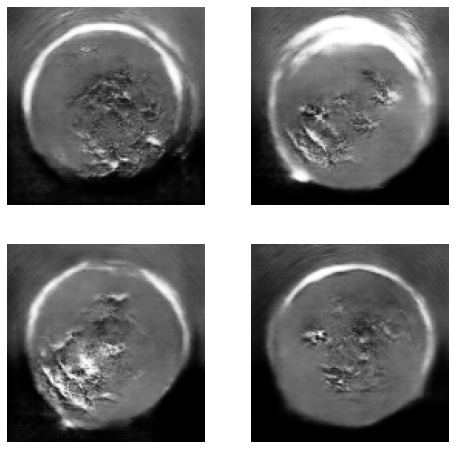

47/47 [==============================] - 26s 531ms/step - d_loss: -1243.2716 - g_loss: -1802.2780
Epoch 60/250
47/47 [==============================] - ETA: 0s - d_loss: -1058.9091 - g_loss: -1354.9266

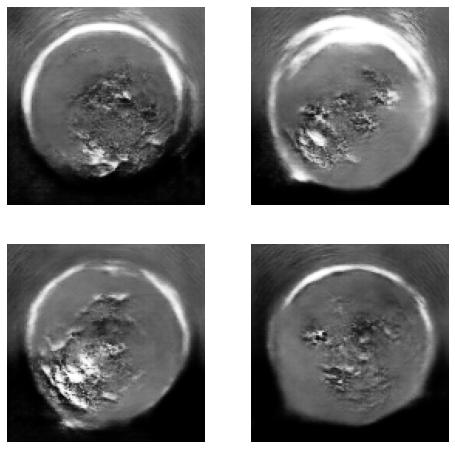

47/47 [==============================] - 26s 537ms/step - d_loss: -1070.9964 - g_loss: -1335.6470
Epoch 61/250
47/47 [==============================] - ETA: 0s - d_loss: -1099.6133 - g_loss: -1500.2741

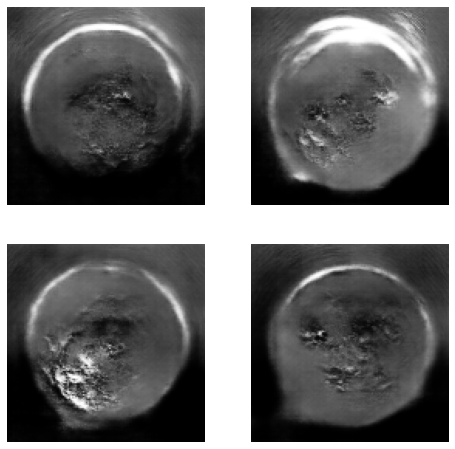

47/47 [==============================] - 26s 537ms/step - d_loss: -1101.1425 - g_loss: -1539.1996
Epoch 62/250
47/47 [==============================] - ETA: 0s - d_loss: -1021.7480 - g_loss: -1616.3863  

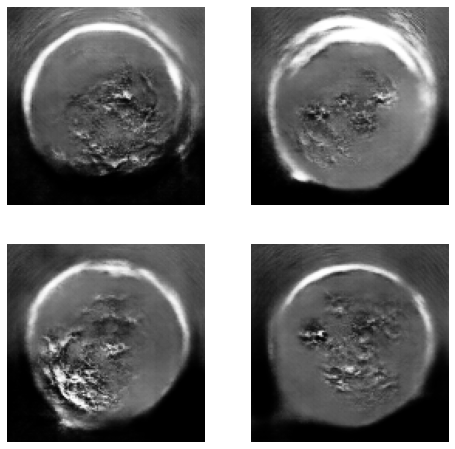

47/47 [==============================] - 3755s 82s/step - d_loss: -1028.1585 - g_loss: -1617.6400
Epoch 63/250
47/47 [==============================] - ETA: 0s - d_loss: -1017.1556 - g_loss: -1470.1570

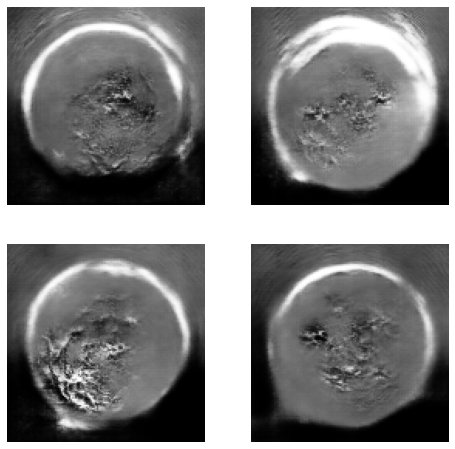

47/47 [==============================] - 26s 538ms/step - d_loss: -1020.2134 - g_loss: -1459.5722
Epoch 64/250
47/47 [==============================] - ETA: 0s - d_loss: -1035.5497 - g_loss: -1517.1256

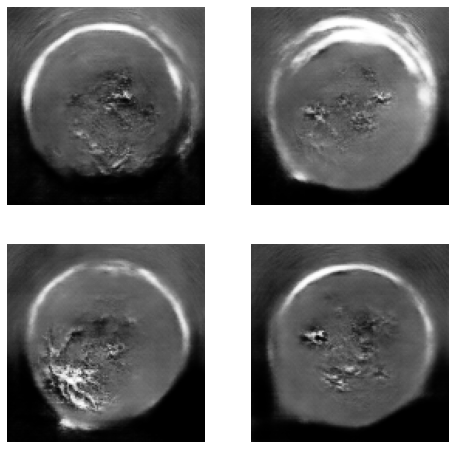

47/47 [==============================] - 26s 529ms/step - d_loss: -1038.5649 - g_loss: -1498.9129
Epoch 65/250
47/47 [==============================] - ETA: 0s - d_loss: -1047.9115 - g_loss: -1575.3351

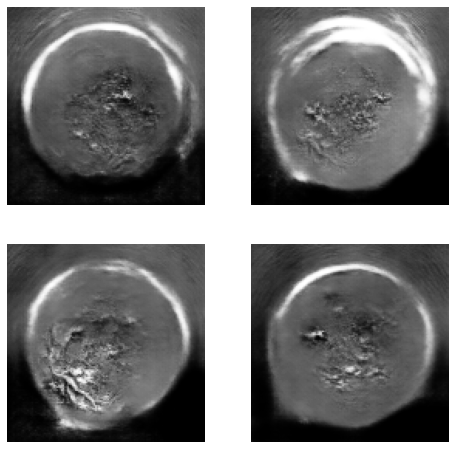

47/47 [==============================] - 26s 534ms/step - d_loss: -1057.7681 - g_loss: -1607.7676
Epoch 66/250
47/47 [==============================] - ETA: 0s - d_loss: -981.9126 - g_loss: -1505.3242

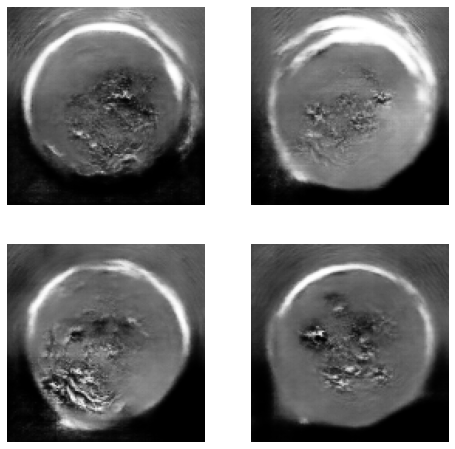

47/47 [==============================] - 26s 532ms/step - d_loss: -984.1570 - g_loss: -1490.8831
Epoch 67/250
47/47 [==============================] - ETA: 0s - d_loss: -963.7555 - g_loss: -1392.8166

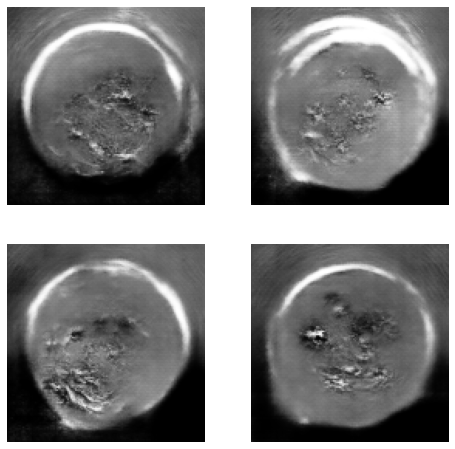

47/47 [==============================] - 26s 535ms/step - d_loss: -959.9705 - g_loss: -1411.2500
Epoch 68/250
47/47 [==============================] - ETA: 0s - d_loss: -1135.9979 - g_loss: -1814.7765

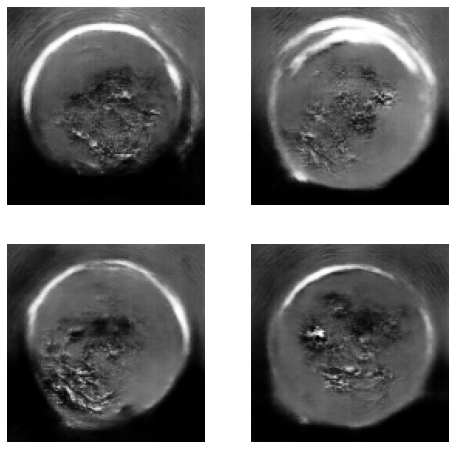

47/47 [==============================] - 25s 529ms/step - d_loss: -1140.8050 - g_loss: -1746.7241
Epoch 69/250
47/47 [==============================] - ETA: 0s - d_loss: -1237.2846 - g_loss: -1703.7024

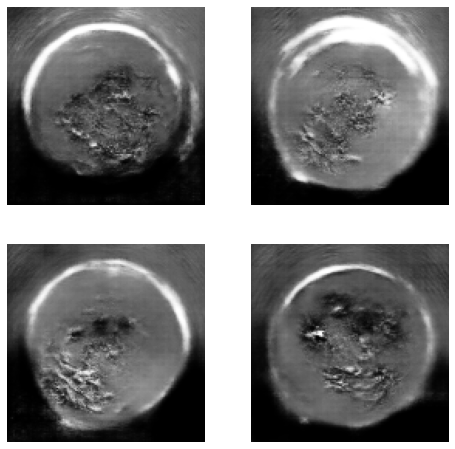

47/47 [==============================] - 26s 536ms/step - d_loss: -1240.6951 - g_loss: -1701.9018
Epoch 70/250
47/47 [==============================] - ETA: 0s - d_loss: -1085.1212 - g_loss: -1921.6570

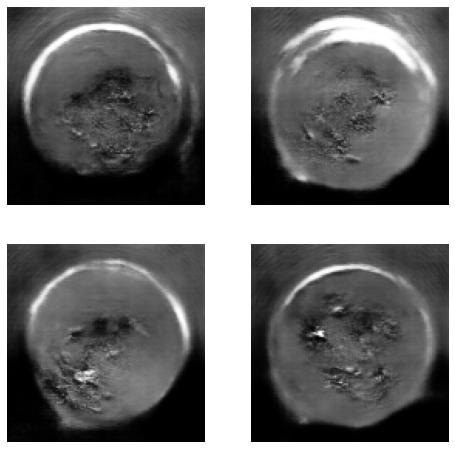

47/47 [==============================] - 26s 530ms/step - d_loss: -1092.4475 - g_loss: -1922.6757
Epoch 71/250
47/47 [==============================] - ETA: 0s - d_loss: -1298.5897 - g_loss: -1950.9054

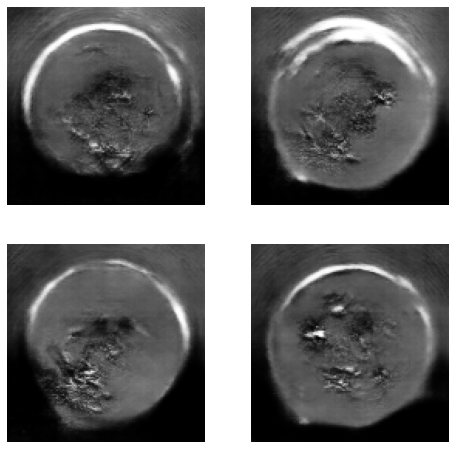

47/47 [==============================] - 26s 533ms/step - d_loss: -1309.5829 - g_loss: -1868.6306
Epoch 72/250
47/47 [==============================] - ETA: 0s - d_loss: -1158.1937 - g_loss: -2146.2472

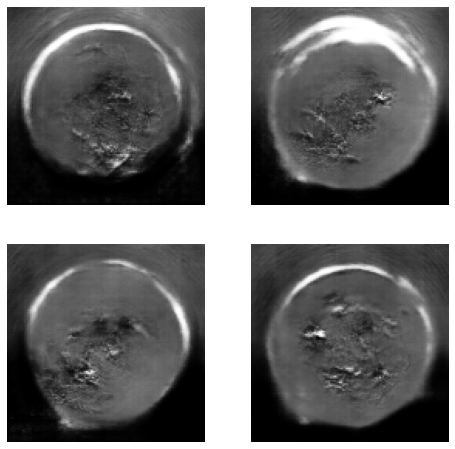

47/47 [==============================] - 26s 537ms/step - d_loss: -1161.3573 - g_loss: -2148.4020
Epoch 73/250
47/47 [==============================] - ETA: 0s - d_loss: -1173.7831 - g_loss: -2048.9987

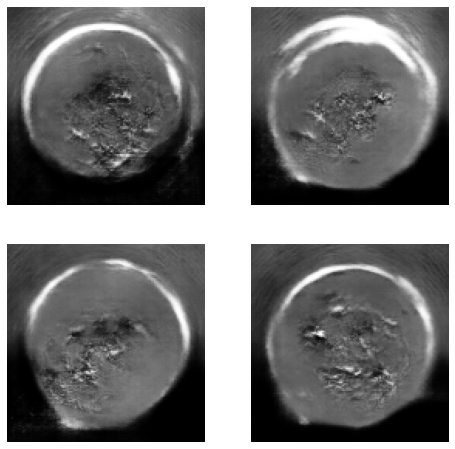

47/47 [==============================] - 26s 528ms/step - d_loss: -1178.7851 - g_loss: -2052.5756
Epoch 74/250
47/47 [==============================] - ETA: 0s - d_loss: -1201.1934 - g_loss: -2112.8097

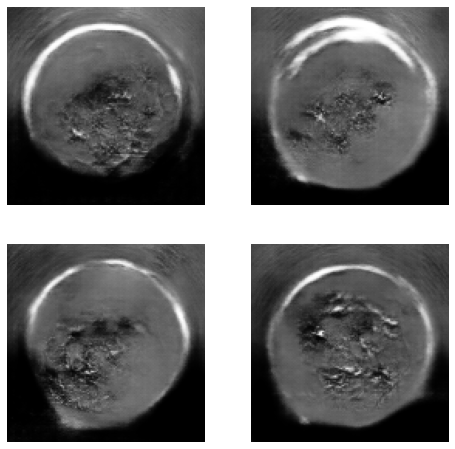

47/47 [==============================] - 25s 526ms/step - d_loss: -1200.3353 - g_loss: -2111.3145
Epoch 75/250
47/47 [==============================] - ETA: 0s - d_loss: -1125.3046 - g_loss: -2000.5438

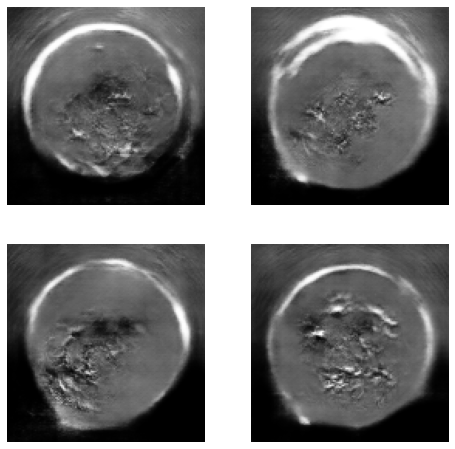

47/47 [==============================] - 26s 537ms/step - d_loss: -1129.2470 - g_loss: -1992.0377
Epoch 76/250
47/47 [==============================] - ETA: 0s - d_loss: -1125.9714 - g_loss: -2067.3302

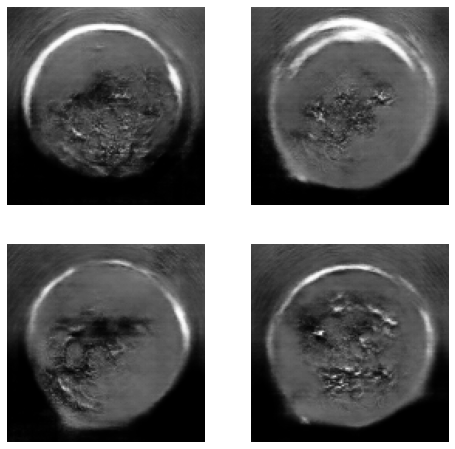

47/47 [==============================] - 26s 531ms/step - d_loss: -1134.6784 - g_loss: -2067.2140
Epoch 77/250
47/47 [==============================] - ETA: 0s - d_loss: -936.5297 - g_loss: -1674.0546

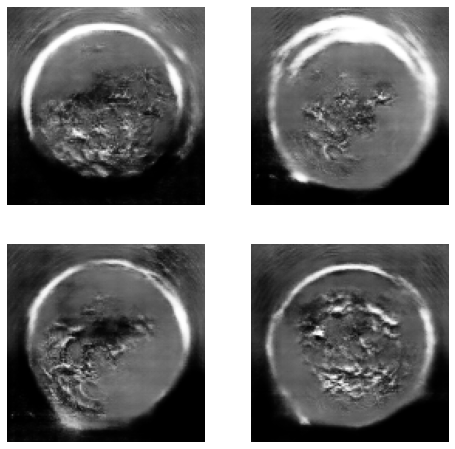

47/47 [==============================] - 26s 535ms/step - d_loss: -937.4899 - g_loss: -1682.5383
Epoch 78/250
47/47 [==============================] - ETA: 0s - d_loss: -919.7187 - g_loss: -2039.2883

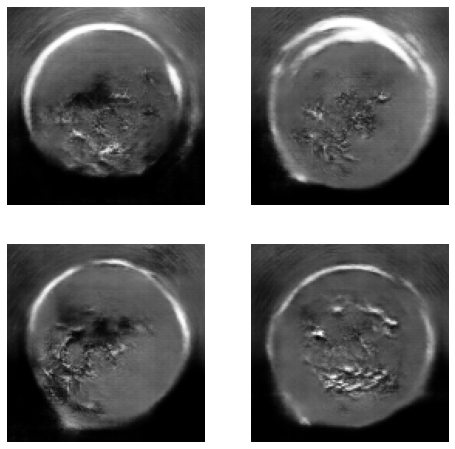

47/47 [==============================] - 25s 523ms/step - d_loss: -923.7706 - g_loss: -2057.5163
Epoch 79/250
47/47 [==============================] - ETA: 0s - d_loss: -1079.4365 - g_loss: -1741.8956

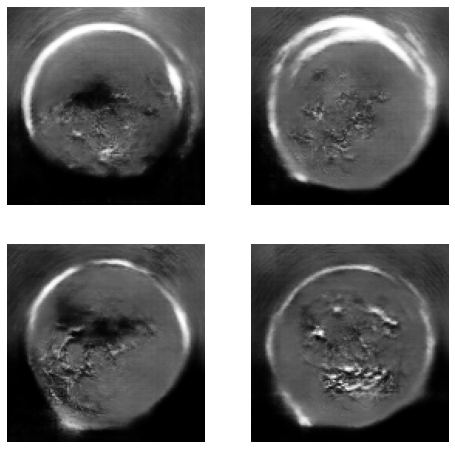

47/47 [==============================] - 26s 542ms/step - d_loss: -1075.9202 - g_loss: -1724.3407
Epoch 80/250
47/47 [==============================] - ETA: 0s - d_loss: -986.4326 - g_loss: -1830.5875

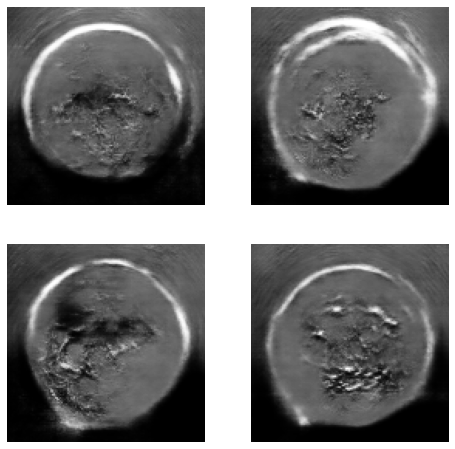

47/47 [==============================] - 25s 523ms/step - d_loss: -996.5067 - g_loss: -1795.7128
Epoch 81/250
47/47 [==============================] - ETA: 0s - d_loss: -974.9107 - g_loss: -1798.5700

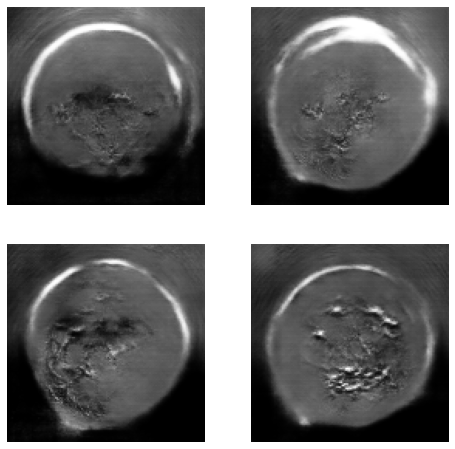

47/47 [==============================] - 26s 543ms/step - d_loss: -981.7322 - g_loss: -1811.8168
Epoch 82/250
47/47 [==============================] - ETA: 0s - d_loss: -1032.6440 - g_loss: -1971.7859

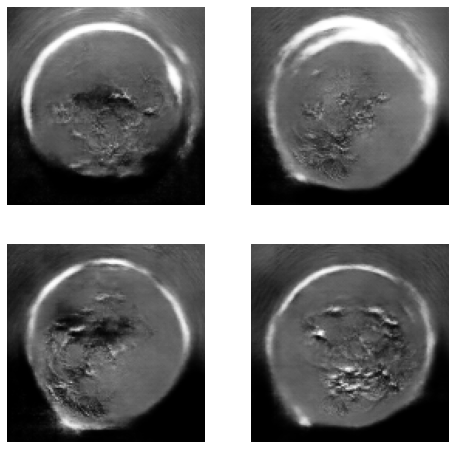

47/47 [==============================] - 26s 531ms/step - d_loss: -1038.1064 - g_loss: -1990.3370
Epoch 83/250
47/47 [==============================] - ETA: 0s - d_loss: -1123.1143 - g_loss: -2097.1685

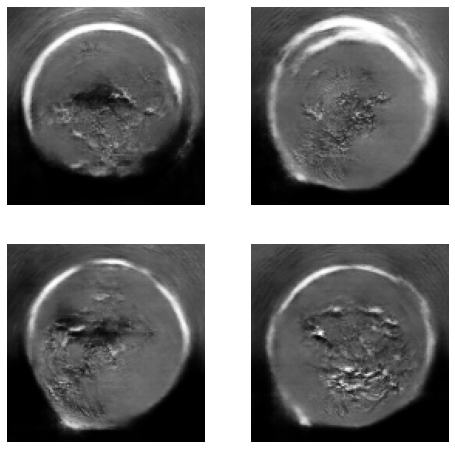

47/47 [==============================] - 25s 522ms/step - d_loss: -1132.9803 - g_loss: -2084.8583
Epoch 84/250
47/47 [==============================] - ETA: 0s - d_loss: -1024.5813 - g_loss: -2106.1145

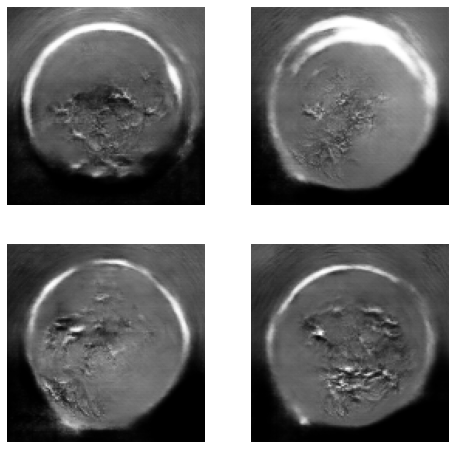

47/47 [==============================] - 26s 542ms/step - d_loss: -1027.2967 - g_loss: -2125.7294
Epoch 85/250
47/47 [==============================] - ETA: 0s - d_loss: -1081.0463 - g_loss: -2057.3145

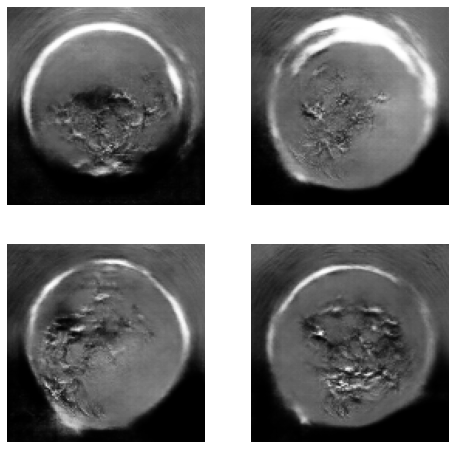

47/47 [==============================] - 25s 529ms/step - d_loss: -1080.7343 - g_loss: -2058.3091
Epoch 86/250
47/47 [==============================] - ETA: 0s - d_loss: -892.1074 - g_loss: -2100.2872

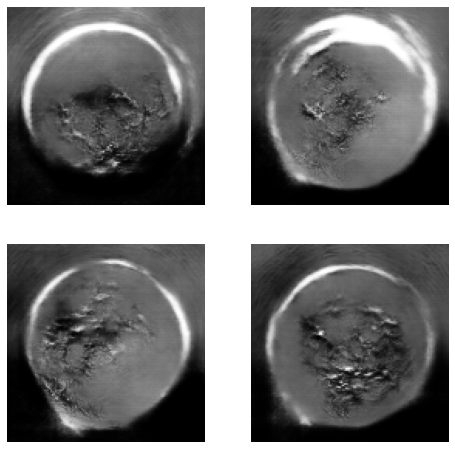

47/47 [==============================] - 26s 540ms/step - d_loss: -896.9942 - g_loss: -2068.2893
Epoch 87/250
47/47 [==============================] - ETA: 0s - d_loss: -762.2924 - g_loss: -1777.0561

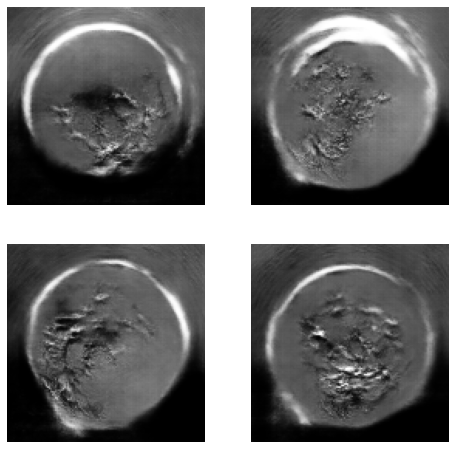

47/47 [==============================] - 26s 531ms/step - d_loss: -773.2929 - g_loss: -1729.8193
Epoch 88/250
47/47 [==============================] - ETA: 0s - d_loss: -875.5963 - g_loss: -1882.5296

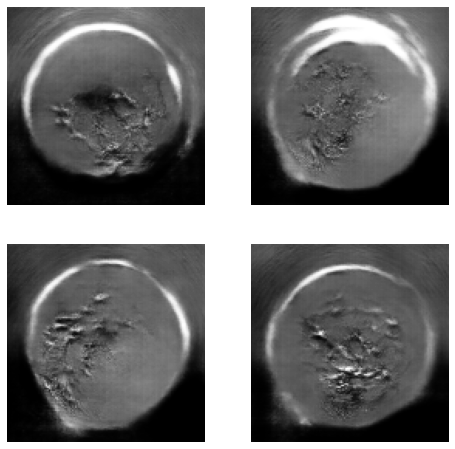

47/47 [==============================] - 26s 533ms/step - d_loss: -877.9147 - g_loss: -1899.8908
Epoch 89/250
47/47 [==============================] - ETA: 0s - d_loss: -724.5923 - g_loss: -1663.3413

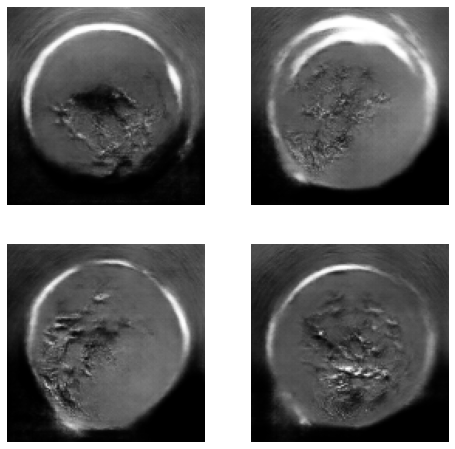

47/47 [==============================] - 26s 534ms/step - d_loss: -737.6950 - g_loss: -1656.8331
Epoch 90/250
47/47 [==============================] - ETA: 0s - d_loss: -781.5403 - g_loss: -1608.6413

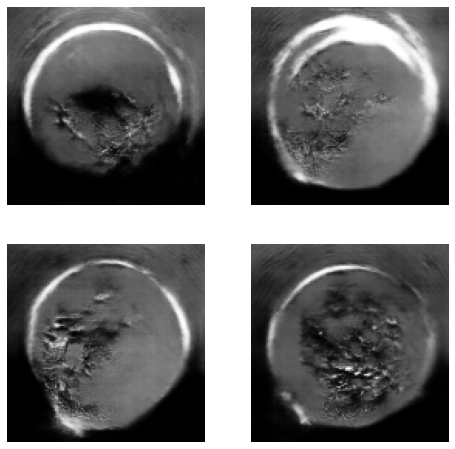

47/47 [==============================] - 25s 523ms/step - d_loss: -791.0672 - g_loss: -1557.8321
Epoch 91/250
47/47 [==============================] - ETA: 0s - d_loss: -875.7380 - g_loss: -2457.3422

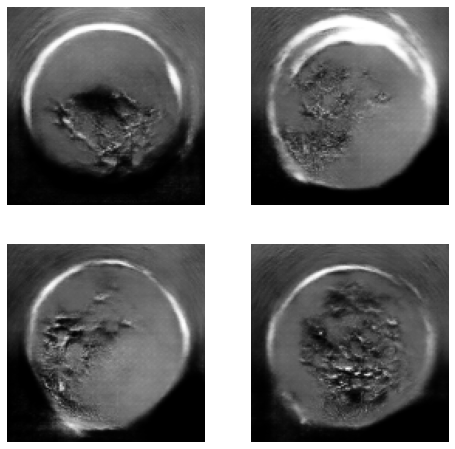

47/47 [==============================] - 26s 541ms/step - d_loss: -891.3019 - g_loss: -2481.0227
Epoch 92/250
47/47 [==============================] - ETA: 0s - d_loss: -965.4053 - g_loss: -2382.5760

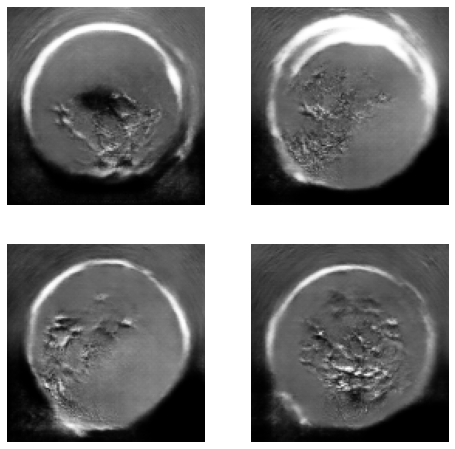

47/47 [==============================] - 25s 527ms/step - d_loss: -980.6590 - g_loss: -2365.1729
Epoch 93/250
47/47 [==============================] - ETA: 0s - d_loss: -935.0501 - g_loss: -2440.7902

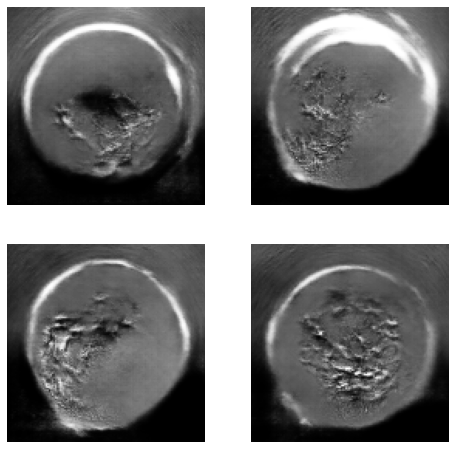

47/47 [==============================] - 26s 535ms/step - d_loss: -945.0370 - g_loss: -2461.1754
Epoch 94/250
47/47 [==============================] - ETA: 0s - d_loss: -919.1510 - g_loss: -2194.2982

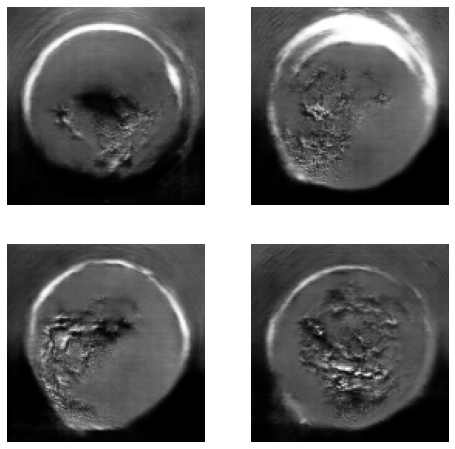

47/47 [==============================] - 26s 533ms/step - d_loss: -932.2869 - g_loss: -2170.0993
Epoch 95/250
47/47 [==============================] - ETA: 0s - d_loss: -645.0559 - g_loss: -1930.6695

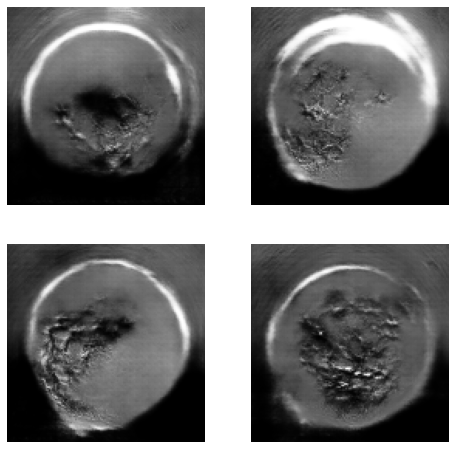

47/47 [==============================] - 26s 530ms/step - d_loss: -648.8512 - g_loss: -1927.0386
Epoch 96/250
47/47 [==============================] - ETA: 0s - d_loss: -802.0039 - g_loss: -1991.4811

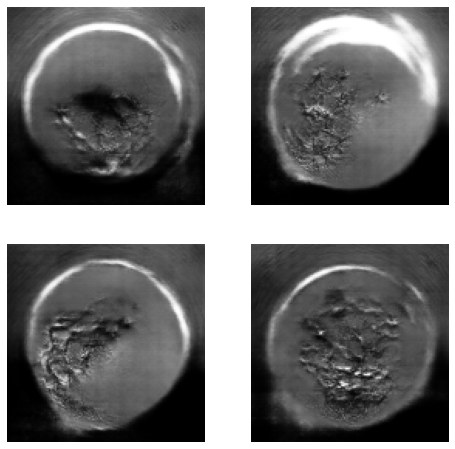

47/47 [==============================] - 26s 538ms/step - d_loss: -829.3582 - g_loss: -1925.9101
Epoch 97/250
47/47 [==============================] - ETA: 0s - d_loss: -943.4520 - g_loss: -2414.1431

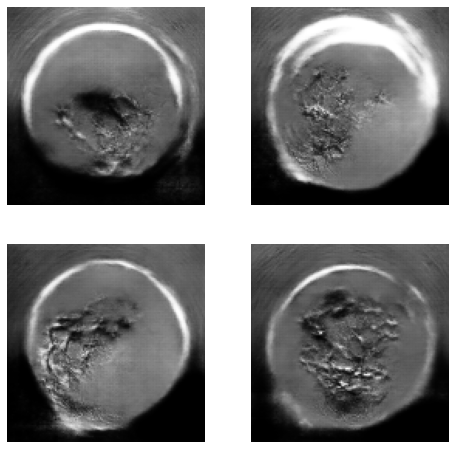

47/47 [==============================] - 26s 531ms/step - d_loss: -959.0105 - g_loss: -2444.3211
Epoch 98/250
47/47 [==============================] - ETA: 0s - d_loss: -778.5734 - g_loss: -2158.6134

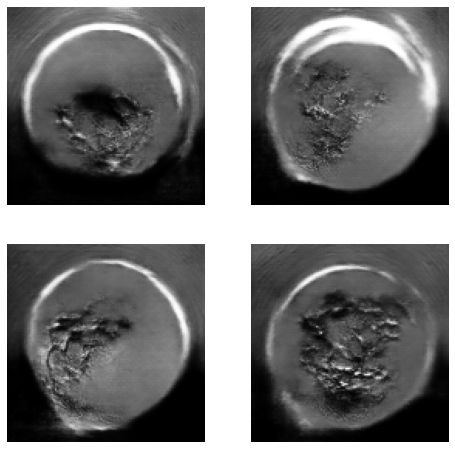

47/47 [==============================] - 26s 535ms/step - d_loss: -780.7894 - g_loss: -2152.0404
Epoch 99/250
47/47 [==============================] - ETA: 0s - d_loss: -673.3841 - g_loss: -2075.6971

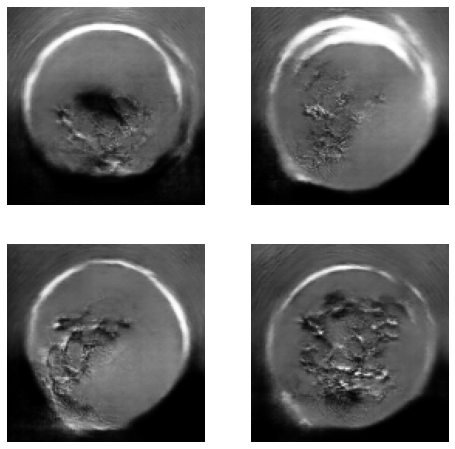

47/47 [==============================] - 26s 538ms/step - d_loss: -681.4155 - g_loss: -2122.7397
Epoch 100/250
47/47 [==============================] - ETA: 0s - d_loss: -618.4280 - g_loss: -1807.7544

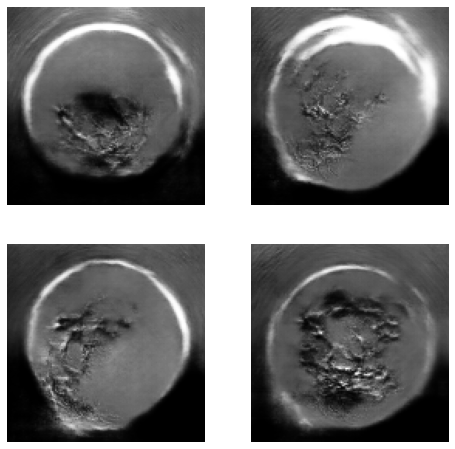

47/47 [==============================] - 26s 537ms/step - d_loss: -624.7529 - g_loss: -1823.9867
Epoch 101/250
47/47 [==============================] - ETA: 0s - d_loss: -663.1800 - g_loss: -1943.8663

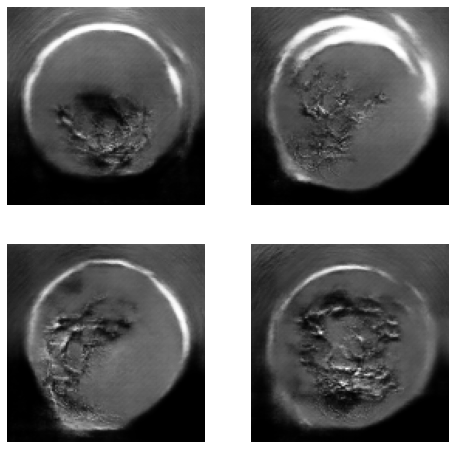

47/47 [==============================] - 25s 526ms/step - d_loss: -673.6569 - g_loss: -1938.5540
Epoch 102/250
47/47 [==============================] - ETA: 0s - d_loss: -643.0045 - g_loss: -2109.4484

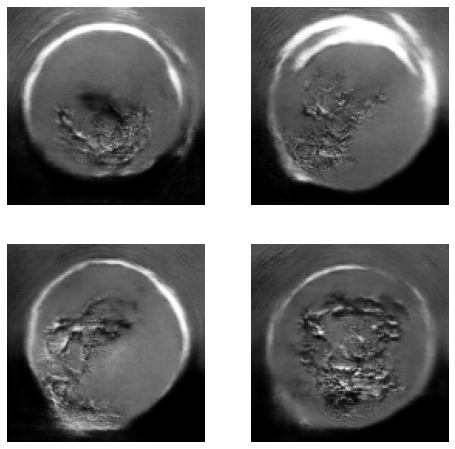

47/47 [==============================] - 26s 542ms/step - d_loss: -640.2638 - g_loss: -2119.7010
Epoch 103/250
47/47 [==============================] - ETA: 0s - d_loss: -665.8758 - g_loss: -1721.5502

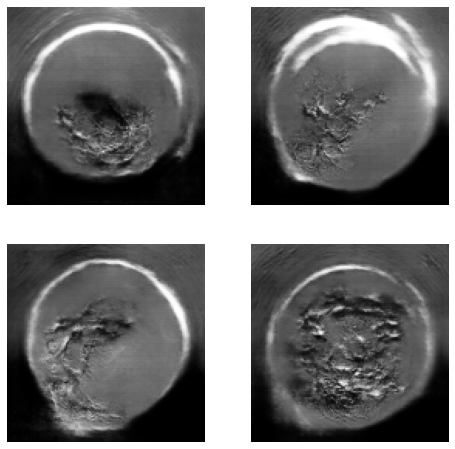

47/47 [==============================] - 25s 525ms/step - d_loss: -677.6932 - g_loss: -1699.8886
Epoch 104/250
47/47 [==============================] - ETA: 0s - d_loss: -710.7593 - g_loss: -1890.6071

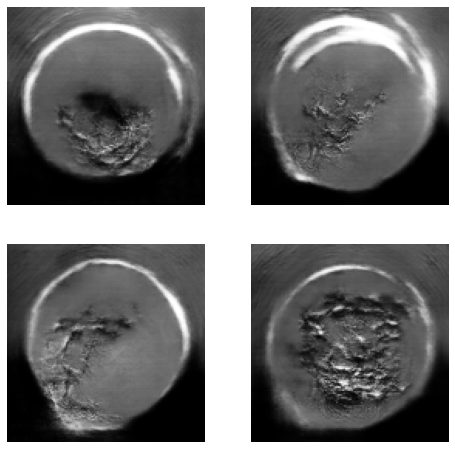

47/47 [==============================] - 26s 541ms/step - d_loss: -713.3812 - g_loss: -1926.7771
Epoch 105/250
47/47 [==============================] - ETA: 0s - d_loss: -743.1538 - g_loss: -1900.4054

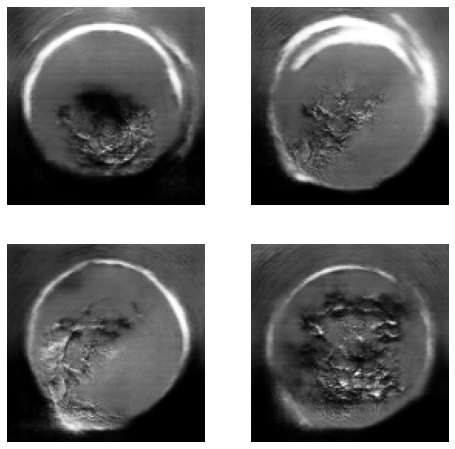

47/47 [==============================] - 25s 527ms/step - d_loss: -762.8904 - g_loss: -1894.6032
Epoch 106/250
47/47 [==============================] - ETA: 0s - d_loss: -809.1921 - g_loss: -2431.6839

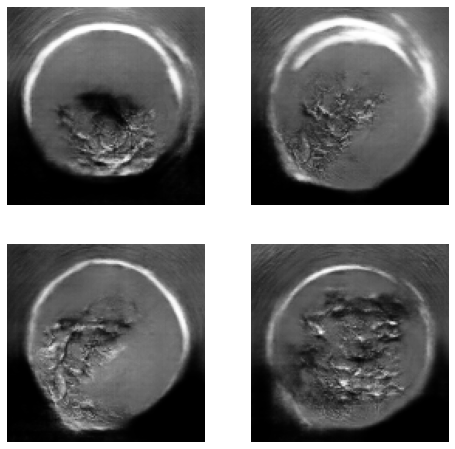

47/47 [==============================] - 26s 542ms/step - d_loss: -833.8349 - g_loss: -2491.6949
Epoch 107/250
47/47 [==============================] - ETA: 0s - d_loss: -568.3746 - g_loss: -2076.1548

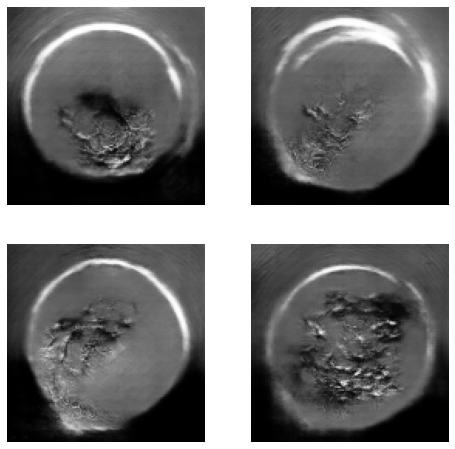

47/47 [==============================] - 26s 533ms/step - d_loss: -576.8577 - g_loss: -2097.9655
Epoch 108/250
47/47 [==============================] - ETA: 0s - d_loss: -641.2139 - g_loss: -1961.0914

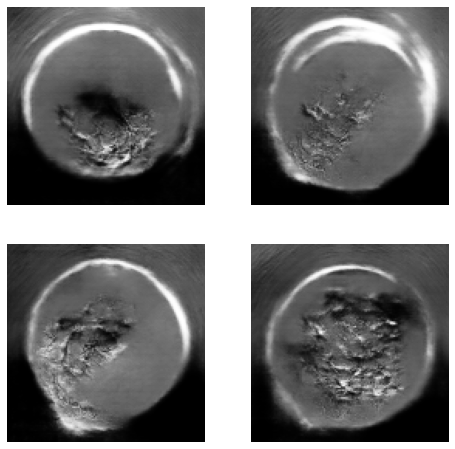

47/47 [==============================] - 25s 524ms/step - d_loss: -646.9200 - g_loss: -1987.3576
Epoch 109/250
47/47 [==============================] - ETA: 0s - d_loss: -583.5241 - g_loss: -1993.6436

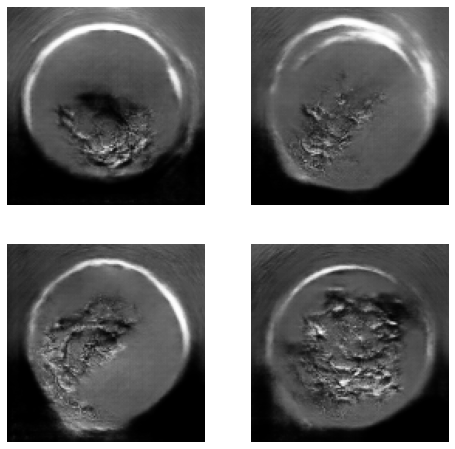

47/47 [==============================] - 26s 530ms/step - d_loss: -599.9991 - g_loss: -2007.8799
Epoch 110/250
47/47 [==============================] - ETA: 0s - d_loss: -716.8382 - g_loss: -2192.1037

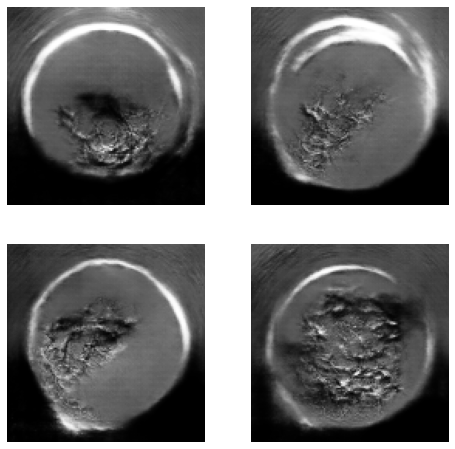

47/47 [==============================] - 26s 540ms/step - d_loss: -726.3365 - g_loss: -2190.9145
Epoch 111/250
47/47 [==============================] - ETA: 0s - d_loss: -568.2863 - g_loss: -2063.1857

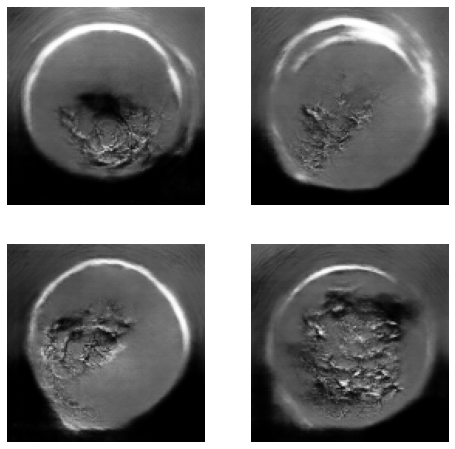

47/47 [==============================] - 25s 524ms/step - d_loss: -568.3337 - g_loss: -2081.7342
Epoch 112/250
47/47 [==============================] - ETA: 0s - d_loss: -531.2848 - g_loss: -1878.3977

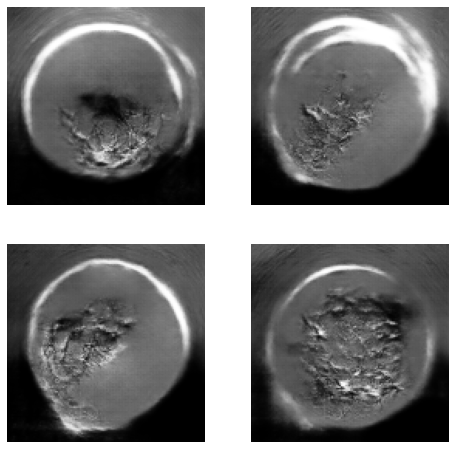

47/47 [==============================] - 26s 550ms/step - d_loss: -544.0028 - g_loss: -1856.5187
Epoch 113/250
47/47 [==============================] - ETA: 0s - d_loss: -765.8201 - g_loss: -2137.9736

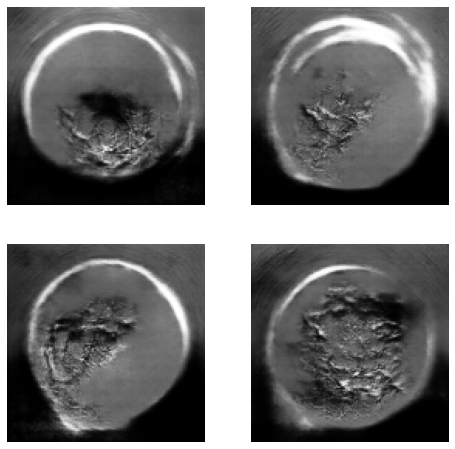

47/47 [==============================] - 25s 528ms/step - d_loss: -773.4793 - g_loss: -2168.0095
Epoch 114/250
47/47 [==============================] - ETA: 0s - d_loss: -765.1934 - g_loss: -2428.9356

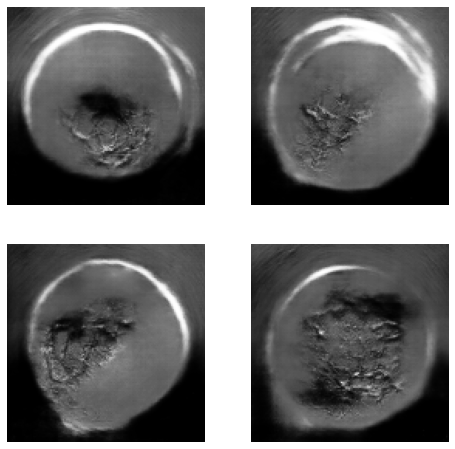

47/47 [==============================] - 26s 535ms/step - d_loss: -751.3266 - g_loss: -2456.6889
Epoch 115/250
47/47 [==============================] - ETA: 0s - d_loss: -612.9156 - g_loss: -2421.5987

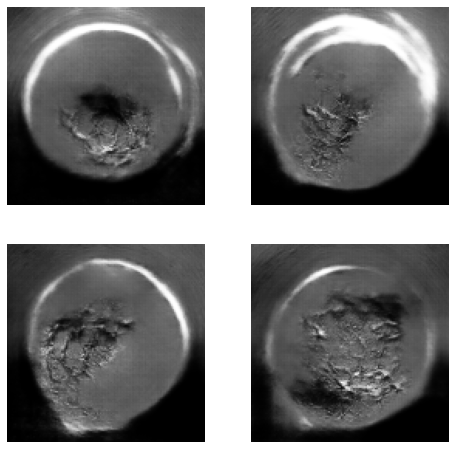

47/47 [==============================] - 26s 536ms/step - d_loss: -620.8699 - g_loss: -2422.2267
Epoch 116/250
47/47 [==============================] - ETA: 0s - d_loss: -597.9529 - g_loss: -2168.1041

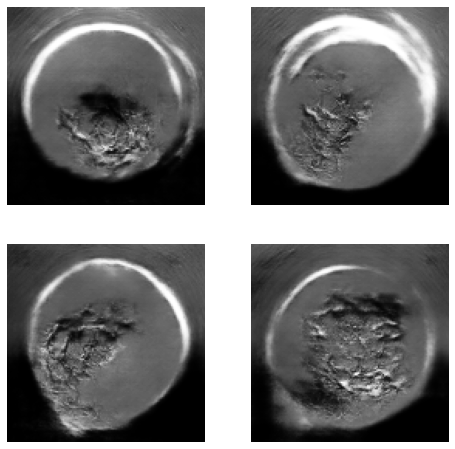

47/47 [==============================] - 26s 532ms/step - d_loss: -608.3274 - g_loss: -2106.4058
Epoch 117/250
47/47 [==============================] - ETA: 0s - d_loss: -740.3107 - g_loss: -2520.9236

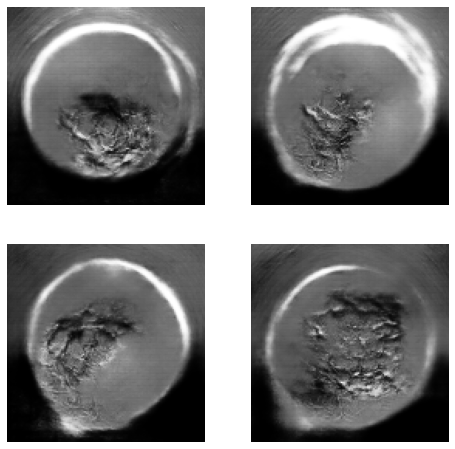

47/47 [==============================] - 26s 536ms/step - d_loss: -752.8841 - g_loss: -2557.3317
Epoch 118/250
47/47 [==============================] - ETA: 0s - d_loss: -662.5091 - g_loss: -2495.5211

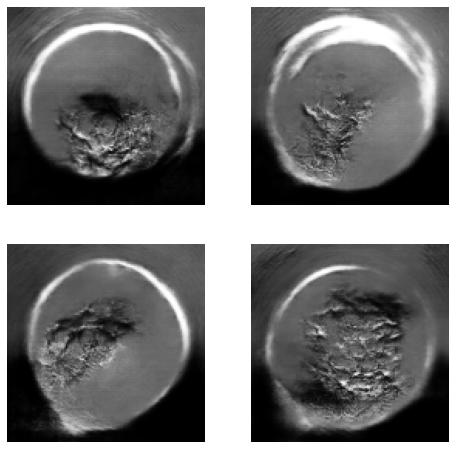

47/47 [==============================] - 26s 526ms/step - d_loss: -668.3594 - g_loss: -2479.8970
Epoch 119/250
47/47 [==============================] - ETA: 0s - d_loss: -547.4137 - g_loss: -2370.2442

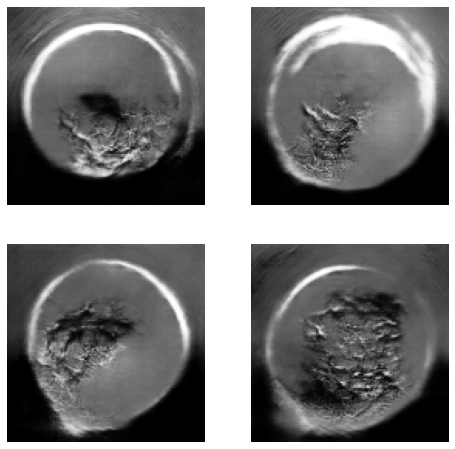

47/47 [==============================] - 26s 529ms/step - d_loss: -553.9149 - g_loss: -2343.8350
Epoch 120/250
47/47 [==============================] - ETA: 0s - d_loss: -581.5563 - g_loss: -2243.1269

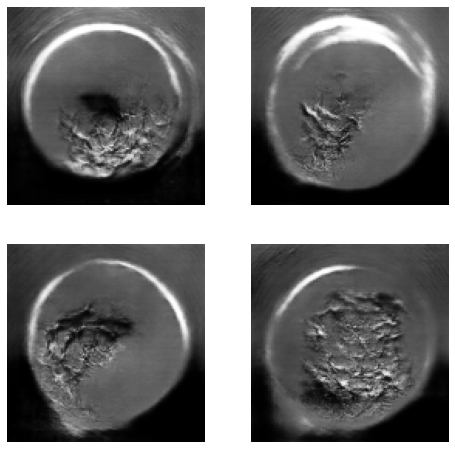

47/47 [==============================] - 26s 543ms/step - d_loss: -589.6996 - g_loss: -2234.0854
Epoch 121/250
47/47 [==============================] - ETA: 0s - d_loss: -436.8031 - g_loss: -1923.8605

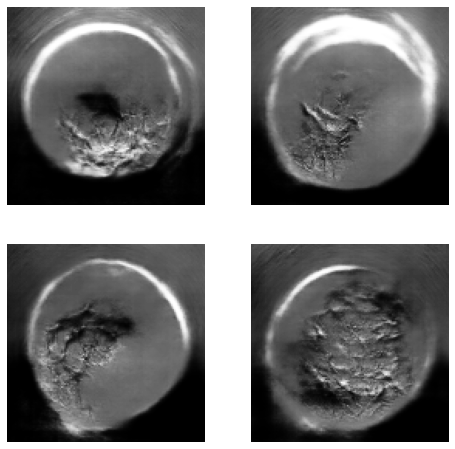

47/47 [==============================] - 25s 526ms/step - d_loss: -447.9443 - g_loss: -1923.7125
Epoch 122/250
47/47 [==============================] - ETA: 0s - d_loss: -561.2114 - g_loss: -2064.8040

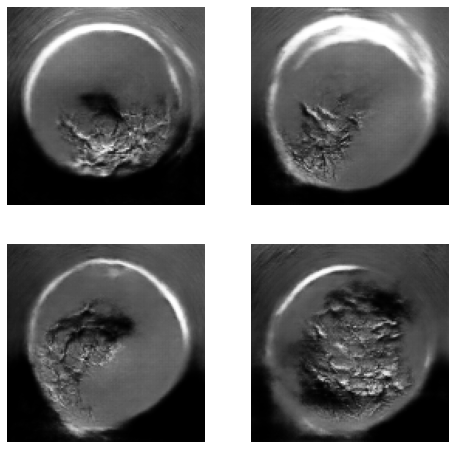

47/47 [==============================] - 26s 543ms/step - d_loss: -565.4301 - g_loss: -2066.0586
Epoch 123/250
47/47 [==============================] - ETA: 0s - d_loss: -550.3869 - g_loss: -2033.2033

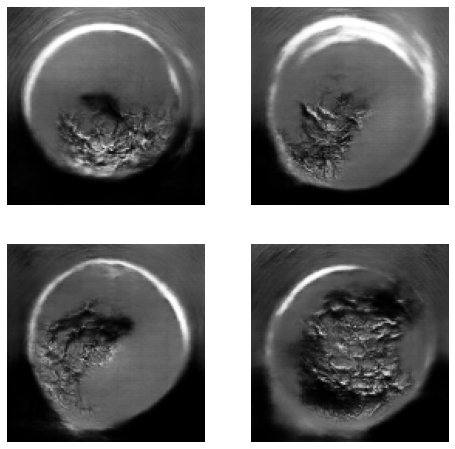

47/47 [==============================] - 26s 529ms/step - d_loss: -553.7994 - g_loss: -2034.4682
Epoch 124/250
47/47 [==============================] - ETA: 0s - d_loss: -602.9871 - g_loss: -2204.2736

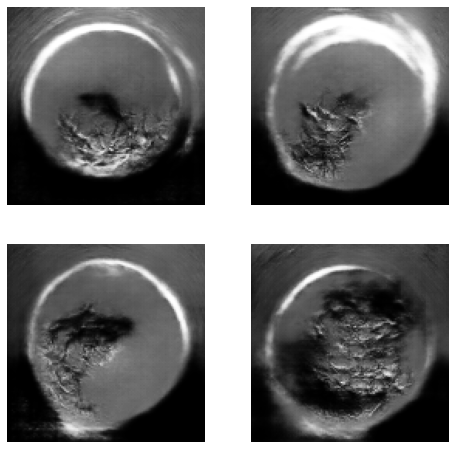

47/47 [==============================] - 26s 525ms/step - d_loss: -634.2300 - g_loss: -2210.7613
Epoch 125/250
47/47 [==============================] - ETA: 0s - d_loss: -647.1740 - g_loss: -2517.5883

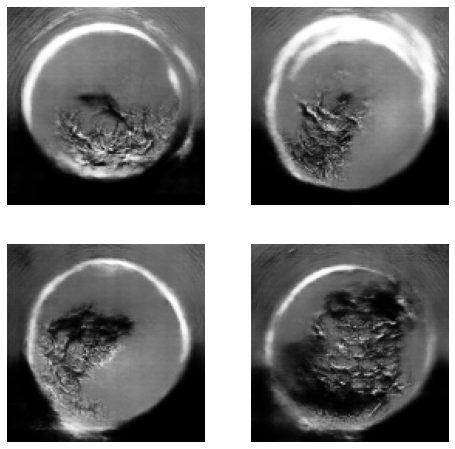

47/47 [==============================] - 26s 539ms/step - d_loss: -644.2928 - g_loss: -2557.4038
Epoch 126/250
47/47 [==============================] - ETA: 0s - d_loss: -667.7371 - g_loss: -2489.3850

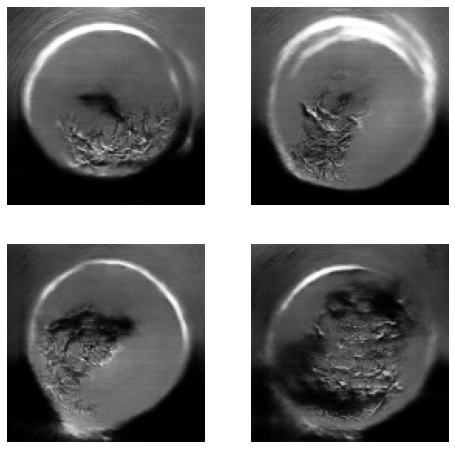

47/47 [==============================] - 26s 533ms/step - d_loss: -675.9619 - g_loss: -2499.0644
Epoch 127/250
47/47 [==============================] - ETA: 0s - d_loss: -429.1283 - g_loss: -2530.7265

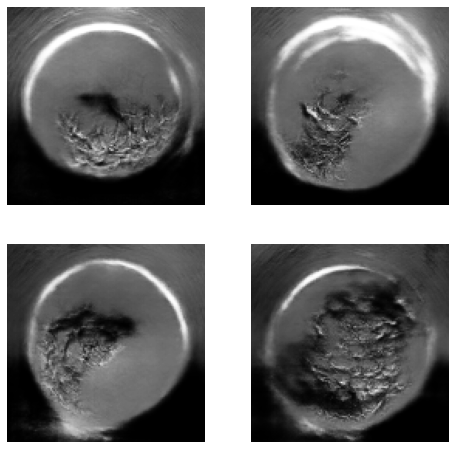

47/47 [==============================] - 25s 527ms/step - d_loss: -440.4905 - g_loss: -2545.3676
Epoch 128/250
47/47 [==============================] - ETA: 0s - d_loss: -457.9149 - g_loss: -2269.7451

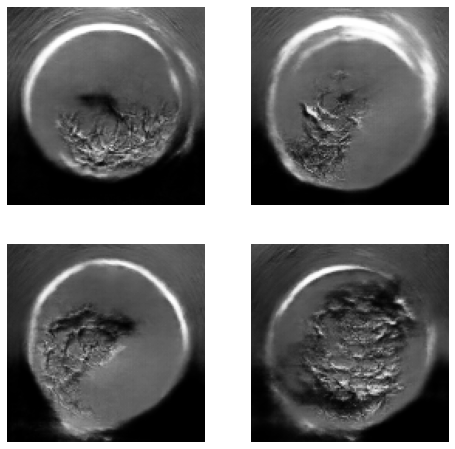

47/47 [==============================] - 26s 542ms/step - d_loss: -456.5622 - g_loss: -2275.6012
Epoch 129/250
47/47 [==============================] - ETA: 0s - d_loss: -616.7804 - g_loss: -2409.9775

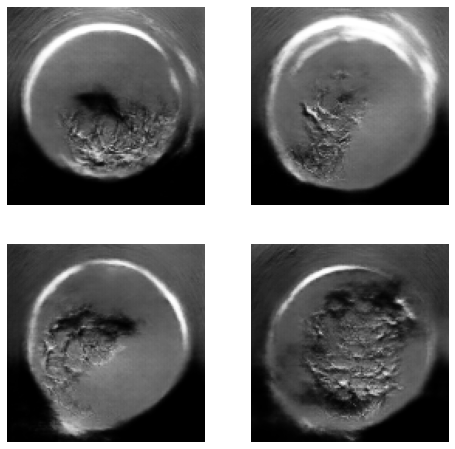

47/47 [==============================] - 26s 529ms/step - d_loss: -622.9718 - g_loss: -2418.5705
Epoch 130/250
47/47 [==============================] - ETA: 0s - d_loss: -575.5996 - g_loss: -2393.5020

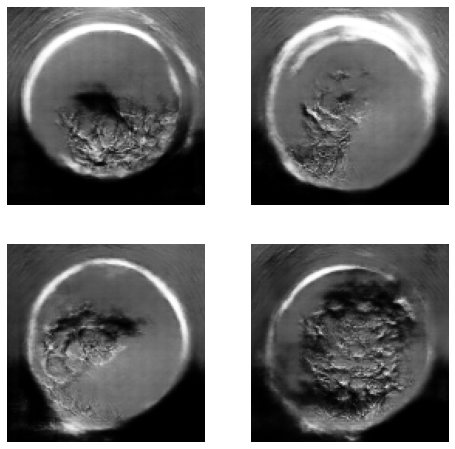

47/47 [==============================] - 26s 534ms/step - d_loss: -580.7872 - g_loss: -2383.1467
Epoch 131/250
47/47 [==============================] - ETA: 0s - d_loss: -532.0532 - g_loss: -2525.3343

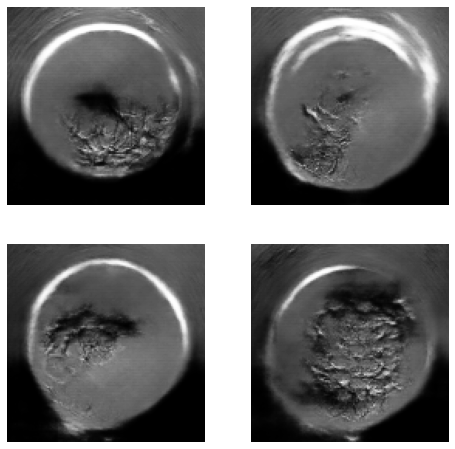

47/47 [==============================] - 26s 534ms/step - d_loss: -546.5499 - g_loss: -2535.4911
Epoch 132/250
47/47 [==============================] - ETA: 0s - d_loss: -643.9028 - g_loss: -2399.1632

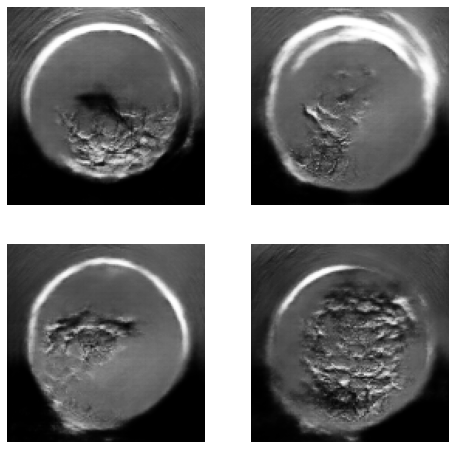

47/47 [==============================] - 26s 534ms/step - d_loss: -644.7031 - g_loss: -2424.4873
Epoch 133/250
47/47 [==============================] - ETA: 0s - d_loss: -541.6725 - g_loss: -2549.1566

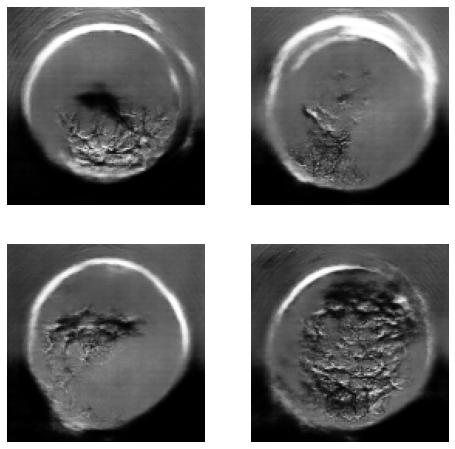

47/47 [==============================] - 26s 536ms/step - d_loss: -546.6177 - g_loss: -2515.7515
Epoch 134/250
47/47 [==============================] - ETA: 0s - d_loss: -510.6536 - g_loss: -2594.1326

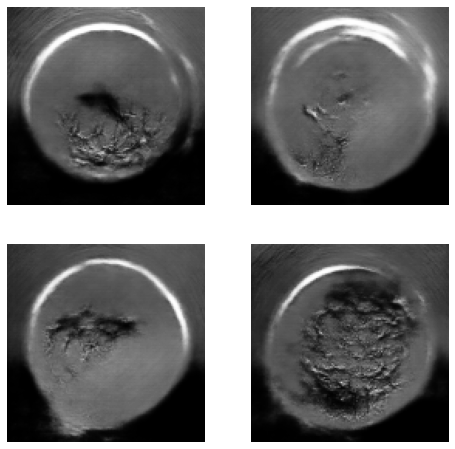

47/47 [==============================] - 26s 526ms/step - d_loss: -509.3378 - g_loss: -2630.7189
Epoch 135/250
47/47 [==============================] - ETA: 0s - d_loss: -514.8228 - g_loss: -2349.0092

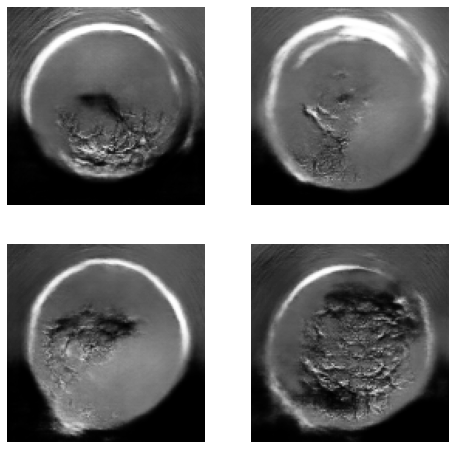

47/47 [==============================] - 26s 529ms/step - d_loss: -515.8852 - g_loss: -2333.6537
Epoch 136/250
47/47 [==============================] - ETA: 0s - d_loss: -332.8722 - g_loss: -2202.5945

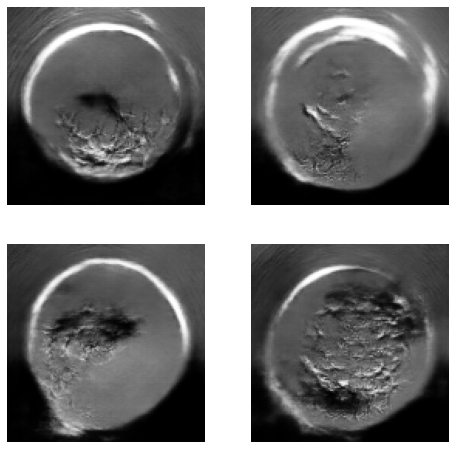

47/47 [==============================] - 26s 531ms/step - d_loss: -340.9047 - g_loss: -2186.5920
Epoch 137/250
47/47 [==============================] - ETA: 0s - d_loss: -526.4566 - g_loss: -2379.3961

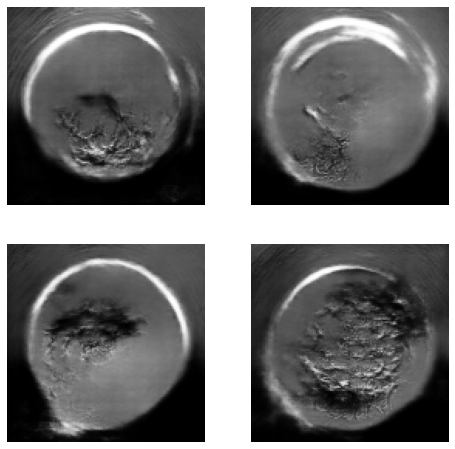

47/47 [==============================] - 26s 538ms/step - d_loss: -544.1847 - g_loss: -2422.4594
Epoch 138/250
47/47 [==============================] - ETA: 0s - d_loss: -481.9337 - g_loss: -2517.9142

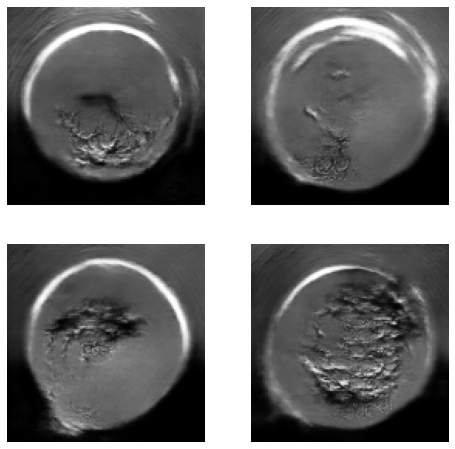

47/47 [==============================] - 26s 531ms/step - d_loss: -481.5106 - g_loss: -2533.6114
Epoch 139/250
47/47 [==============================] - ETA: 0s - d_loss: -511.3339 - g_loss: -2321.3860

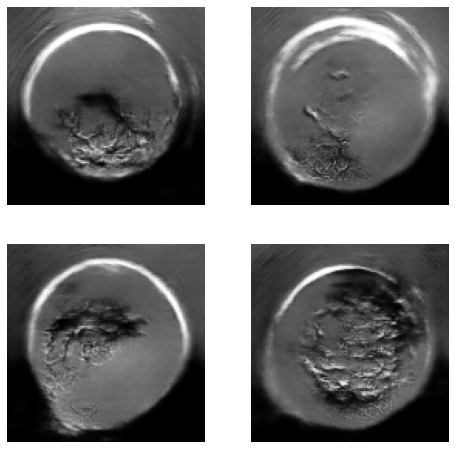

47/47 [==============================] - 26s 527ms/step - d_loss: -517.6949 - g_loss: -2312.1756
Epoch 140/250
47/47 [==============================] - ETA: 0s - d_loss: -481.8032 - g_loss: -2339.8113

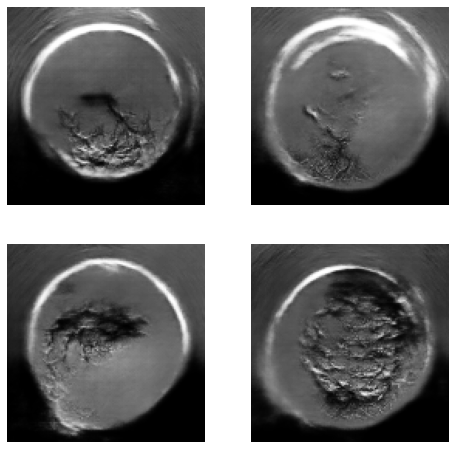

47/47 [==============================] - 26s 533ms/step - d_loss: -489.9436 - g_loss: -2358.6145
Epoch 141/250
47/47 [==============================] - ETA: 0s - d_loss: -510.5181 - g_loss: -2359.9130

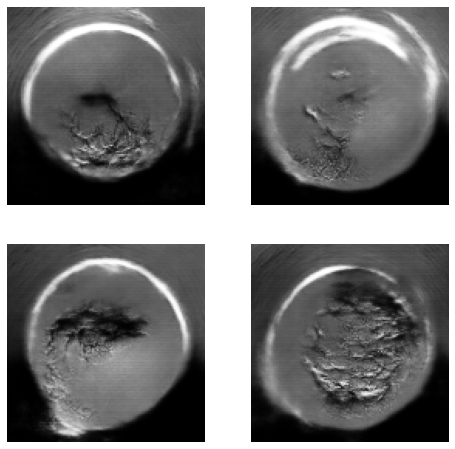

47/47 [==============================] - 26s 540ms/step - d_loss: -518.7486 - g_loss: -2368.0429
Epoch 142/250
47/47 [==============================] - ETA: 0s - d_loss: -484.3501 - g_loss: -2519.3739

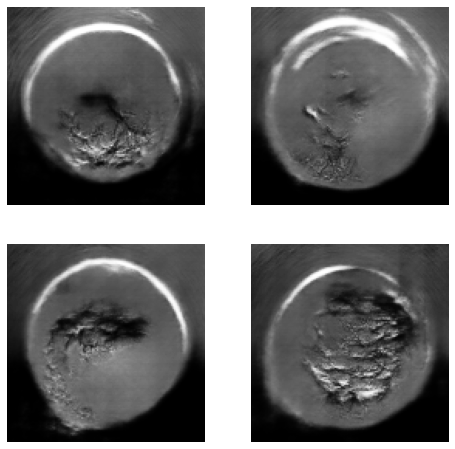

47/47 [==============================] - 26s 525ms/step - d_loss: -489.5184 - g_loss: -2510.0661
Epoch 143/250
47/47 [==============================] - ETA: 0s - d_loss: -486.8377 - g_loss: -1967.7385

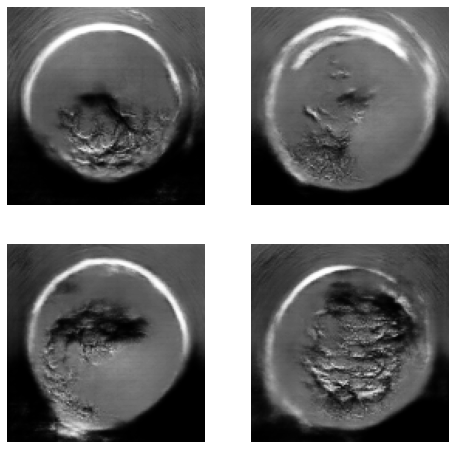

47/47 [==============================] - 26s 531ms/step - d_loss: -490.4248 - g_loss: -2004.0882
Epoch 144/250
47/47 [==============================] - ETA: 0s - d_loss: -505.4711 - g_loss: -2155.0169

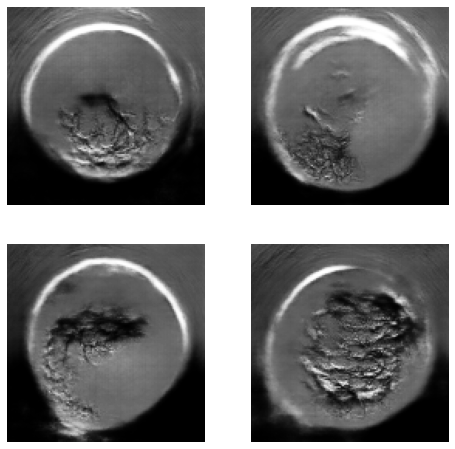

47/47 [==============================] - 26s 541ms/step - d_loss: -515.5014 - g_loss: -2208.8235
Epoch 145/250
47/47 [==============================] - ETA: 0s - d_loss: -405.5365 - g_loss: -2391.7668

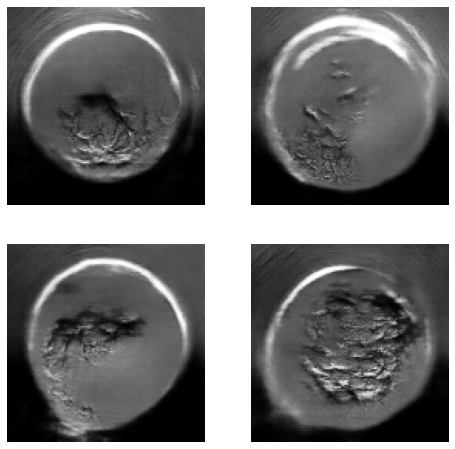

47/47 [==============================] - 25s 524ms/step - d_loss: -409.3536 - g_loss: -2445.6140
Epoch 146/250
47/47 [==============================] - ETA: 0s - d_loss: -403.6426 - g_loss: -2326.2512

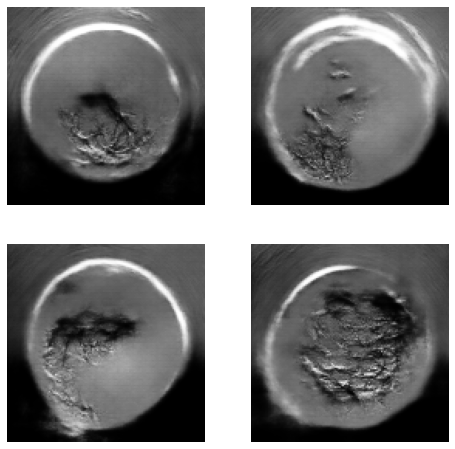

47/47 [==============================] - 26s 543ms/step - d_loss: -410.9344 - g_loss: -2375.4709
Epoch 147/250
47/47 [==============================] - ETA: 0s - d_loss: -434.1766 - g_loss: -2636.9327

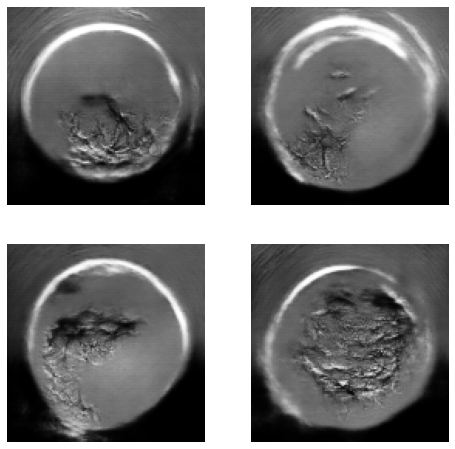

47/47 [==============================] - 26s 530ms/step - d_loss: -439.8829 - g_loss: -2688.4175
Epoch 148/250
47/47 [==============================] - ETA: 0s - d_loss: -402.5567 - g_loss: -2500.3058

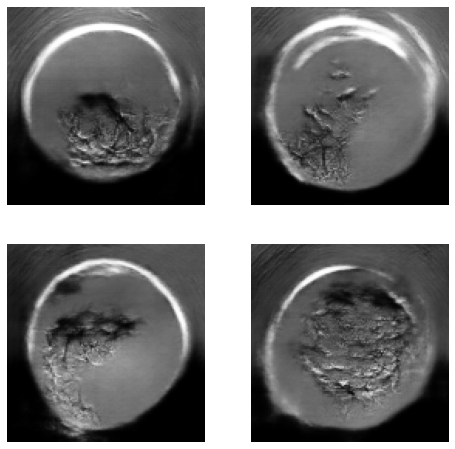

47/47 [==============================] - 26s 537ms/step - d_loss: -410.6795 - g_loss: -2514.9946
Epoch 149/250
47/47 [==============================] - ETA: 0s - d_loss: -432.5434 - g_loss: -2272.8422

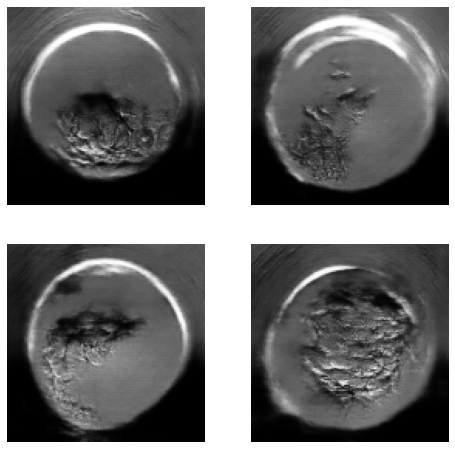

47/47 [==============================] - 26s 533ms/step - d_loss: -443.6490 - g_loss: -2288.4801
Epoch 150/250
47/47 [==============================] - ETA: 0s - d_loss: -398.3953 - g_loss: -2158.8092

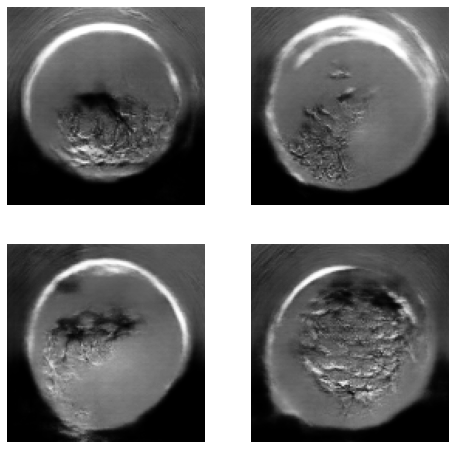

47/47 [==============================] - 26s 536ms/step - d_loss: -403.2616 - g_loss: -2163.2504
Epoch 151/250
47/47 [==============================] - ETA: 0s - d_loss: -352.5897 - g_loss: -2143.1201

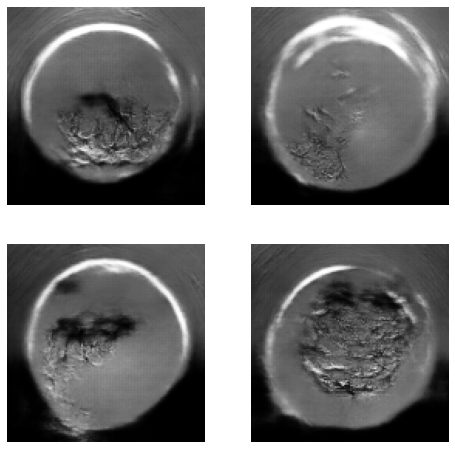

47/47 [==============================] - 26s 530ms/step - d_loss: -354.6976 - g_loss: -2129.6827
Epoch 152/250
47/47 [==============================] - ETA: 0s - d_loss: -382.6824 - g_loss: -1867.3962

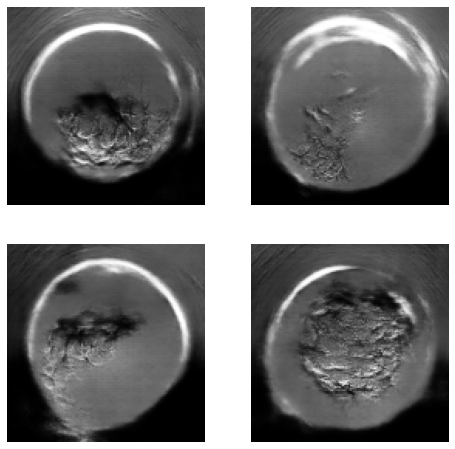

47/47 [==============================] - 26s 544ms/step - d_loss: -388.1825 - g_loss: -1866.6755
Epoch 153/250
47/47 [==============================] - ETA: 0s - d_loss: -381.7850 - g_loss: -2174.0444

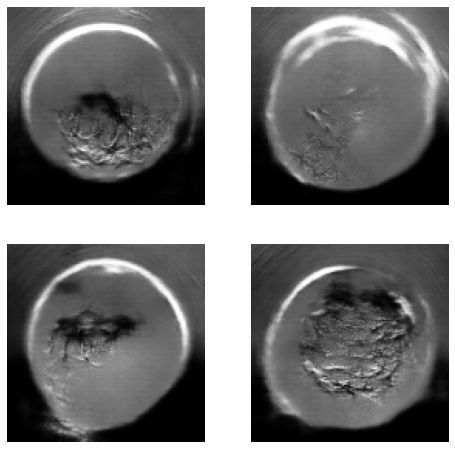

47/47 [==============================] - 26s 528ms/step - d_loss: -395.3878 - g_loss: -2248.5546
Epoch 154/250
47/47 [==============================] - ETA: 0s - d_loss: -445.9095 - g_loss: -2230.9052

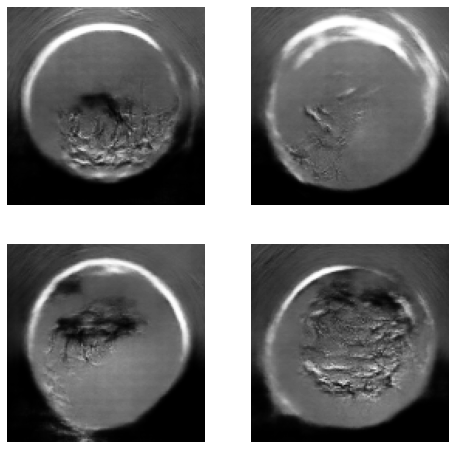

47/47 [==============================] - 26s 528ms/step - d_loss: -458.3690 - g_loss: -2244.8390
Epoch 155/250
47/47 [==============================] - ETA: 0s - d_loss: -407.2951 - g_loss: -2492.2970

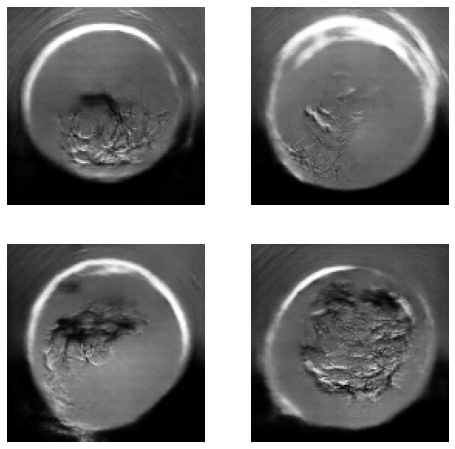

47/47 [==============================] - 26s 532ms/step - d_loss: -412.8105 - g_loss: -2501.4060
Epoch 156/250
47/47 [==============================] - ETA: 0s - d_loss: -382.3425 - g_loss: -2184.6098

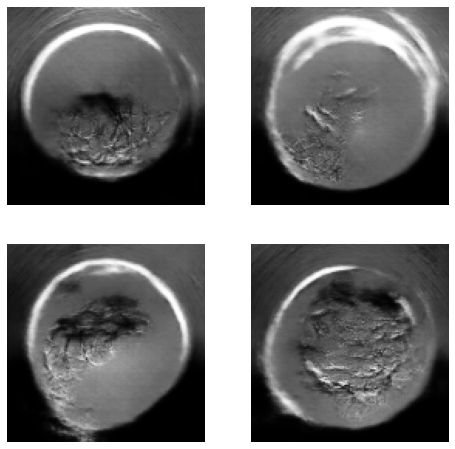

47/47 [==============================] - 26s 532ms/step - d_loss: -385.6786 - g_loss: -2184.4213
Epoch 157/250
47/47 [==============================] - ETA: 0s - d_loss: -372.5211 - g_loss: -2528.5112

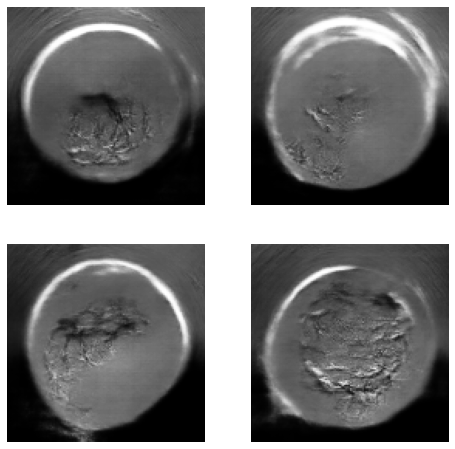

47/47 [==============================] - 26s 528ms/step - d_loss: -384.4749 - g_loss: -2548.9770
Epoch 158/250
47/47 [==============================] - ETA: 0s - d_loss: -392.3074 - g_loss: -2226.9516

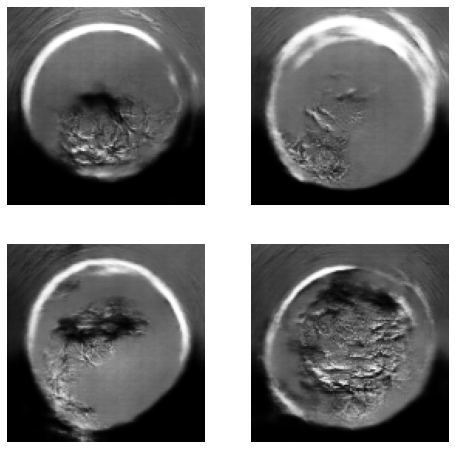

47/47 [==============================] - 27s 545ms/step - d_loss: -392.6061 - g_loss: -2219.4505
Epoch 159/250
47/47 [==============================] - ETA: 0s - d_loss: -399.4559 - g_loss: -1933.6432

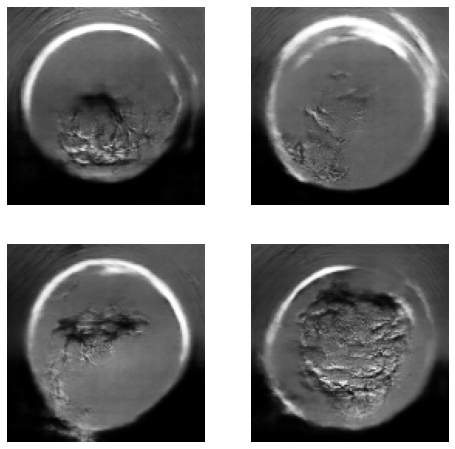

47/47 [==============================] - 26s 527ms/step - d_loss: -403.1369 - g_loss: -1910.5869
Epoch 160/250
47/47 [==============================] - ETA: 0s - d_loss: -305.4299 - g_loss: -2312.0517

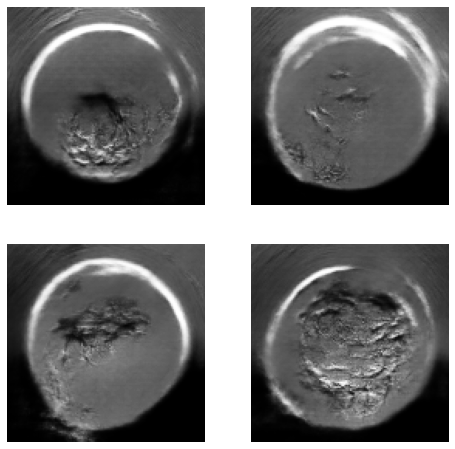

47/47 [==============================] - 26s 542ms/step - d_loss: -316.8910 - g_loss: -2240.1251
Epoch 161/250
47/47 [==============================] - ETA: 0s - d_loss: -406.1036 - g_loss: -2514.8942

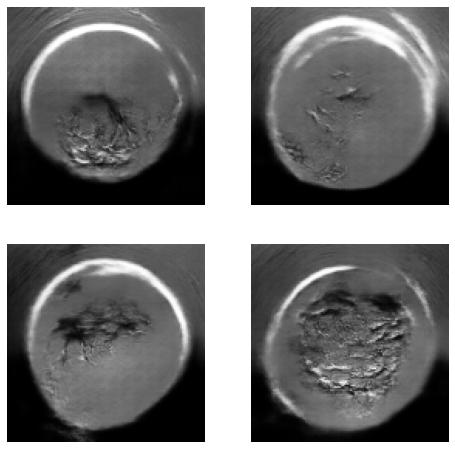

47/47 [==============================] - 26s 532ms/step - d_loss: -417.5809 - g_loss: -2492.1778
Epoch 162/250
47/47 [==============================] - ETA: 0s - d_loss: -382.7144 - g_loss: -2220.8930

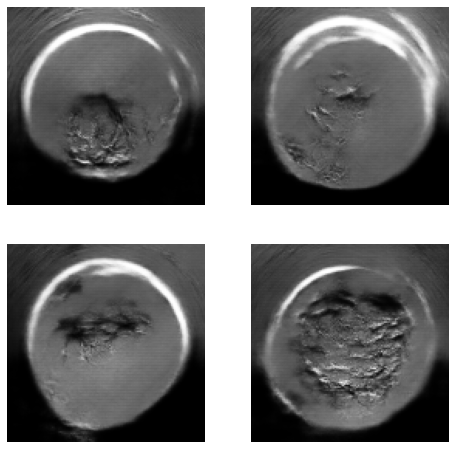

47/47 [==============================] - 25s 525ms/step - d_loss: -388.3506 - g_loss: -2190.9905
Epoch 163/250
47/47 [==============================] - ETA: 0s - d_loss: -441.4834 - g_loss: -2501.7674

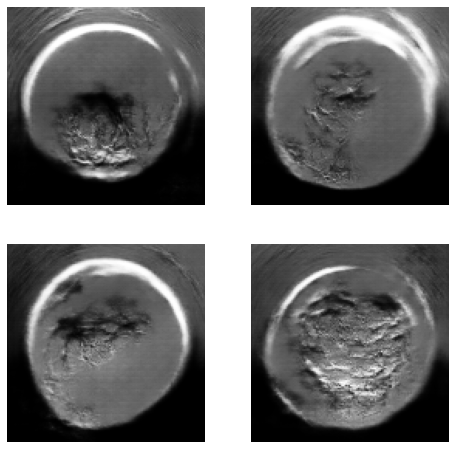

47/47 [==============================] - 27s 544ms/step - d_loss: -443.8258 - g_loss: -2505.1748
Epoch 164/250
47/47 [==============================] - ETA: 0s - d_loss: -421.3995 - g_loss: -2113.5878

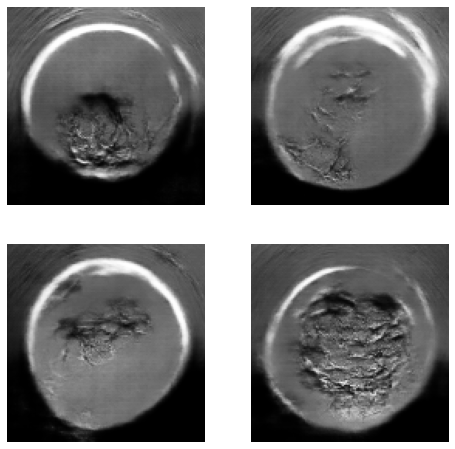

47/47 [==============================] - 26s 531ms/step - d_loss: -434.6433 - g_loss: -2101.3181
Epoch 165/250
47/47 [==============================] - ETA: 0s - d_loss: -384.0252 - g_loss: -2211.3446

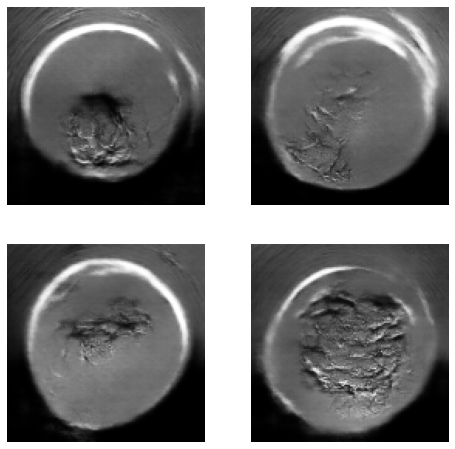

47/47 [==============================] - 26s 525ms/step - d_loss: -397.8785 - g_loss: -2197.3060
Epoch 166/250
47/47 [==============================] - ETA: 0s - d_loss: -405.9290 - g_loss: -2144.2300

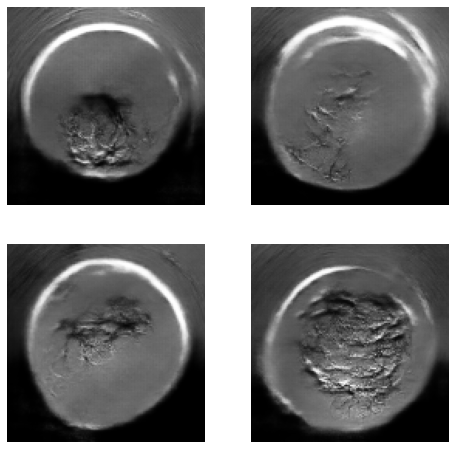

47/47 [==============================] - 26s 533ms/step - d_loss: -410.1460 - g_loss: -2165.6147
Epoch 167/250
47/47 [==============================] - ETA: 0s - d_loss: -399.2303 - g_loss: -2292.6799

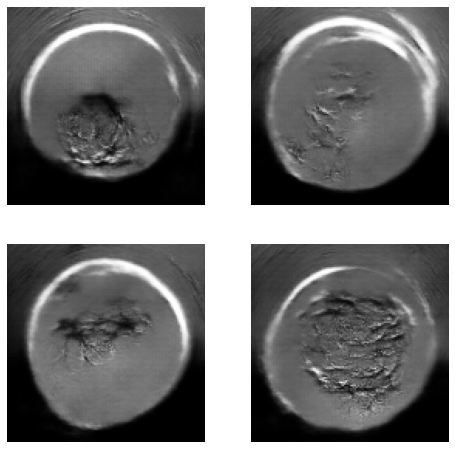

47/47 [==============================] - 26s 538ms/step - d_loss: -420.5793 - g_loss: -2372.7156
Epoch 168/250
47/47 [==============================] - ETA: 0s - d_loss: -389.5300 - g_loss: -2048.2614

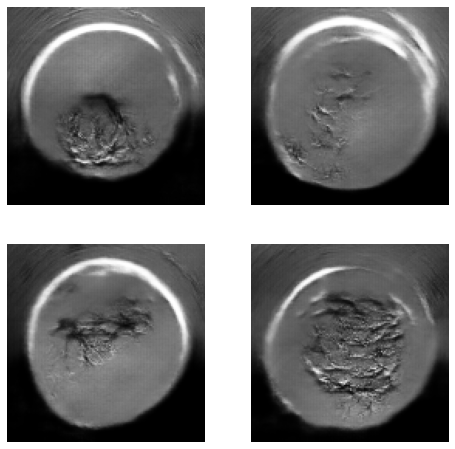

47/47 [==============================] - 25s 526ms/step - d_loss: -393.3061 - g_loss: -2080.0262
Epoch 169/250
47/47 [==============================] - ETA: 0s - d_loss: -382.6057 - g_loss: -2070.3649

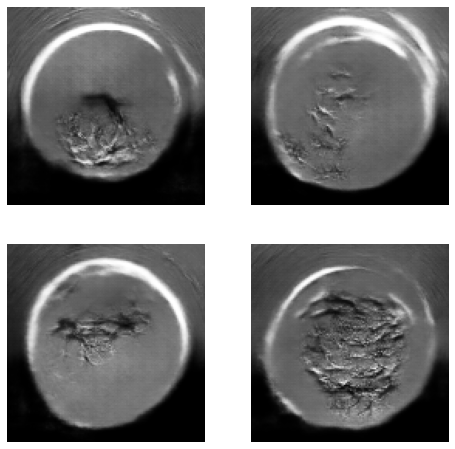

47/47 [==============================] - 26s 543ms/step - d_loss: -389.8039 - g_loss: -2118.4734
Epoch 170/250
47/47 [==============================] - ETA: 0s - d_loss: -368.1451 - g_loss: -2177.5974

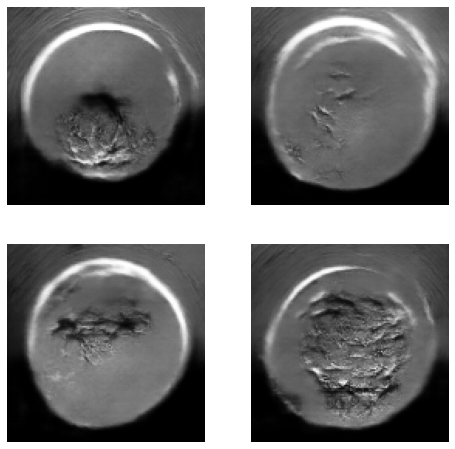

47/47 [==============================] - 26s 527ms/step - d_loss: -371.7788 - g_loss: -2146.7105
Epoch 171/250
47/47 [==============================] - ETA: 0s - d_loss: -372.8219 - g_loss: -2057.0654

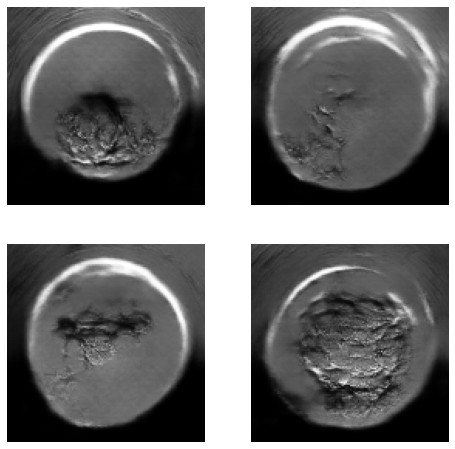

47/47 [==============================] - 25s 526ms/step - d_loss: -375.4871 - g_loss: -2103.1222
Epoch 172/250
47/47 [==============================] - ETA: 0s - d_loss: -362.8085 - g_loss: -2018.3201

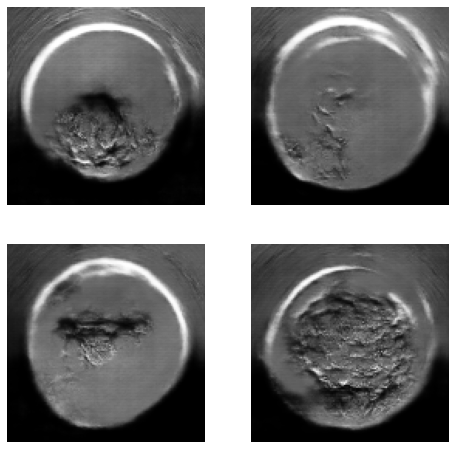

47/47 [==============================] - 26s 543ms/step - d_loss: -368.8193 - g_loss: -2018.3653
Epoch 173/250
47/47 [==============================] - ETA: 0s - d_loss: -372.7399 - g_loss: -2330.2911

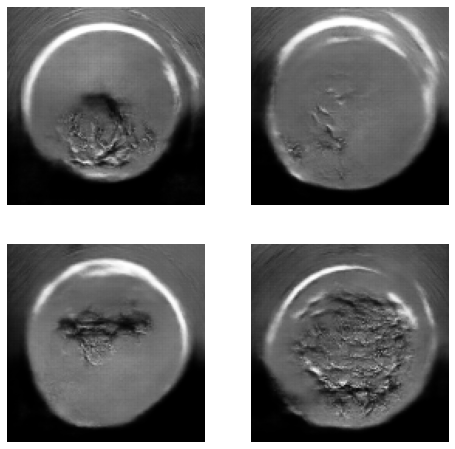

47/47 [==============================] - 25s 526ms/step - d_loss: -377.2560 - g_loss: -2336.5088
Epoch 174/250
47/47 [==============================] - ETA: 0s - d_loss: -414.5216 - g_loss: -2268.7348

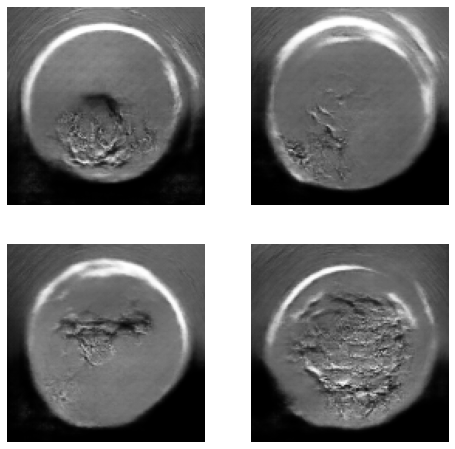

47/47 [==============================] - 26s 543ms/step - d_loss: -424.9963 - g_loss: -2297.4529
Epoch 175/250
47/47 [==============================] - ETA: 0s - d_loss: -421.4166 - g_loss: -2109.8569

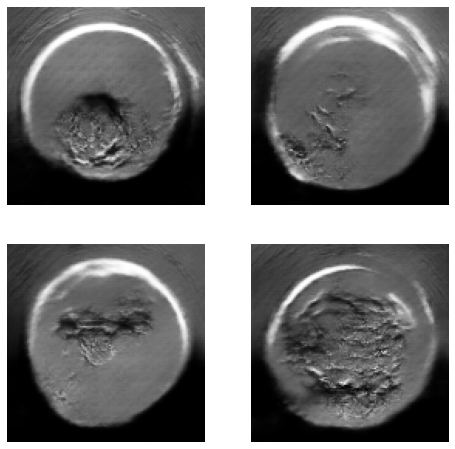

47/47 [==============================] - 26s 533ms/step - d_loss: -429.0632 - g_loss: -2162.9804
Epoch 176/250
47/47 [==============================] - ETA: 0s - d_loss: -402.2300 - g_loss: -2387.0661

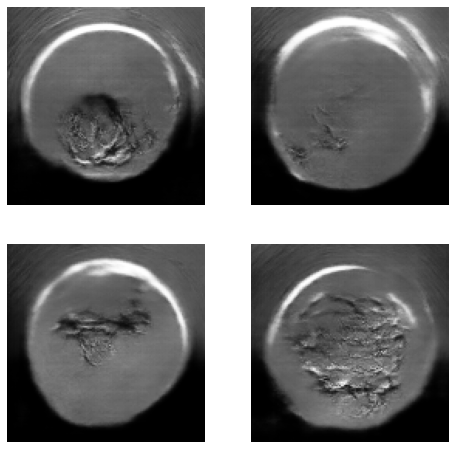

47/47 [==============================] - 26s 536ms/step - d_loss: -415.2243 - g_loss: -2455.9039
Epoch 177/250
47/47 [==============================] - ETA: 0s - d_loss: -396.3570 - g_loss: -2178.2418

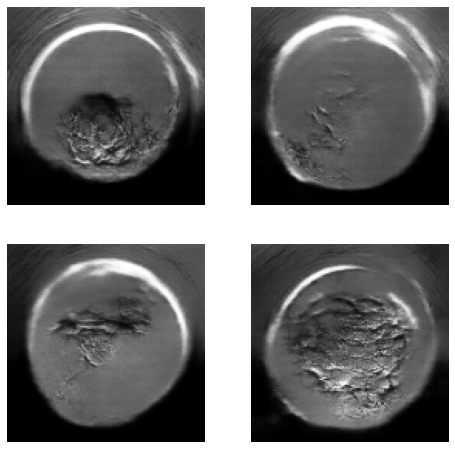

47/47 [==============================] - 26s 543ms/step - d_loss: -406.1263 - g_loss: -2212.9859
Epoch 178/250
47/47 [==============================] - ETA: 0s - d_loss: -421.4295 - g_loss: -2528.6626

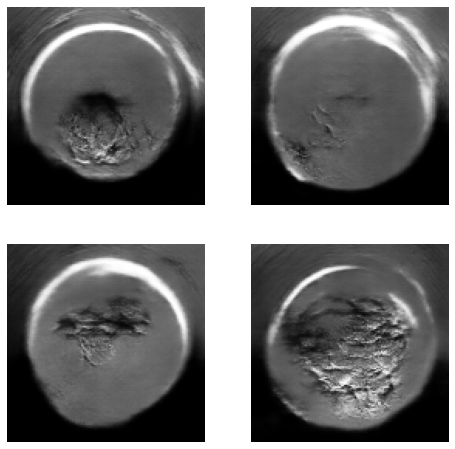

47/47 [==============================] - 26s 525ms/step - d_loss: -419.4748 - g_loss: -2529.8071
Epoch 179/250
47/47 [==============================] - ETA: 0s - d_loss: -378.1387 - g_loss: -1763.7279

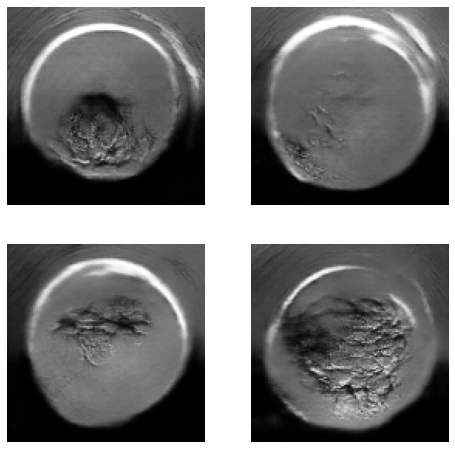

47/47 [==============================] - 26s 528ms/step - d_loss: -380.4113 - g_loss: -1751.2047
Epoch 180/250
47/47 [==============================] - ETA: 0s - d_loss: -378.7683 - g_loss: -2201.6200

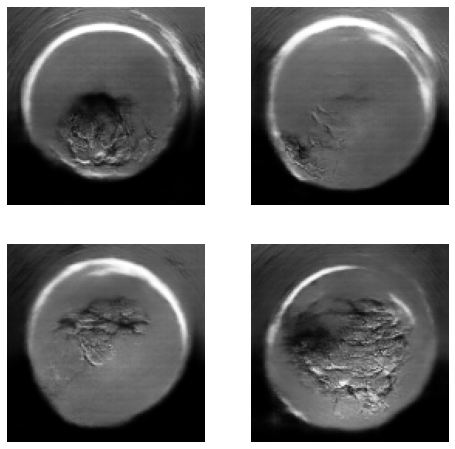

47/47 [==============================] - 26s 533ms/step - d_loss: -394.8801 - g_loss: -2219.9495
Epoch 181/250
47/47 [==============================] - ETA: 0s - d_loss: -336.0050 - g_loss: -2069.1545

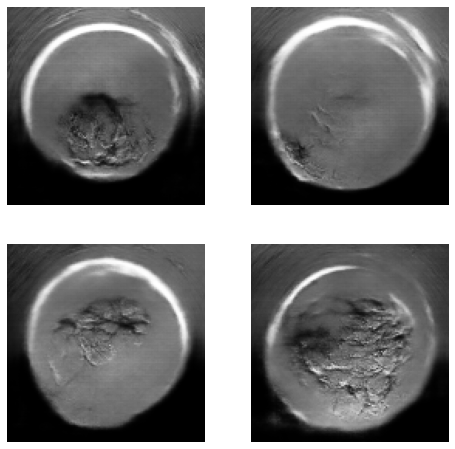

47/47 [==============================] - 26s 542ms/step - d_loss: -333.6465 - g_loss: -2076.1329
Epoch 182/250
47/47 [==============================] - ETA: 0s - d_loss: -382.7451 - g_loss: -2188.9757

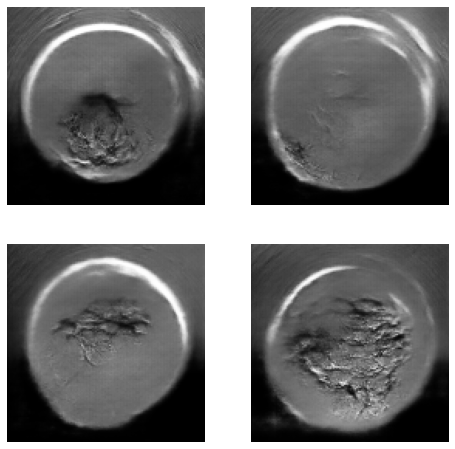

47/47 [==============================] - 25s 525ms/step - d_loss: -391.7110 - g_loss: -2235.3267
Epoch 183/250
47/47 [==============================] - ETA: 0s - d_loss: -325.5462 - g_loss: -1911.7049

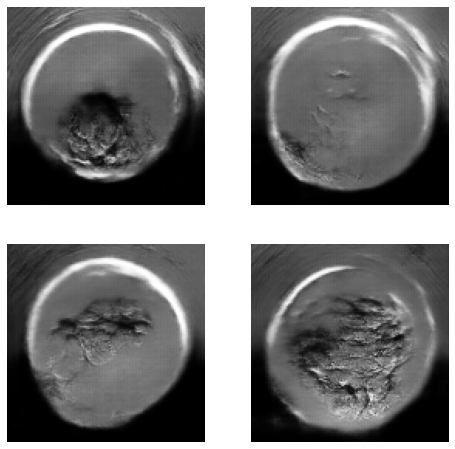

47/47 [==============================] - 26s 546ms/step - d_loss: -329.3640 - g_loss: -1924.3803
Epoch 184/250
47/47 [==============================] - ETA: 0s - d_loss: -342.5874 - g_loss: -2174.7732

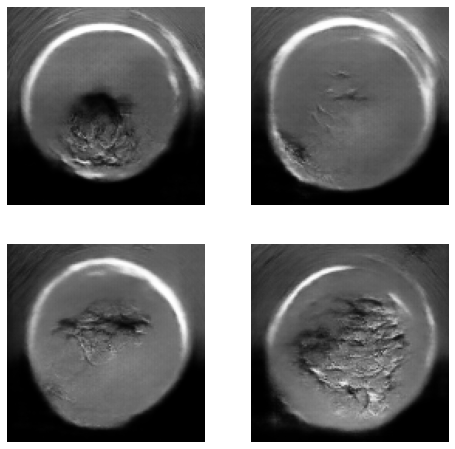

47/47 [==============================] - 26s 532ms/step - d_loss: -352.0329 - g_loss: -2186.9707
Epoch 185/250
47/47 [==============================] - ETA: 0s - d_loss: -375.9456 - g_loss: -2333.2426

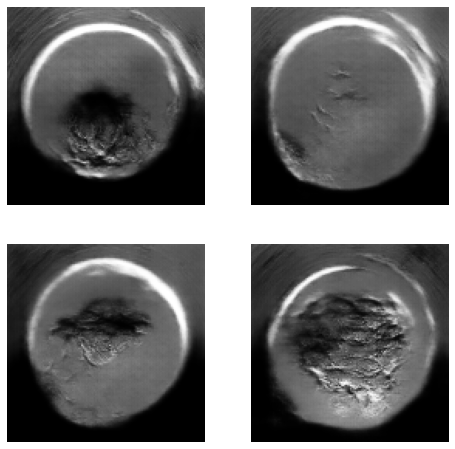

47/47 [==============================] - 26s 524ms/step - d_loss: -383.0133 - g_loss: -2372.0824
Epoch 186/250
47/47 [==============================] - ETA: 0s - d_loss: -370.5424 - g_loss: -1851.0301

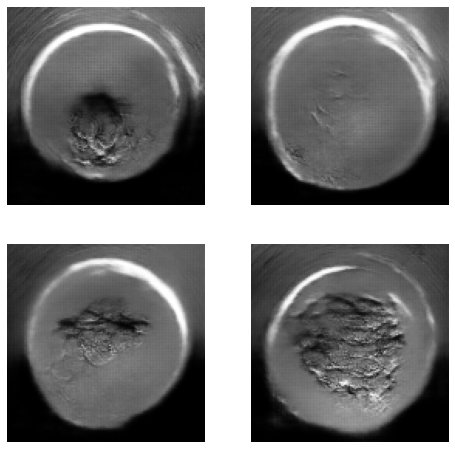

47/47 [==============================] - 26s 531ms/step - d_loss: -370.5850 - g_loss: -1854.6550
Epoch 187/250
47/47 [==============================] - ETA: 0s - d_loss: -361.0135 - g_loss: -2057.5330

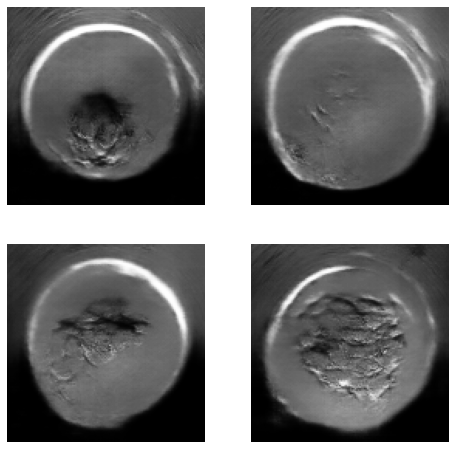

47/47 [==============================] - 26s 542ms/step - d_loss: -360.6298 - g_loss: -2062.5124
Epoch 188/250
47/47 [==============================] - ETA: 0s - d_loss: -313.7141 - g_loss: -2084.2499

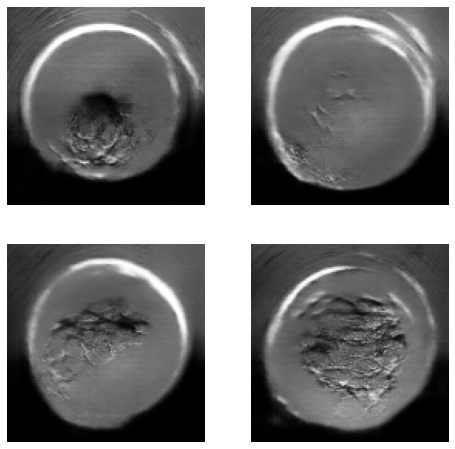

47/47 [==============================] - 26s 526ms/step - d_loss: -323.6766 - g_loss: -2079.2736
Epoch 189/250
47/47 [==============================] - ETA: 0s - d_loss: -338.4521 - g_loss: -1778.4413

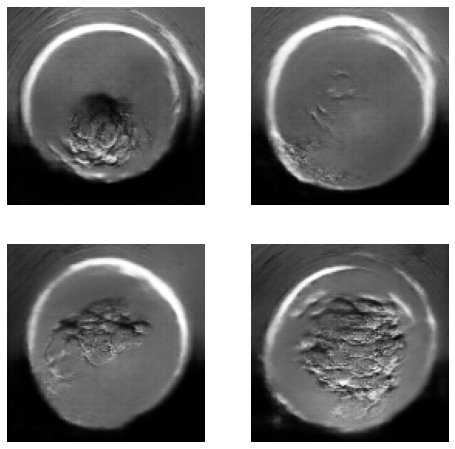

47/47 [==============================] - 25s 526ms/step - d_loss: -349.6882 - g_loss: -1757.3081
Epoch 190/250
47/47 [==============================] - ETA: 0s - d_loss: -327.6447 - g_loss: -2521.7615

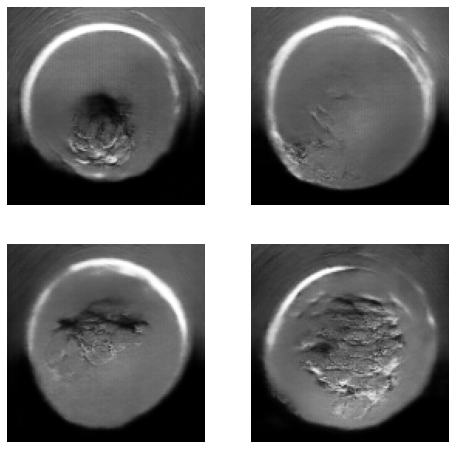

47/47 [==============================] - 27s 549ms/step - d_loss: -328.9275 - g_loss: -2551.3525
Epoch 191/250
47/47 [==============================] - ETA: 0s - d_loss: -293.8984 - g_loss: -2262.5081

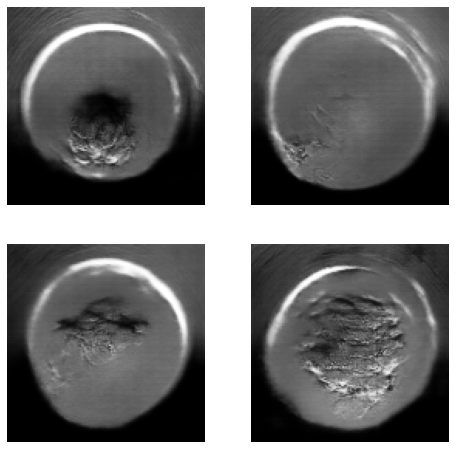

47/47 [==============================] - 26s 530ms/step - d_loss: -293.4016 - g_loss: -2307.7796
Epoch 192/250
47/47 [==============================] - ETA: 0s - d_loss: -298.7398 - g_loss: -1949.4365

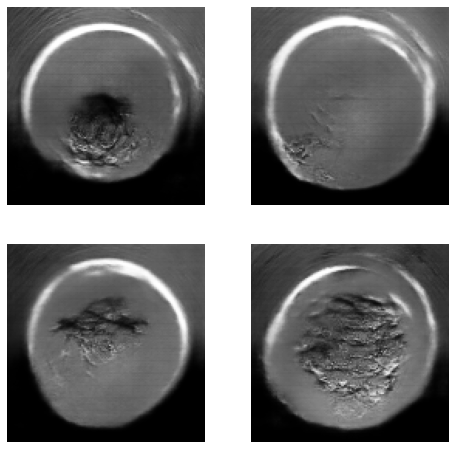

47/47 [==============================] - 26s 529ms/step - d_loss: -298.4557 - g_loss: -1982.4660
Epoch 193/250
47/47 [==============================] - ETA: 0s - d_loss: -299.1063 - g_loss: -1901.5199

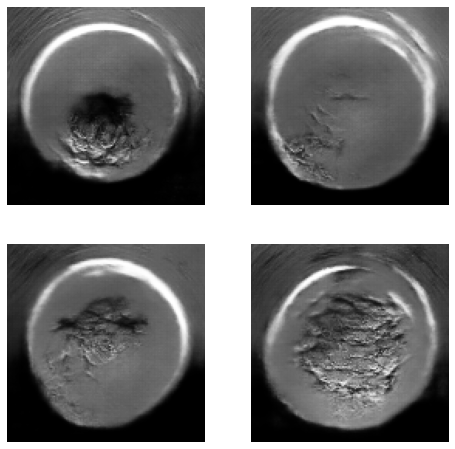

47/47 [==============================] - 26s 543ms/step - d_loss: -304.3705 - g_loss: -1896.6303
Epoch 194/250
47/47 [==============================] - ETA: 0s - d_loss: -328.0571 - g_loss: -1985.3455

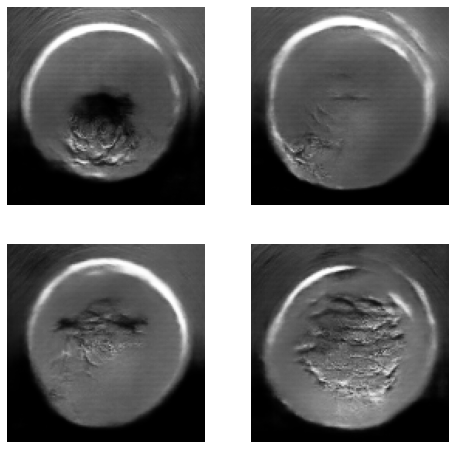

47/47 [==============================] - 26s 533ms/step - d_loss: -322.5180 - g_loss: -1991.8936
Epoch 195/250
47/47 [==============================] - ETA: 0s - d_loss: -331.7858 - g_loss: -1853.0208

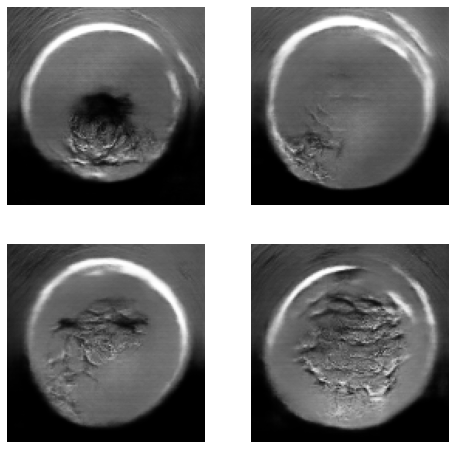

47/47 [==============================] - 26s 525ms/step - d_loss: -341.4362 - g_loss: -1891.4025
Epoch 196/250
47/47 [==============================] - ETA: 0s - d_loss: -304.4363 - g_loss: -1641.1251

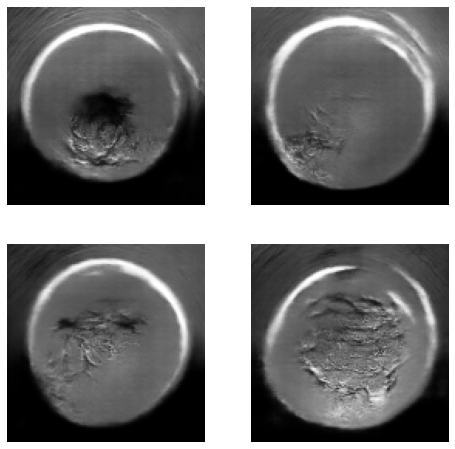

47/47 [==============================] - 26s 530ms/step - d_loss: -311.2823 - g_loss: -1653.5932
Epoch 197/250
47/47 [==============================] - ETA: 0s - d_loss: -331.0117 - g_loss: -1892.7106

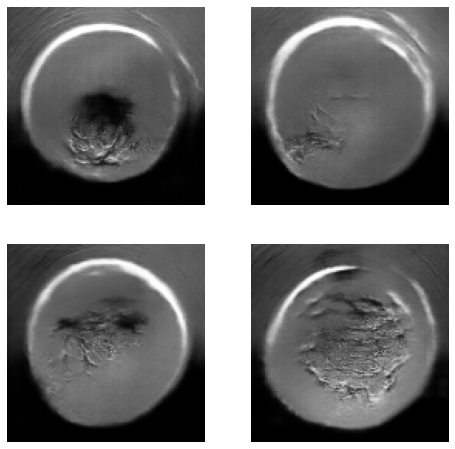

47/47 [==============================] - 26s 532ms/step - d_loss: -329.2865 - g_loss: -1924.5272
Epoch 198/250
47/47 [==============================] - ETA: 0s - d_loss: -309.9734 - g_loss: -2025.1716

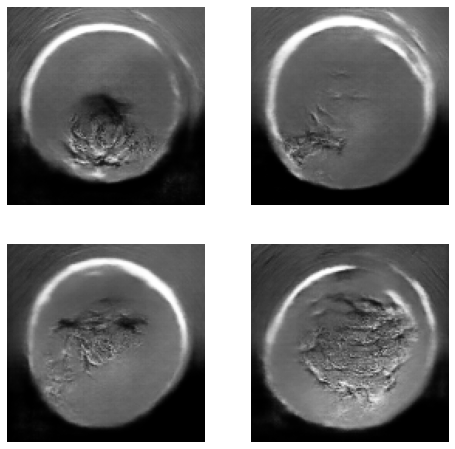

47/47 [==============================] - 26s 544ms/step - d_loss: -313.5677 - g_loss: -2029.4879
Epoch 199/250
47/47 [==============================] - ETA: 0s - d_loss: -304.6707 - g_loss: -2082.7787

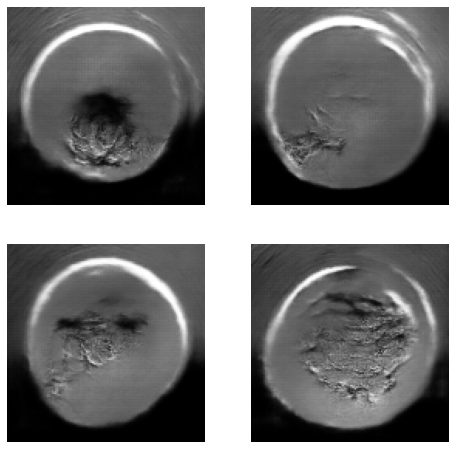

47/47 [==============================] - 26s 526ms/step - d_loss: -310.0748 - g_loss: -2075.2419
Epoch 200/250
47/47 [==============================] - ETA: 0s - d_loss: -328.5966 - g_loss: -2220.6379

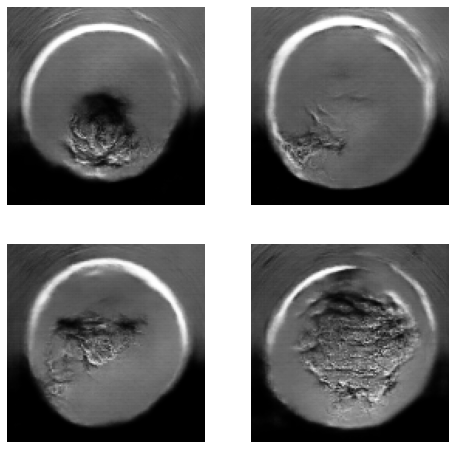

47/47 [==============================] - 26s 526ms/step - d_loss: -333.6034 - g_loss: -2235.1241
Epoch 201/250
47/47 [==============================] - ETA: 0s - d_loss: -311.0800 - g_loss: -2733.8643

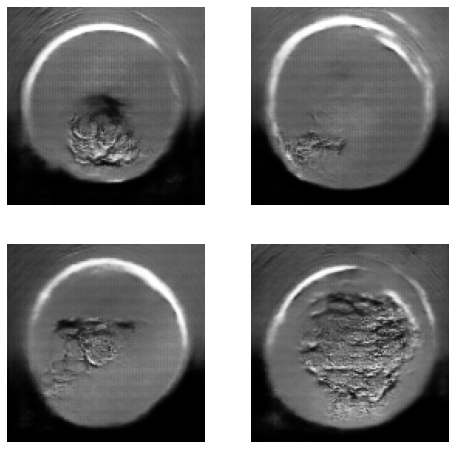

47/47 [==============================] - 27s 545ms/step - d_loss: -317.8357 - g_loss: -2635.7379
Epoch 202/250
47/47 [==============================] - ETA: 0s - d_loss: -373.3866 - g_loss: -2878.3190

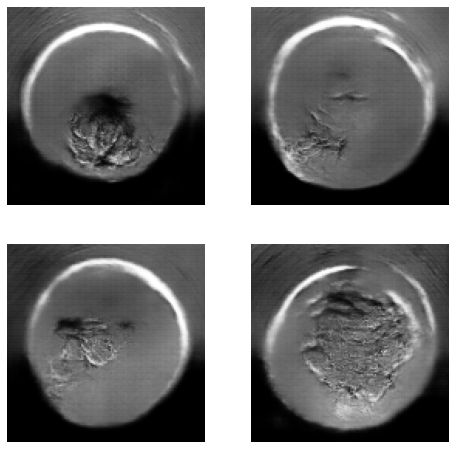

47/47 [==============================] - 25s 525ms/step - d_loss: -375.0316 - g_loss: -2831.4777
Epoch 203/250
47/47 [==============================] - ETA: 0s - d_loss: -338.1814 - g_loss: -2667.9935

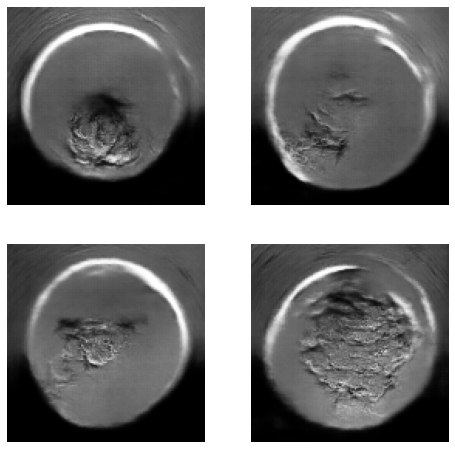

47/47 [==============================] - 27s 552ms/step - d_loss: -353.3512 - g_loss: -2638.0963
Epoch 204/250
47/47 [==============================] - ETA: 0s - d_loss: -319.8621 - g_loss: -2192.4390

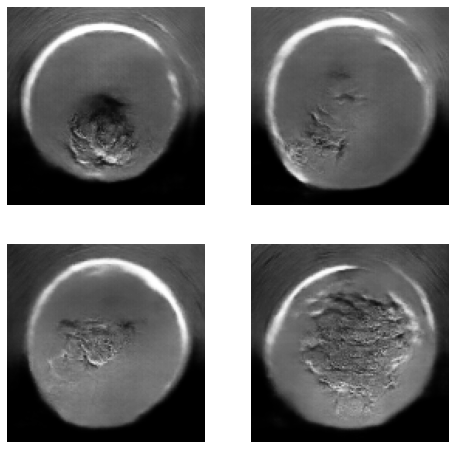

47/47 [==============================] - 26s 529ms/step - d_loss: -324.0906 - g_loss: -2152.8125
Epoch 205/250
47/47 [==============================] - ETA: 0s - d_loss: -336.2750 - g_loss: -1820.1151

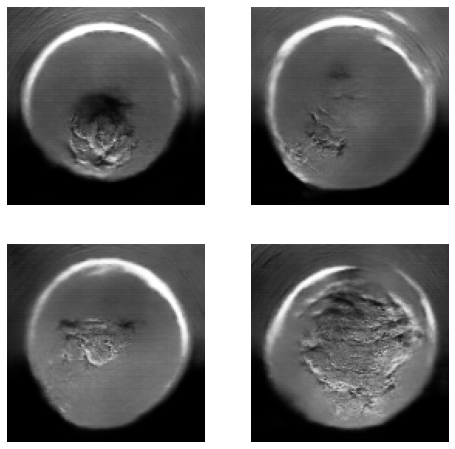

47/47 [==============================] - 26s 541ms/step - d_loss: -343.7740 - g_loss: -1879.1014
Epoch 206/250
47/47 [==============================] - ETA: 0s - d_loss: -329.0550 - g_loss: -2237.4676

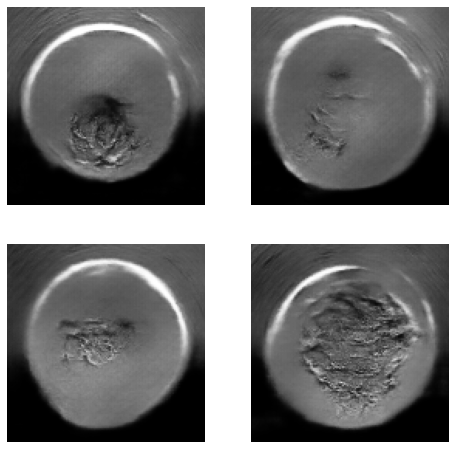

47/47 [==============================] - 26s 534ms/step - d_loss: -331.8526 - g_loss: -2231.6987
Epoch 207/250
47/47 [==============================] - ETA: 0s - d_loss: -308.9422 - g_loss: -2047.2887

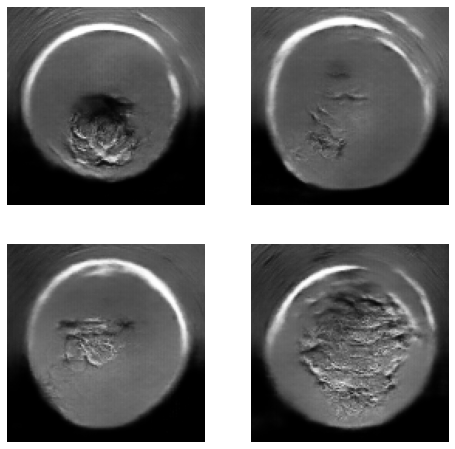

47/47 [==============================] - 25s 525ms/step - d_loss: -317.5331 - g_loss: -2069.3269
Epoch 208/250
47/47 [==============================] - ETA: 0s - d_loss: -351.2853 - g_loss: -2401.9143

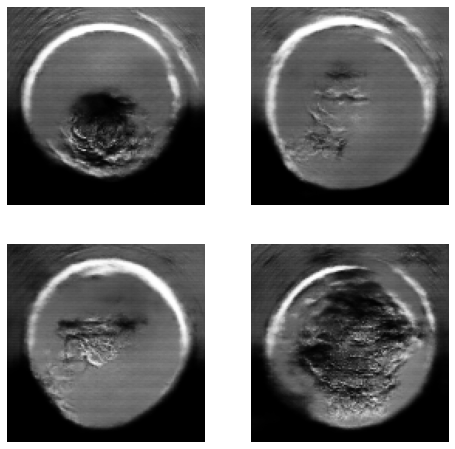

47/47 [==============================] - 26s 546ms/step - d_loss: -354.0440 - g_loss: -2474.1742
Epoch 209/250
47/47 [==============================] - ETA: 0s - d_loss: -337.5244 - g_loss: -2674.3231

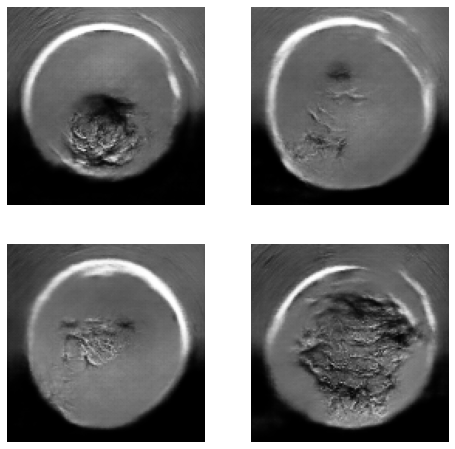

47/47 [==============================] - 26s 534ms/step - d_loss: -334.5600 - g_loss: -2650.3513
Epoch 210/250
47/47 [==============================] - ETA: 0s - d_loss: -305.0275 - g_loss: -2515.3779

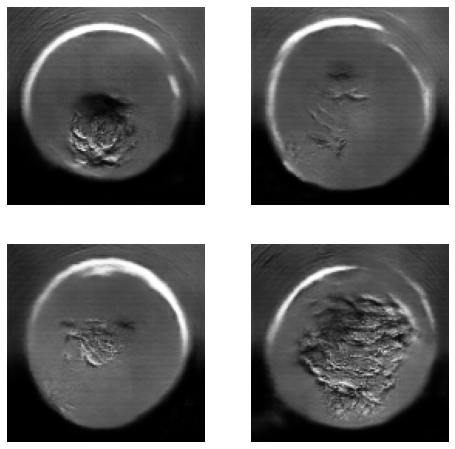

47/47 [==============================] - 26s 527ms/step - d_loss: -307.6625 - g_loss: -2507.4593
Epoch 211/250
47/47 [==============================] - ETA: 0s - d_loss: -308.0574 - g_loss: -2447.9326

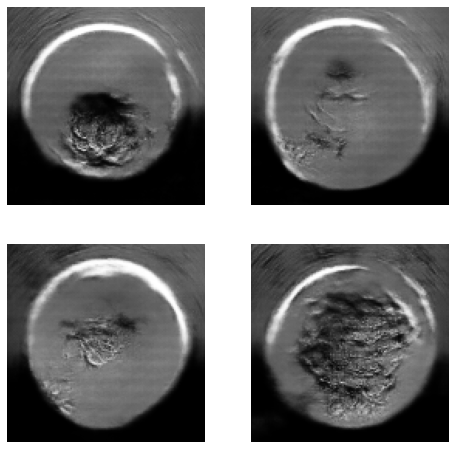

47/47 [==============================] - 26s 532ms/step - d_loss: -306.8182 - g_loss: -2437.3044
Epoch 212/250
47/47 [==============================] - ETA: 0s - d_loss: -416.6501 - g_loss: -2324.1368

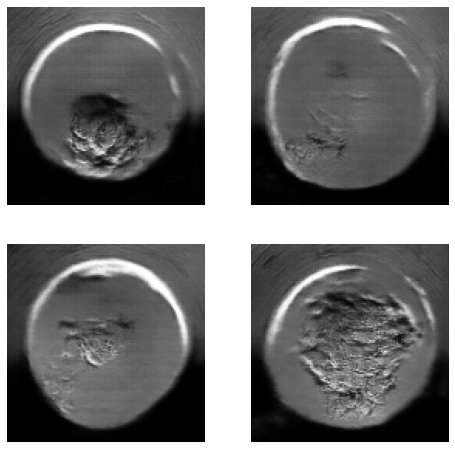

47/47 [==============================] - 26s 542ms/step - d_loss: -414.7874 - g_loss: -2268.5300
Epoch 213/250
47/47 [==============================] - ETA: 0s - d_loss: -360.5173 - g_loss: -1845.6882

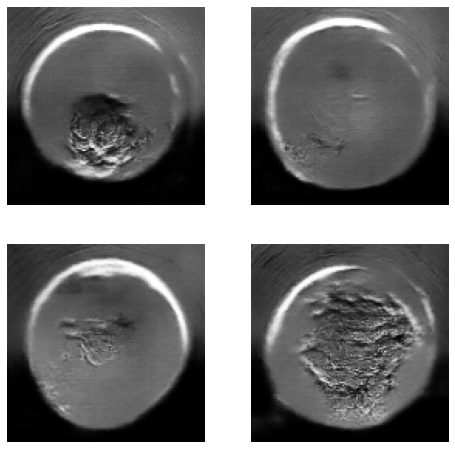

47/47 [==============================] - 26s 526ms/step - d_loss: -364.1230 - g_loss: -1800.5806
Epoch 214/250
47/47 [==============================] - ETA: 0s - d_loss: -315.5723 - g_loss: -2102.4787

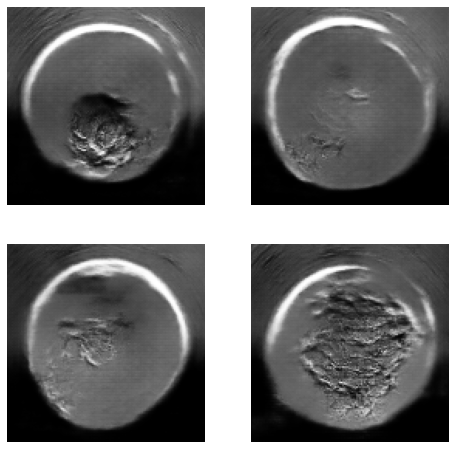

47/47 [==============================] - 25s 526ms/step - d_loss: -317.0299 - g_loss: -2085.1434
Epoch 215/250
47/47 [==============================] - ETA: 0s - d_loss: -347.9164 - g_loss: -2298.3537

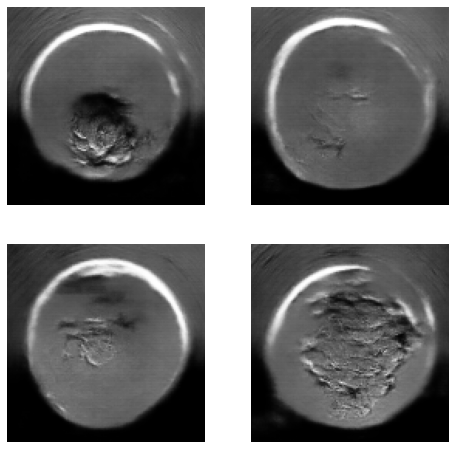

47/47 [==============================] - 26s 542ms/step - d_loss: -359.2117 - g_loss: -2255.5383
Epoch 216/250
47/47 [==============================] - ETA: 0s - d_loss: -344.2863 - g_loss: -2417.5435

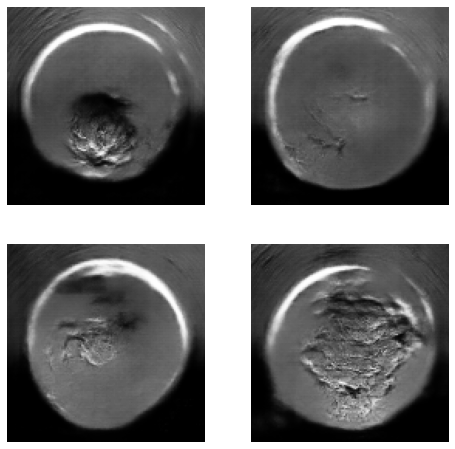

47/47 [==============================] - 26s 539ms/step - d_loss: -354.1035 - g_loss: -2476.6359
Epoch 217/250
47/47 [==============================] - ETA: 0s - d_loss: -289.3674 - g_loss: -3247.8856

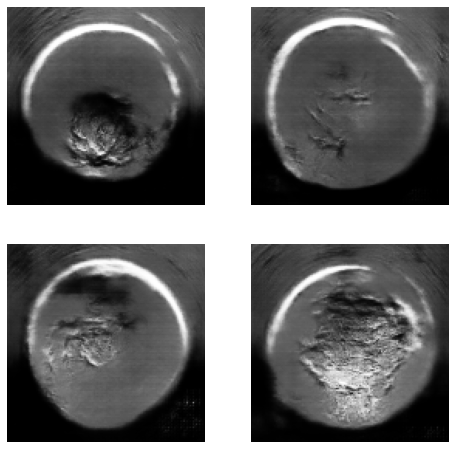

47/47 [==============================] - 26s 538ms/step - d_loss: -295.9869 - g_loss: -3259.6527
Epoch 218/250
47/47 [==============================] - ETA: 0s - d_loss: -318.7409 - g_loss: -2901.9401

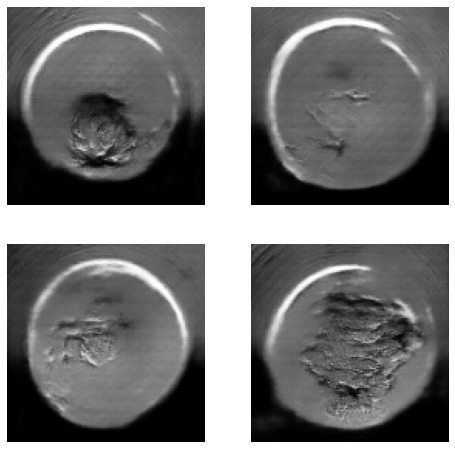

47/47 [==============================] - 26s 526ms/step - d_loss: -328.1298 - g_loss: -2923.3495
Epoch 219/250
47/47 [==============================] - ETA: 0s - d_loss: -297.2979 - g_loss: -1983.3926

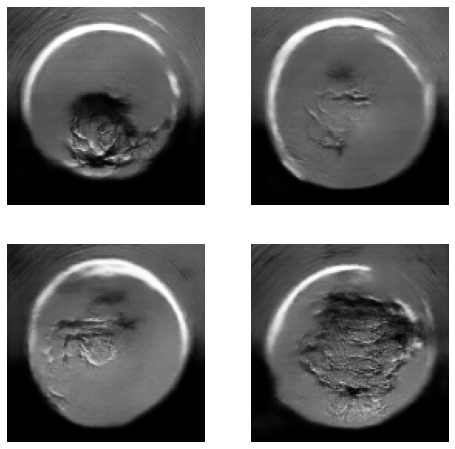

47/47 [==============================] - 27s 546ms/step - d_loss: -300.3766 - g_loss: -1998.4234
Epoch 220/250
47/47 [==============================] - ETA: 0s - d_loss: -269.9233 - g_loss: -1640.4587

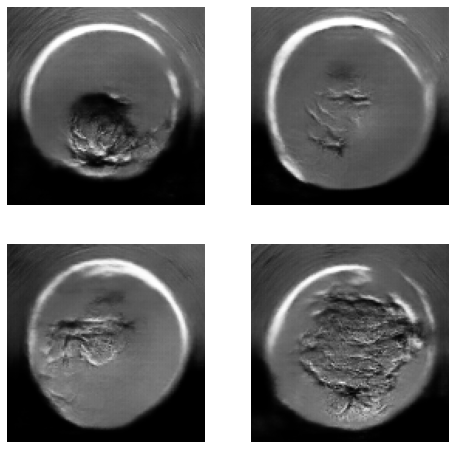

47/47 [==============================] - 26s 529ms/step - d_loss: -272.9747 - g_loss: -1626.3167
Epoch 221/250
47/47 [==============================] - ETA: 0s - d_loss: -320.0100 - g_loss: -2116.8623

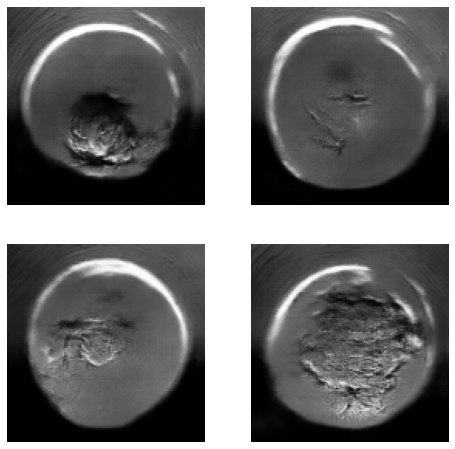

47/47 [==============================] - 26s 542ms/step - d_loss: -319.9914 - g_loss: -2181.7169
Epoch 222/250
47/47 [==============================] - ETA: 0s - d_loss: -313.1378 - g_loss: -2181.7929

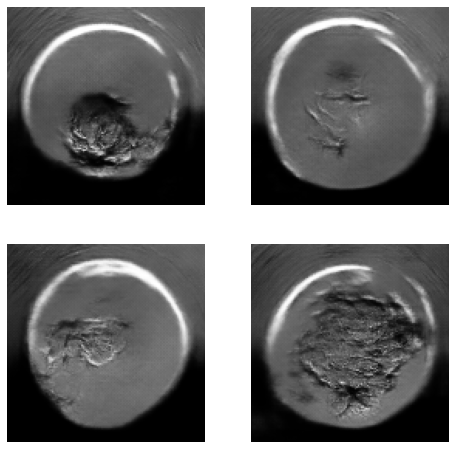

47/47 [==============================] - 26s 532ms/step - d_loss: -315.3086 - g_loss: -2159.4512
Epoch 223/250
47/47 [==============================] - ETA: 0s - d_loss: -302.6867 - g_loss: -1996.3853

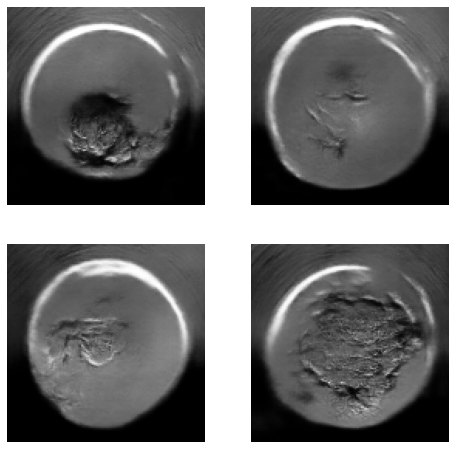

47/47 [==============================] - 26s 535ms/step - d_loss: -303.1165 - g_loss: -1974.2370
Epoch 224/250
47/47 [==============================] - ETA: 0s - d_loss: -305.1714 - g_loss: -1938.0249

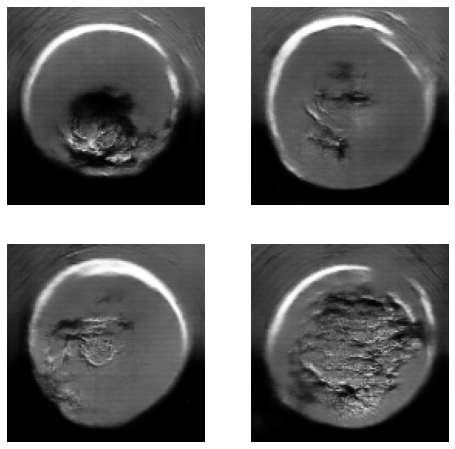

47/47 [==============================] - 26s 535ms/step - d_loss: -311.1077 - g_loss: -1981.3407
Epoch 225/250
47/47 [==============================] - ETA: 0s - d_loss: -312.4418 - g_loss: -2080.8460

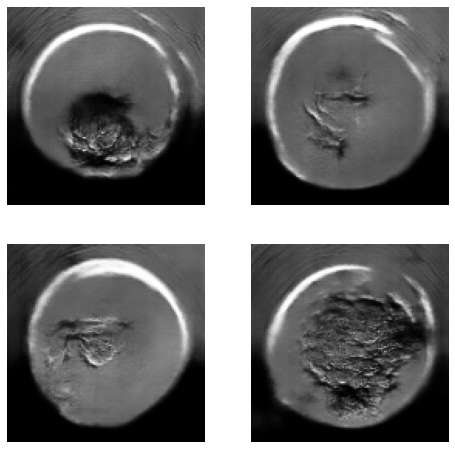

47/47 [==============================] - 26s 535ms/step - d_loss: -326.1647 - g_loss: -2074.9384
Epoch 226/250
47/47 [==============================] - ETA: 0s - d_loss: -301.4115 - g_loss: -2292.7044

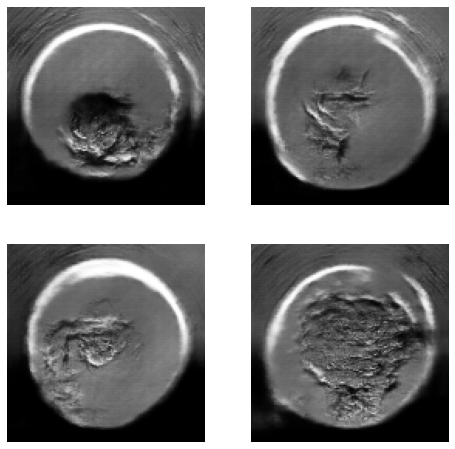

47/47 [==============================] - 26s 526ms/step - d_loss: -304.4200 - g_loss: -2359.8025
Epoch 227/250
47/47 [==============================] - ETA: 0s - d_loss: -311.9982 - g_loss: -2113.9856

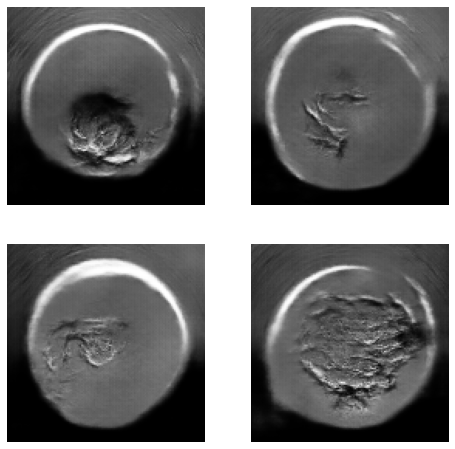

47/47 [==============================] - 26s 533ms/step - d_loss: -320.7712 - g_loss: -2078.6194
Epoch 228/250
47/47 [==============================] - ETA: 0s - d_loss: -299.6633 - g_loss: -2099.8822

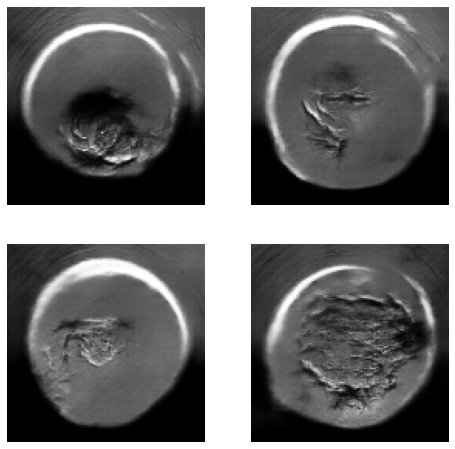

47/47 [==============================] - 26s 540ms/step - d_loss: -302.4756 - g_loss: -2150.9614
Epoch 229/250
47/47 [==============================] - ETA: 0s - d_loss: -296.9361 - g_loss: -1998.5323

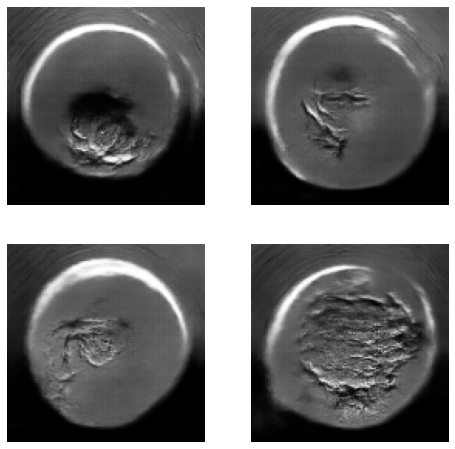

47/47 [==============================] - 26s 533ms/step - d_loss: -303.9129 - g_loss: -2021.2868
Epoch 230/250
47/47 [==============================] - ETA: 0s - d_loss: -298.9216 - g_loss: -2748.0897

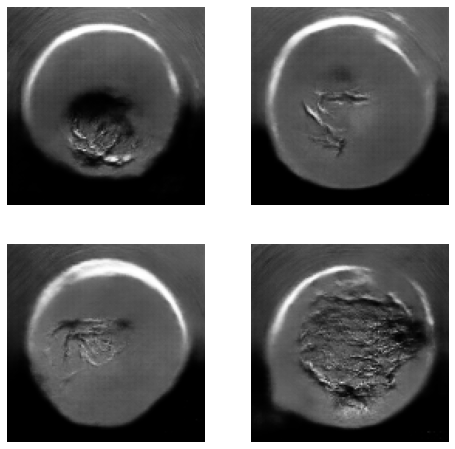

47/47 [==============================] - 26s 526ms/step - d_loss: -309.5831 - g_loss: -2712.3561
Epoch 231/250
47/47 [==============================] - ETA: 0s - d_loss: -323.1273 - g_loss: -2161.7947

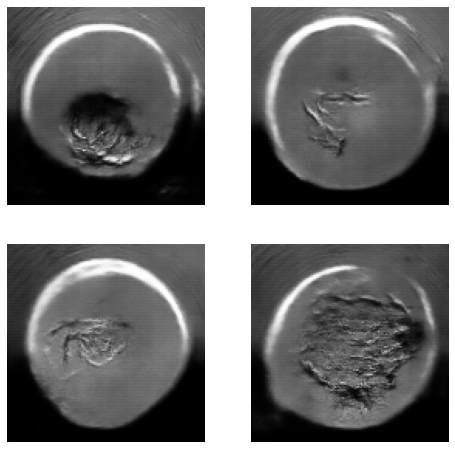

47/47 [==============================] - 26s 543ms/step - d_loss: -329.2358 - g_loss: -2224.0066
Epoch 232/250
47/47 [==============================] - ETA: 0s - d_loss: -313.7934 - g_loss: -2840.8803

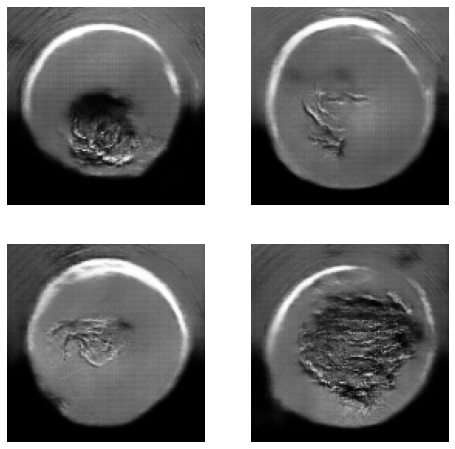

47/47 [==============================] - 26s 527ms/step - d_loss: -325.9002 - g_loss: -2904.3465
Epoch 233/250
47/47 [==============================] - ETA: 0s - d_loss: -331.3988 - g_loss: -2740.0707

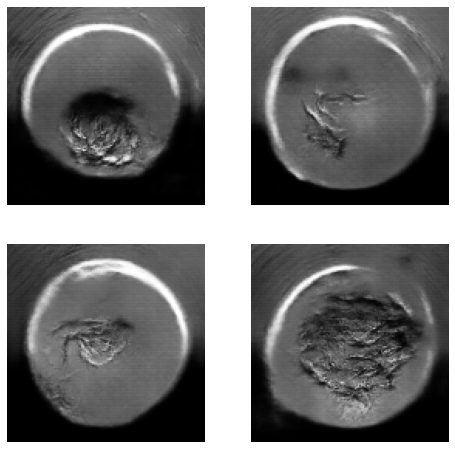

47/47 [==============================] - 26s 528ms/step - d_loss: -332.3902 - g_loss: -2743.7682
Epoch 234/250
47/47 [==============================] - ETA: 0s - d_loss: -273.5499 - g_loss: -2461.5128

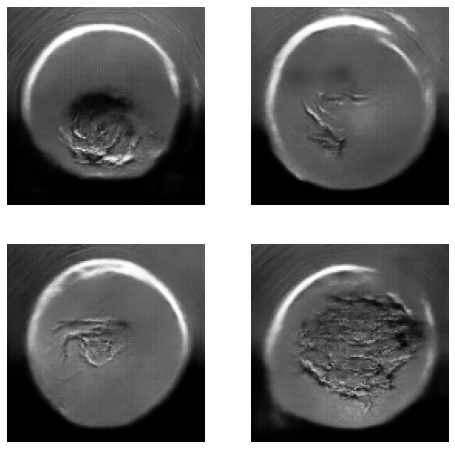

47/47 [==============================] - 26s 532ms/step - d_loss: -278.0500 - g_loss: -2404.0454
Epoch 235/250
47/47 [==============================] - ETA: 0s - d_loss: -299.5078 - g_loss: -1894.3645

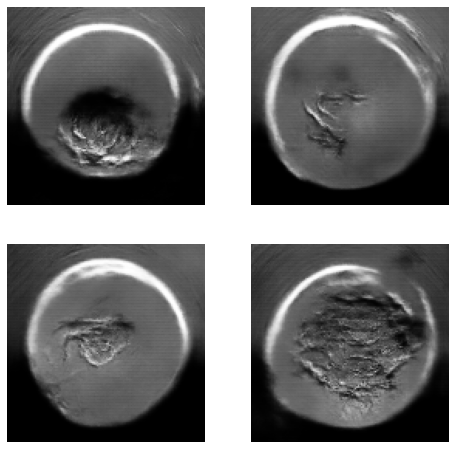

47/47 [==============================] - 26s 532ms/step - d_loss: -302.1640 - g_loss: -1922.8974
Epoch 236/250
47/47 [==============================] - ETA: 0s - d_loss: -286.2536 - g_loss: -2321.1755

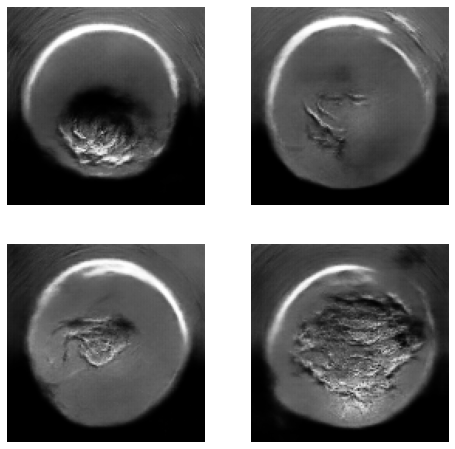

47/47 [==============================] - 26s 540ms/step - d_loss: -284.1578 - g_loss: -2343.9982
Epoch 237/250
47/47 [==============================] - ETA: 0s - d_loss: -313.6240 - g_loss: -1796.9342

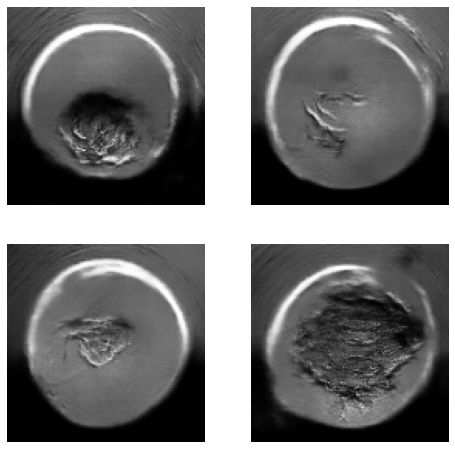

47/47 [==============================] - 26s 526ms/step - d_loss: -319.8589 - g_loss: -1823.7291
Epoch 238/250
47/47 [==============================] - ETA: 0s - d_loss: -332.1797 - g_loss: -2118.3525

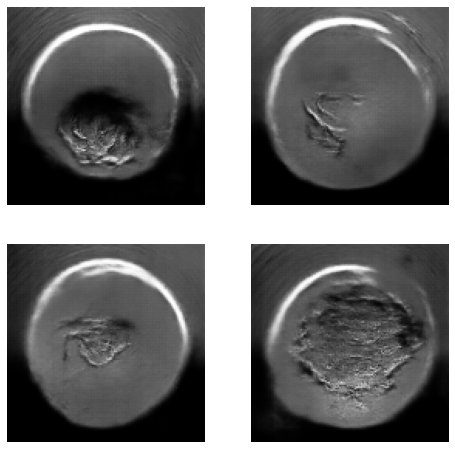

47/47 [==============================] - 26s 545ms/step - d_loss: -333.5210 - g_loss: -2109.0020
Epoch 239/250
47/47 [==============================] - ETA: 0s - d_loss: -280.5203 - g_loss: -1695.9232

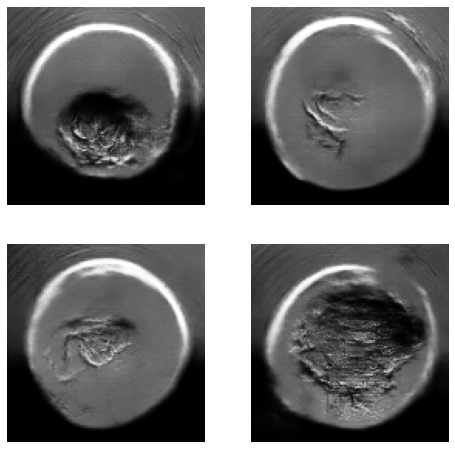

47/47 [==============================] - 25s 525ms/step - d_loss: -285.9950 - g_loss: -1694.6516
Epoch 240/250
47/47 [==============================] - ETA: 0s - d_loss: -289.0163 - g_loss: -1809.6503

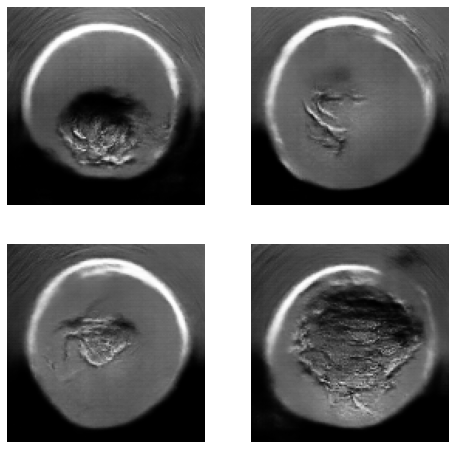

47/47 [==============================] - 26s 545ms/step - d_loss: -293.9678 - g_loss: -1773.8640
Epoch 241/250
47/47 [==============================] - ETA: 0s - d_loss: -331.7938 - g_loss: -1933.3055

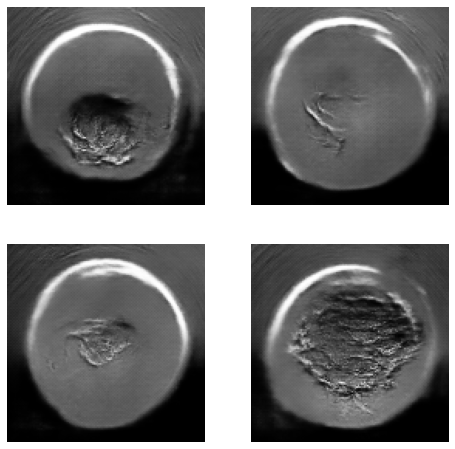

47/47 [==============================] - 26s 533ms/step - d_loss: -330.4732 - g_loss: -1943.7876
Epoch 242/250
47/47 [==============================] - ETA: 0s - d_loss: -308.1301 - g_loss: -1988.2664

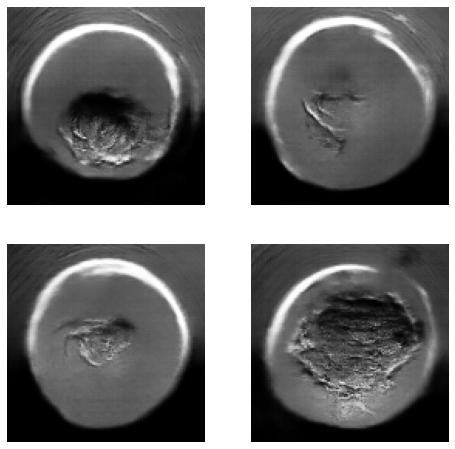

47/47 [==============================] - 26s 531ms/step - d_loss: -313.7511 - g_loss: -2030.9100
Epoch 243/250
47/47 [==============================] - ETA: 0s - d_loss: -295.8146 - g_loss: -2060.7629

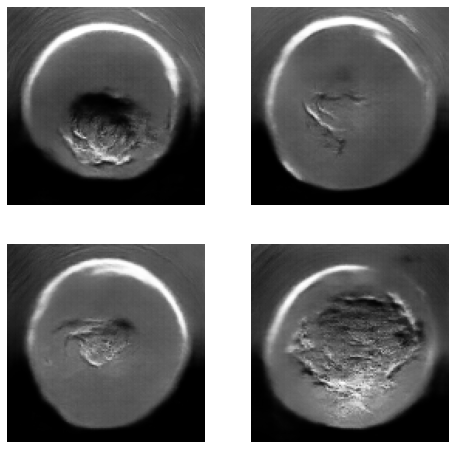

47/47 [==============================] - 26s 531ms/step - d_loss: -299.3762 - g_loss: -2119.4373
Epoch 244/250
47/47 [==============================] - ETA: 0s - d_loss: -267.3021 - g_loss: -2057.7541

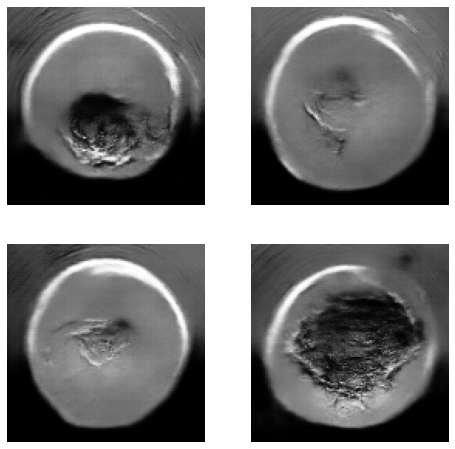

47/47 [==============================] - 26s 535ms/step - d_loss: -263.4243 - g_loss: -2117.4211
Epoch 245/250
47/47 [==============================] - ETA: 0s - d_loss: -322.8236 - g_loss: -3139.7054

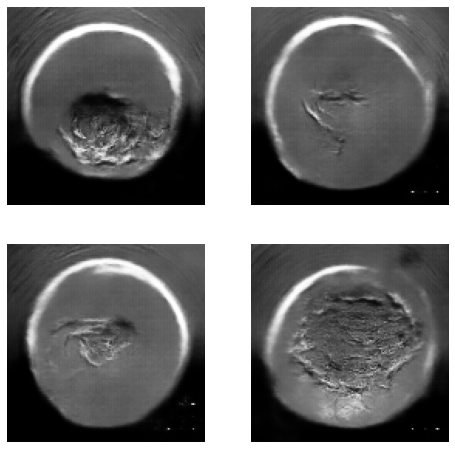

47/47 [==============================] - 26s 527ms/step - d_loss: -317.6709 - g_loss: -3111.8661
Epoch 246/250
47/47 [==============================] - ETA: 0s - d_loss: -333.1044 - g_loss: -2071.4301

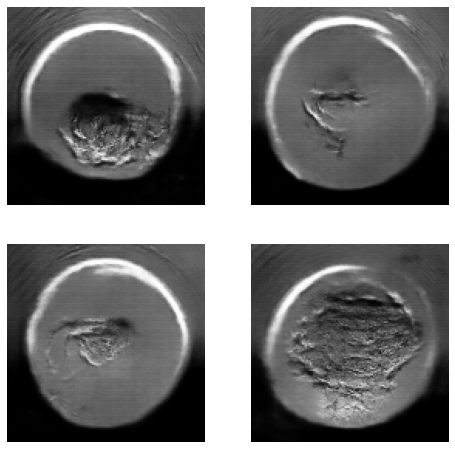

47/47 [==============================] - 26s 543ms/step - d_loss: -353.0551 - g_loss: -1998.9865
Epoch 247/250
47/47 [==============================] - ETA: 0s - d_loss: -303.2846 - g_loss: -2349.7738

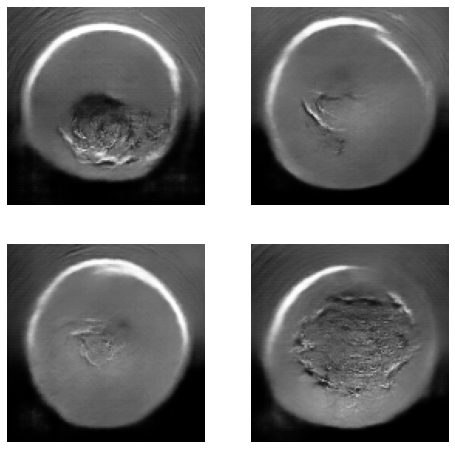

47/47 [==============================] - 25s 525ms/step - d_loss: -302.2773 - g_loss: -2369.0863
Epoch 248/250
47/47 [==============================] - ETA: 0s - d_loss: -346.1872 - g_loss: -1810.0053

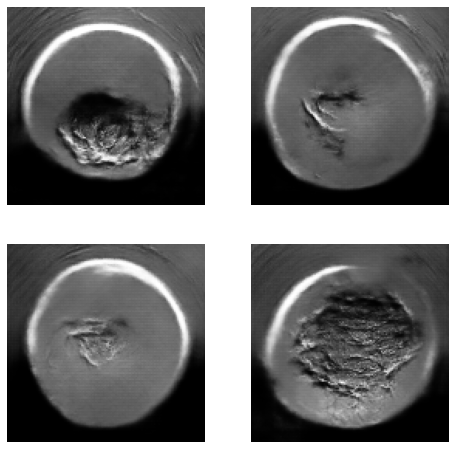

47/47 [==============================] - 26s 543ms/step - d_loss: -345.9341 - g_loss: -1776.9627
Epoch 249/250
47/47 [==============================] - ETA: 0s - d_loss: -316.4982 - g_loss: -2117.9922

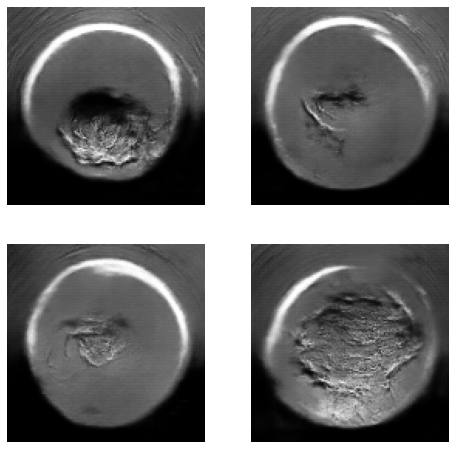

47/47 [==============================] - 26s 531ms/step - d_loss: -331.5053 - g_loss: -2061.9845
Epoch 250/250
47/47 [==============================] - ETA: 0s - d_loss: -356.3385 - g_loss: -1980.3528

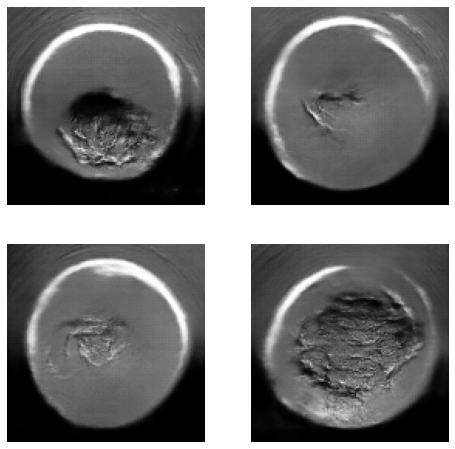

47/47 [==============================] - 25s 526ms/step - d_loss: -368.6463 - g_loss: -1945.1615


In [ ]:
epochs = 250

# callback
cbk = GANMonitor(num_img=4, latent_dim=latent_dim)

wgan = WGAN(discriminator,
			      generator,
            latent_dim=latent_dim,
            discriminator_extra_steps=3)

wgan.compile(d_optimizer=discriminator_optimizer,
             g_optimizer=generator_optimizer,
             g_loss_fn=generator_loss,
             d_loss_fn=discriminator_loss)

history = wgan.fit(dataset, batch_size=BATCH_SIZE, epochs=epochs, callbacks=[cbk])

# Generating Images using WGAN Model

In [ ]:
def generate(num_of_imgs=1):
  seed = tf.random.normal([num_of_imgs, latent_dim])
  generated_images = wgan.generator(seed)
  generated_images = (generated_images * 127.5) + 127.5
  
  rows = 1

  if num_of_imgs < 3: rows = 1
  elif num_of_imgs % 3 == 0: rows = (num_of_imgs//3)
  else: rows = num_of_imgs-3*(num_of_imgs//3)+(num_of_imgs%3)
  
  plt.figure(figsize=(24, rows * 8))
  for i in range(num_of_imgs):
    plt.subplot(rows, 3, i+1)
    plt.imshow(generated_images[i, :, :, 0], cmap='gray')
    plt.axis('off')
  plt.show()

Images generated are of low resolution because I resized the input images to 128x128 from the original 500x500 for faster training as I have access to limited resources

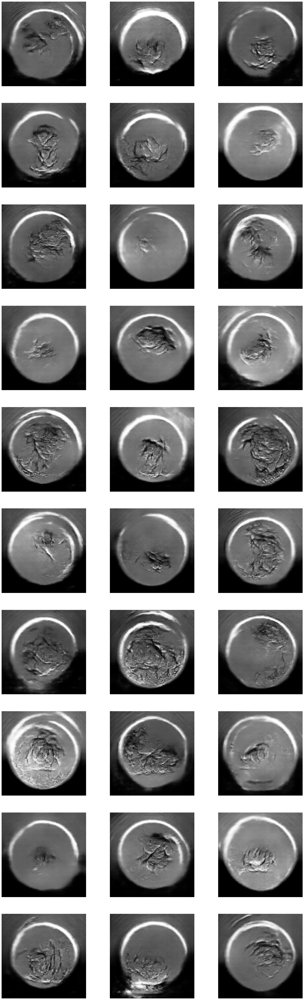

In [ ]:
num_of_imgs = 30
generate(num_of_imgs)